In [1]:
%matplotlib inline

import pickle
import matplotlib.pyplot as plt
from matplotlib import colors
from mpl_toolkits.mplot3d import Axes3D
from functools import reduce
import numpy as np
import pandas as pd
import ipdb
import copy
plt.rcParams['figure.dpi'] = 150

In [2]:
from scipy.stats import ks_2samp
import statsmodels

In [3]:
_, b = ks_2samp(np.random.rand(30), np.random.rand(50))
print(b)

0.8272649885210076


In [4]:
def ks_test_of_consecutive_2_states(p2AUC_dict, TF_of_interest):
# def get_hist_mat_dict(p2AUC_dict, num_TF = 200):
    with open(p2AUC_dict, 'rb') as f:
        AUC_dict = pickle.load(f)
    AUC_dict = separate_state(AUC_dict)
    num_states = len(AUC_dict)
    p_val_list = []
    for idx in range(num_states - 1):
        cur_state_AUC = AUC_dict[idx][TF_of_interest].values
        nxt_state_AUC = AUC_dict[idx + 1][TF_of_interest].values
        _, p_val = ks_2samp(cur_state_AUC, nxt_state_AUC)
        p_val_list.append(p_val)
    return p_val_list

In [8]:
p2AUC_dict_simic = '/data/jianhao/hepatocyte_update_dataset_101619/AUC_dict_monoc_3groups_1118'
p2AUC_dict_no_simic = '/data/jianhao/hepatocyte_update_dataset_101619/AUC_dict_simple_state_1130_no_simic'

In [9]:
p2assignment = '/data/jianhao/hepatocyte_update_dataset_101619/monoc_simple_group_assign'
assign_list = []
with open(p2assignment, 'r') as f:
    for line in f:
        assign_list.append(int(line))
print(len(assign_list))
print(set(assign_list))

18272
{0, 1, 2}


------
# Compute histogram of AUC for all TFs

In [10]:
def separate_state(AUC_dict):
    for state in AUC_dict.keys():
        tmp_AUC = AUC_dict[state]
        tmp_AUC = tmp_AUC.iloc[[idx for idx, label in enumerate(assign_list) if label == state]]
        AUC_dict[state] = tmp_AUC
    return AUC_dict

In [11]:
def compute_hist(AUC_dict, num_TF = 200):
    x_min = np.ones(num_TF)
    x_max = -1 * np.ones(num_TF)
    # find min and max of AUC values in all states.
    for label in AUC_dict:
        min_AUC = AUC_dict[label].min(axis = 0)
        max_AUC = AUC_dict[label].max(axis = 0)
        x_min = np.minimum(min_AUC, x_min)
        x_max = np.maximum(max_AUC, x_max)

    i = 5
    TF_hist_dict = {}
    for idx, TF in enumerate(AUC_dict[1].columns):    
    #     i -= 1
        cap_TF = TF.capitalize()
        TF_hist_dict[cap_TF] = {}
        nbins = 50
        bar_width =  (-x_min[idx] + x_max[idx]) / nbins
        bin_list = np.arange(x_min[idx], x_max[idx] + bar_width, bar_width)


        label_order = sorted(list(AUC_dict.keys()))

        for label in label_order:
            AUC_df = AUC_dict[label]      
            y = AUC_df[TF].values.tolist()

            hist, _ = np.histogram(y, bins = bin_list,
                                  weights=np.ones(len(y)) / len(y))

            xs = (bin_list[:-1] + bin_list[1:])/2
            legend_name = 'state {}'.format(label)

            TF_hist_dict[cap_TF][label] = {
                'hist': hist,
                'xs': xs
            }
        if i < 0:
            break
    return TF_hist_dict

def compute_hist_mat(TF_hist_dict):
    TF_hist_mat_dict = {}
    num_of_TF = len(TF_hist_dict)
    for TF in TF_hist_dict:
        num_of_bins = len(TF_hist_dict[TF][1]['hist'])
        num_of_labels = len(TF_hist_dict[TF])
        tmp_hist_mat = np.zeros((num_of_labels, num_of_bins))
        for row_idx, label in enumerate(TF_hist_dict[TF]):
            tmp_row = TF_hist_dict[TF][label]['hist']
            tmp_hist_mat[row_idx, :] = tmp_row
        TF_hist_mat_dict[TF] = tmp_hist_mat
    return TF_hist_mat_dict
        
def get_hist_mat_dict(p2AUC_dict, num_TF = 200):
    with open(p2AUC_dict, 'rb') as f:
        AUC_dict = pickle.load(f)
    AUC_dict = separate_state(AUC_dict)
    TF_hist_dict = compute_hist(AUC_dict, num_TF)
    TF_hist_mat_dict = compute_hist_mat(TF_hist_dict)
    return TF_hist_mat_dict, TF_hist_dict

In [12]:
TF_hist_mat_dict_simic, TF_hist_dict_simic = get_hist_mat_dict(p2AUC_dict_simic)
TF_hist_mat_dict_no_simic, TF_hist_dict_no_simic = get_hist_mat_dict(p2AUC_dict_no_simic)
len(TF_hist_mat_dict_simic)

200

In [13]:
# TF_hist_dict_simic
# TF_hist_mat_dict_simic

------
# Compute the total variant of histograms

In [14]:
def total_variant(dist1, dist2):
    abs_diff = np.abs(np.array(dist1) - np.array(dist2))
    TV = 1/2 * np.sum(abs_diff)
    return TV

def aver_TV_of_hist(hist_mat):
    '''
    hist_mat: num_labels * len_of_hist
    '''
    num_labels, _ = hist_mat.shape
    count_of_TVs = num_labels * (num_labels - 1)
    sum_of_TVs = 0
    for row_idx in range(num_labels):
        remaining_rows = np.delete(np.arange(num_labels), row_idx)
        row_1 = hist_mat[row_idx, :]
        for row_2_idx in remaining_rows:
            row_2 = hist_mat[row_2_idx, :]
            sum_of_TVs += total_variant(row_1, row_2)
    average_TV = sum_of_TVs / count_of_TVs
    return average_TV
    
def list_of_TV_of_hist(hist_mat):
    '''
    hist_mat: num_labels * len_of_hist
    '''
    num_labels, _ = hist_mat.shape
    count_of_TVs = num_labels * (num_labels - 1)
    list_of_TVs = []
    for row_idx in range(num_labels):
        remaining_rows = range(row_idx + 1, num_labels)
        row_1 = hist_mat[row_idx, :]
        for row_2_idx in remaining_rows:
            row_2 = hist_mat[row_2_idx, :]
            tmp_TV = total_variant(row_1, row_2)
            list_of_TVs.append(tmp_TV)
    return list_of_TVs

def minmax_variant_of_hist(hist_mat):
    max_hist = np.max(hist_mat, axis = 0)
    min_hist = np.min(hist_mat, axis = 0)
    minmax_diff = max_hist - min_hist
    variant = np.sum(np.abs(minmax_diff)) / hist_mat.shape[0]
    
    return variant

In [15]:
def get_divergence_df(TF_hist_mat_dict):
    hist_divergence_df = pd.DataFrame(columns = TF_hist_mat_dict.keys(), 
                                      index = ['average TV', 'median TV', 'max TV', 'minmax variant'])
    for TF in TF_hist_mat_dict.keys():
        tmp_hist_mat = TF_hist_mat_dict[TF]
        tf_aver_TV = aver_TV_of_hist(tmp_hist_mat)
        hist_divergence_df[TF]['average TV'] = tf_aver_TV

        TV_list = list_of_TV_of_hist(tmp_hist_mat)

        tf_median_TV = np.median(TV_list)
        hist_divergence_df[TF]['median TV'] = tf_median_TV

        tf_max_TV = np.max(TV_list)
        hist_divergence_df[TF]['max TV'] = tf_max_TV

        tf_minmax_variant = minmax_variant_of_hist(tmp_hist_mat)
        hist_divergence_df[TF]['minmax variant'] = tf_minmax_variant
    return hist_divergence_df

def get_TF_list_intersection(hist_divergence_df, k):
    sorted_by_ave_hist_divergence_df = hist_divergence_df.sort_values(by = 'average TV', axis = 1, ascending = False)
    sorted_by_med_hist_divergence_df = hist_divergence_df.sort_values(by = 'median TV', axis = 1, ascending = False)
    sorted_by_max_hist_divergence_df = hist_divergence_df.sort_values(by = 'max TV', axis = 1, ascending = False)
    sorted_by_minmax_var_divergence_df = hist_divergence_df.sort_values(by = 'minmax variant', axis = 1, ascending = False)
        
    top_k_minmax_TF = sorted_by_minmax_var_divergence_df.columns.values[:k]
    last_k_minmax_TF = sorted_by_minmax_var_divergence_df.columns.values[-k:]

    top_k_max_TF = sorted_by_max_hist_divergence_df.columns.values[:k]
    last_k_max_TF = sorted_by_max_hist_divergence_df.columns.values[-k:]

    top_k_median_TF = sorted_by_med_hist_divergence_df.columns.values[:k]
    last_k_median_TF = sorted_by_med_hist_divergence_df.columns.values[-k:]

    top_k_average_TF = sorted_by_ave_hist_divergence_df.columns.values[:k]
    last_k_average_TF = sorted_by_ave_hist_divergence_df.columns.values[-k:]

    top_d = (top_k_minmax_TF, top_k_max_TF, top_k_median_TF, top_k_average_TF)
    top_variant_TF = set.intersection(*map(set,top_d))

    last_d = (last_k_minmax_TF, last_k_max_TF, last_k_median_TF, last_k_average_TF)
    last_variant_TF = set.intersection(*map(set, last_d))
    
    return top_variant_TF, last_variant_TF

------
# Get TF list

In [16]:
k = 50

diver_df_simic = get_divergence_df(TF_hist_mat_dict_simic)
top_TF_simic, last_TF_simic = get_TF_list_intersection(diver_df_simic, k)

diver_df_no_simic = get_divergence_df(TF_hist_mat_dict_no_simic)
top_TF_no_simic, last_TF_no_simic = get_TF_list_intersection(diver_df_no_simic, k)

# find the common and difference among sets.
common_top = top_TF_simic.intersection(top_TF_no_simic)
common_last = last_TF_simic.intersection(last_TF_no_simic)

top_only_simic = top_TF_simic.difference(common_top)
top_only_no_simic = top_TF_no_simic.difference(common_top)

last_only_simic = last_TF_simic.difference(common_last)
last_only_no_simic = last_TF_no_simic.difference(common_last)

top_simic_last_no_simic = top_TF_simic.intersection(last_TF_no_simic)
last_simic_top_no_simic = last_TF_simic.intersection(top_TF_no_simic)

print('common top in simic and no-simic: ', len(common_top))
print(common_top)
print('- ' * 7)

print('common last in simic and no-simic: ', len(common_last))
print(common_last)
print('- ' * 7)

print()
print('>>' * 7, 'simic', '>>' * 7)
print('top only in simic: ', len(top_only_simic))
print(top_only_simic)
print('- ' * 7)

print('last only in simic: ', len(last_only_simic))
print(last_only_simic)
print('- ' * 7)

print()
print('>>' * 7, 'no-simic', '>>' * 7)
print('top only in no-simic: ', len(top_only_no_simic))
print(top_only_no_simic)
print('- ' * 7)

print('last only in no-simic: ', len(last_only_no_simic))
print(last_only_no_simic)
print('- ' * 7)

print()
print('>>' * 7, 'contradicting cases', '>>' * 7)
print('top in simic, but last in no-simic: ', len(top_simic_last_no_simic))
print(top_simic_last_no_simic)
print('- ' * 7)

print('last in simic, but top in no-simic: ', len(last_simic_top_no_simic))
print(last_simic_top_no_simic)
print('- ' * 7)

common top in simic and no-simic:  22
{'Nr3c1', 'Prox1', 'Epas1', 'Tsc22d3', 'Ybx3', 'Pbrm1', 'Smarce1', 'Onecut2', 'Tcf25', 'Rxra', 'Tfdp2', 'Sfpq', 'Rora', 'Nr2f6', 'Junb', 'Stat1', 'Nfia', 'Nfic', 'Bcl3', 'Nr1i3', 'Tfam', 'Hes6'}
- - - - - - - 
common last in simic and no-simic:  5
{'Tshz1', 'Atf6', 'Atrx', 'Irf6', 'Elk4'}
- - - - - - - 

>>>>>>>>>>>>>> simic >>>>>>>>>>>>>>
top only in simic:  15
{'Ahr', 'Tsc22d1', 'Smarca5', 'Zfp91', 'Mier1', 'Foxp1', 'Nr0b2', 'Foxa3', 'Peg3', 'Nono', 'Klf15', 'Klf13', 'Nfib', 'Foxn3', 'Bhlhe40'}
- - - - - - - 
last only in simic:  23
{'Sox5', 'Rlf', 'Atf1', 'Cebpa', 'Kdm2a', 'Tox4', 'Nfkbia', 'Sox9', 'Cux1', 'Gzf1', 'Stat5b', 'Tef', 'Zbtb7b', 'Foxo3', 'Nfe2l1', 'Tfdp1', 'Sp3', 'Zhx1', 'Nr1d2', 'Nr2f2', 'Sall1', 'Onecut1', 'Klf12'}
- - - - - - - 

>>>>>>>>>>>>>> no-simic >>>>>>>>>>>>>>
top only in no-simic:  12
{'Id3', 'Tfdp1', 'Crem', 'Id1', 'Mlxipl', 'Id2', 'Nr1h3', 'Hif1a', 'Mlx', 'Klf9', 'Mafb', 'Nr1h4'}
- - - - - - - 
last only in no-simic:  2

In [64]:
diver_df_simic.iloc[:, :20]

,Ncoa2,Stat1,Lrrfip1,Hes6,Elk4,Nr5a2,Atf6,Nr1i3,Prox1,Irf6,Dnajc1,Rxra,Rc3h2,Sp3,Atf2,Nfe2l2,Ssrp1,Nr1h3,Mga,Foxa2
average TV,0.707367,0.817108,0.744288,0.898602,0.601641,0.778286,0.6709,0.882174,0.956944,0.597712,0.828008,0.883981,0.743894,0.615154,0.755182,0.6547,0.705711,0.698369,0.732141,0.724194
median TV,0.741388,0.936472,0.693761,0.992954,0.552371,0.777739,0.651898,0.911334,0.94637,0.615305,0.91433,0.984892,0.705375,0.61538,0.790835,0.607412,0.727072,0.725699,0.664994,0.73392
max TV,0.78552,0.996892,0.918458,0.999404,0.757154,0.929996,0.772801,0.956086,0.982656,0.653906,0.914486,0.994433,0.827702,0.7821,0.876887,0.834285,0.748097,0.849984,0.894674,0.782429
minmax variant,0.707367,0.817108,0.744288,0.898602,0.601641,0.778286,0.6709,0.882174,0.956944,0.597712,0.828008,0.883981,0.743894,0.615154,0.755182,0.6547,0.705711,0.698369,0.732141,0.724194


In [65]:
diver_df_simic.iloc[:, 20:40]

,Gzf1,Id1,E2f1,Mafb,Zhx3,Hnf4a,Cebpb,Tfe3,Zbtb33,Nono,Atrx,Tsc22d3,Foxo1,Rfxap,Tsc22d2,Zbtb7b,Gatad2b,Nfx1,Nfib,Jun
average TV,0.632617,0.750117,0.798981,0.726853,0.712208,0.714382,0.782823,0.706737,0.733349,0.940114,0.598089,0.899497,0.705713,0.799536,0.674177,0.653463,0.76336,0.77265,0.862299,0.66633
median TV,0.659093,0.781623,0.78144,0.68719,0.730786,0.715548,0.756002,0.679338,0.740129,0.948193,0.634221,0.875884,0.733205,0.761287,0.705831,0.684261,0.827522,0.742761,0.909322,0.696982
max TV,0.690304,0.845098,0.969581,0.849593,0.867457,0.74072,0.86909,0.782113,0.774633,0.993985,0.721719,0.949702,0.825691,0.949951,0.763227,0.714328,0.883343,0.871669,0.944169,0.842994
minmax variant,0.632617,0.750117,0.798981,0.726853,0.712208,0.714382,0.782823,0.706737,0.733349,0.940114,0.598089,0.899497,0.705713,0.799536,0.674177,0.653463,0.76336,0.77265,0.862299,0.66633


In [66]:
diver_df_simic.iloc[:, 40:60]

,Nfia,Mier1,Ybx1,Rlf,Sfpq,Nr0b2,Arid1a,Id3,Rere,Gatad1,Dnajc2,Mxd4,Lyar,Klf3,Clock,Hopx,Rest,Tbx3,Cux2,Mlxipl
average TV,0.876596,0.874955,0.722159,0.674564,0.998652,0.839924,0.752348,0.721709,0.681877,0.835176,0.832744,0.778933,0.777632,0.640604,0.724846,0.787996,0.774921,0.734535,0.756934,0.775829
median TV,0.874015,0.951119,0.774683,0.696946,1,0.981489,0.770407,0.745978,0.777944,0.837132,0.859002,0.737696,0.76565,0.725939,0.723062,0.866634,0.828058,0.78334,0.757742,0.880593
max TV,0.986218,0.997516,0.889273,0.738345,1,0.999422,0.772092,0.841971,0.779287,0.898299,0.876834,0.930818,0.838025,0.756771,0.755465,0.971474,0.930729,0.857333,0.832855,0.951623
minmax variant,0.876596,0.874955,0.722159,0.674564,0.998652,0.839924,0.752348,0.721709,0.681877,0.835176,0.832744,0.778933,0.777632,0.640604,0.724846,0.787996,0.774921,0.734535,0.756934,0.775829


In [106]:
def plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, gene_list):
    plt.rcParams['figure.dpi'] = 150
    for _, TF in enumerate(gene_list):    
        fig = plt.figure(figsize=plt.figaspect(0.4))
        print(TF)
        for idx, TF_hist_dict in enumerate([TF_hist_dict_simic, TF_hist_dict_no_simic]):
            label_order = sorted(list(TF_hist_dict[TF].keys()))
            ax = fig.add_subplot(1, 2, idx + 1, projection='3d')
            
            x_left, x_right = 1, 0
            for label in label_order:
                xs = TF_hist_dict[TF][label]['xs']
                hist = TF_hist_dict[TF][label]['hist']
                nbins = len(xs)
                bar_width =  (xs[-1] - xs[0]) / nbins

                try:
                    ax.bar(xs, hist, zs = label, 
                           zdir = 'y',
                           width = bar_width,
                           alpha = 0.8,
                          )
                    ax.tick_params(axis='both', which='major', labelsize=12)
                    x_left = min(min(xs), x_left)
                    x_right = max(max(xs), x_right)
                except:
                    print('error in ax.bar')
                    continue

            
            ax.set_xlabel('wAUC', fontsize = 12)
            x_span = (np.linspace(x_left - bar_width, x_right + bar_width, 4) * 100 ).astype(int) / 100
            ax.set_xticks(x_span)
            ax.set_ylabel('cell states', fontsize = 12)
            ax.set_yticks(label_order)
            ax.set_zlabel('Proportion of Cells', fontsize = 13)
            if idx == 0:
                cond = 'simic'
            else:
                cond = 'no-simic'
#             ax.set_title('{}: Histogram of TF {}'.format(cond, TF.upper()))
        plt.tight_layout()
        plt.savefig('3_states_histogram/{}'.format(TF))
        plt.show()
        plt.close()
        


# TFs that are only rank top variant in simic

Ahr


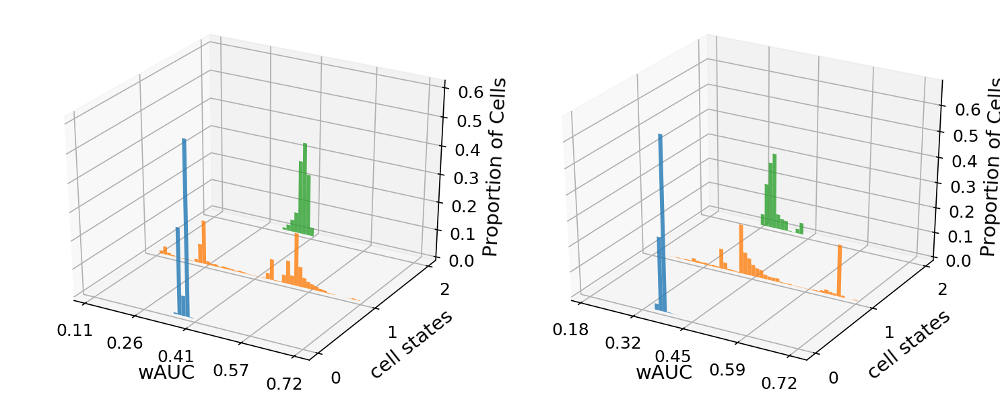

Tsc22d1


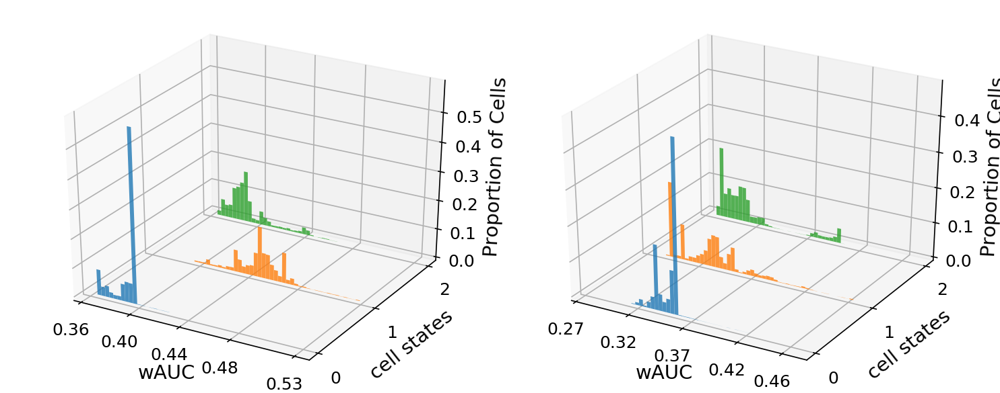

Smarca5


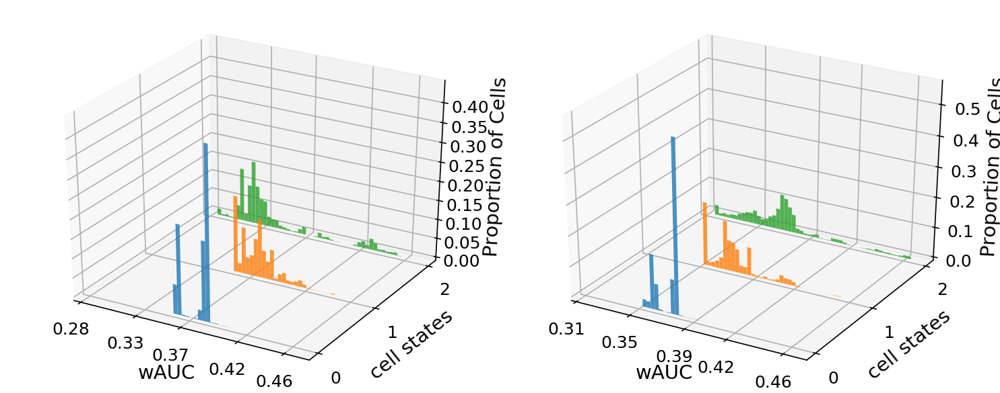

Zfp91


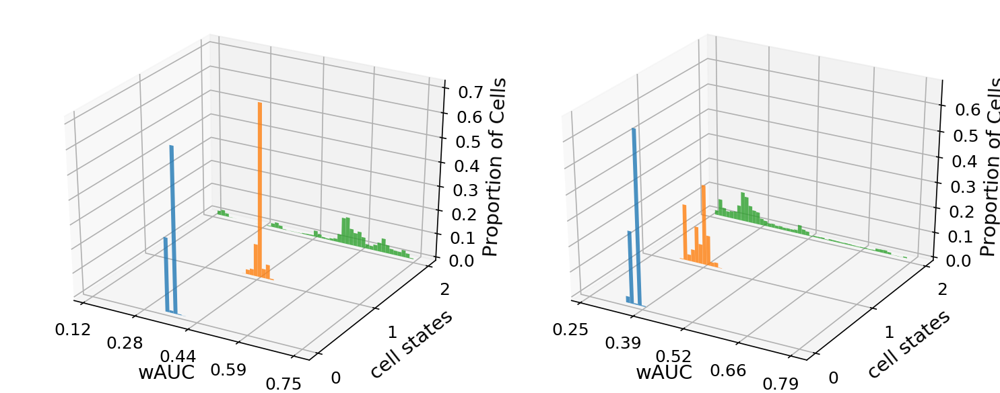

Mier1


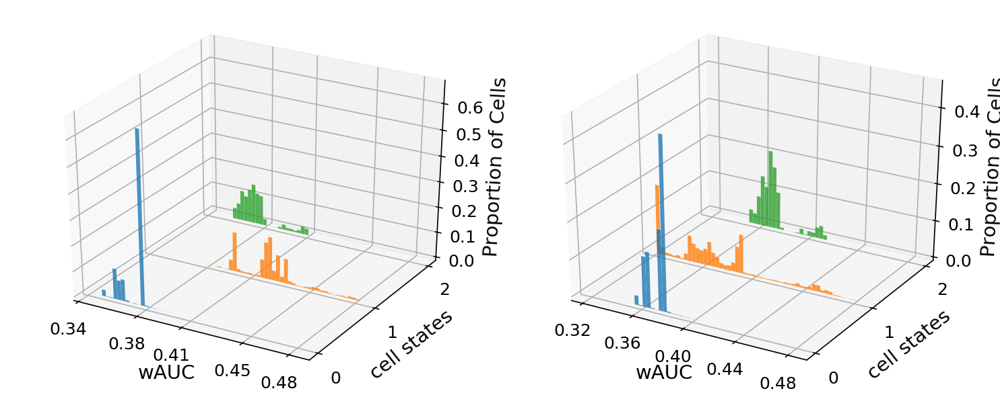

Foxp1


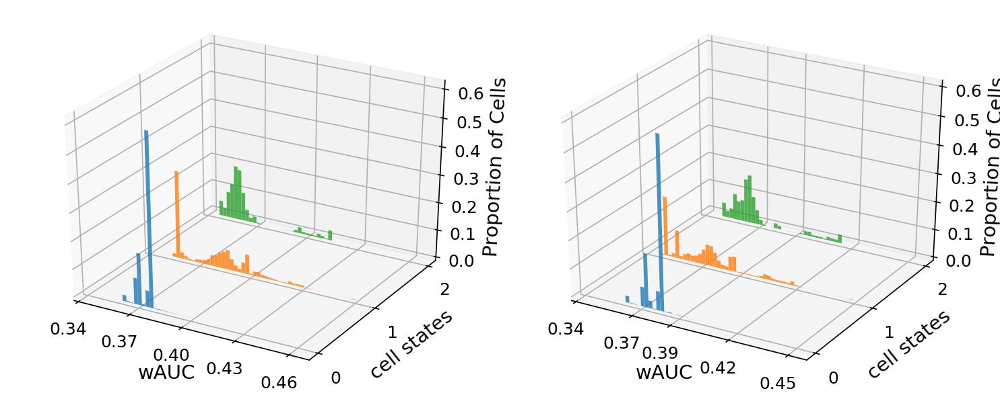

Nr0b2


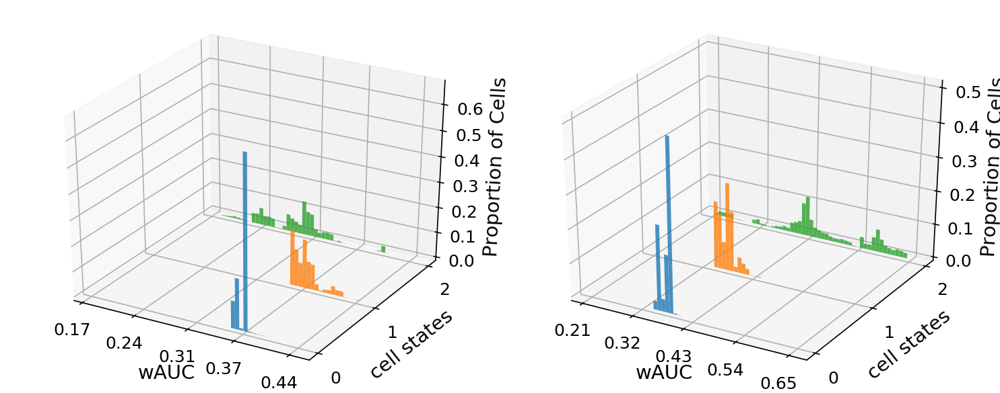

Foxa3


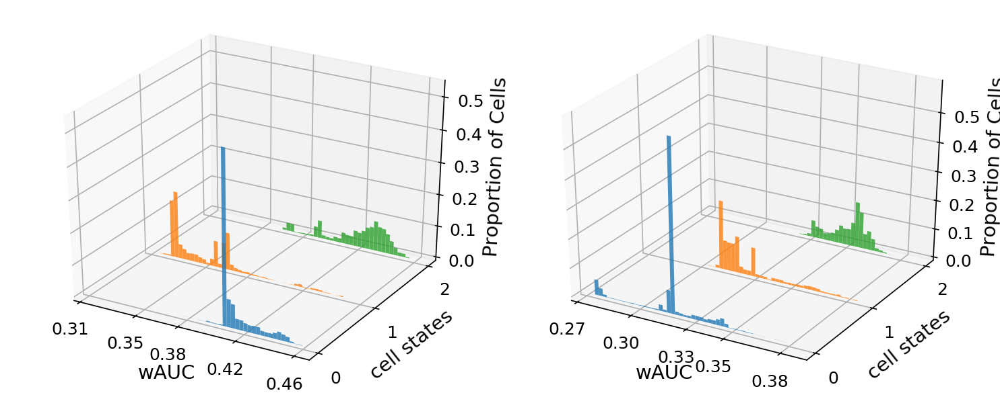

Peg3


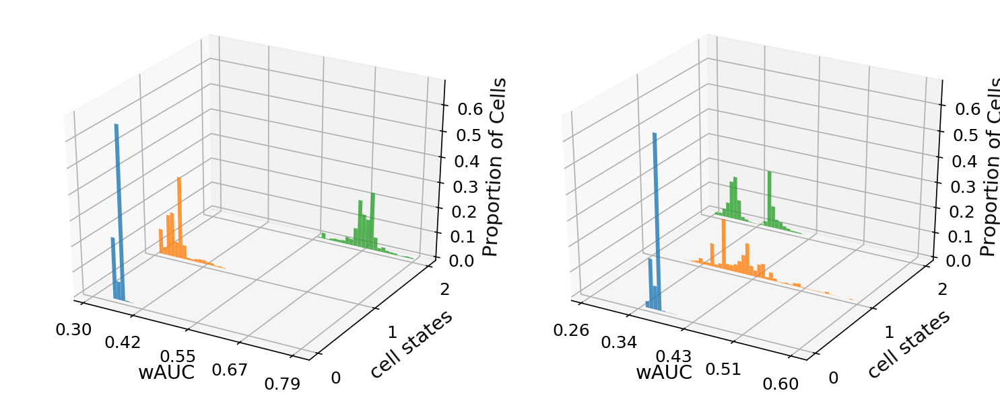

Nono


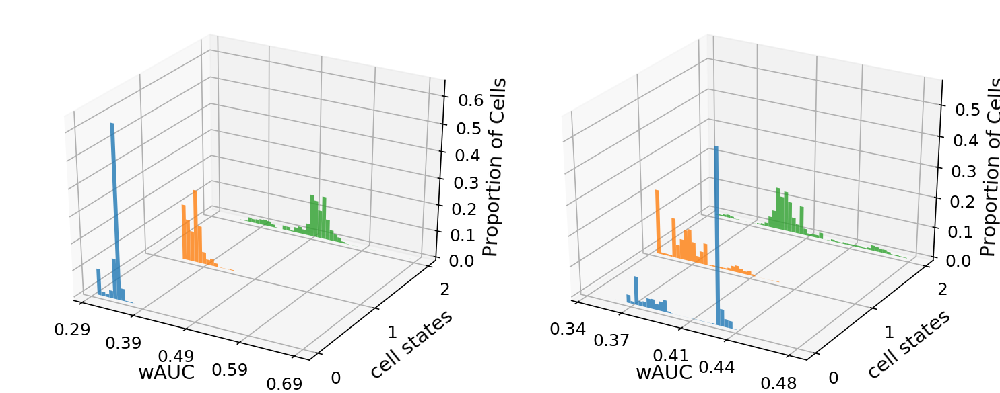

Klf15


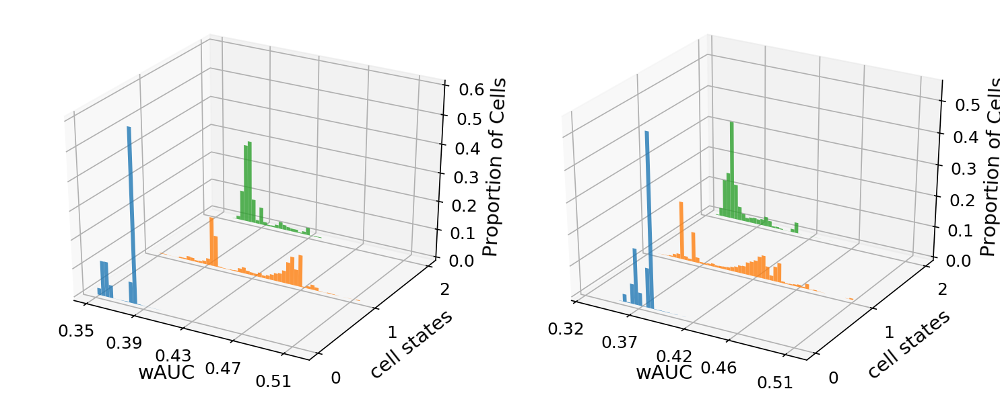

Klf13


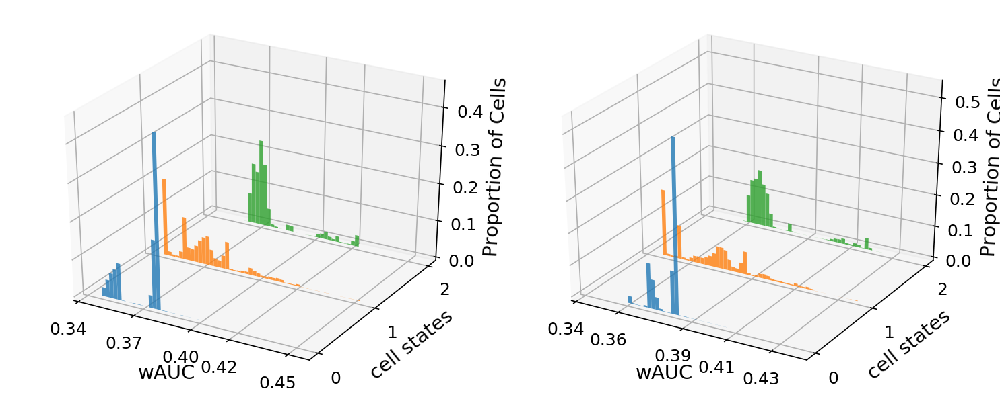

Nfib


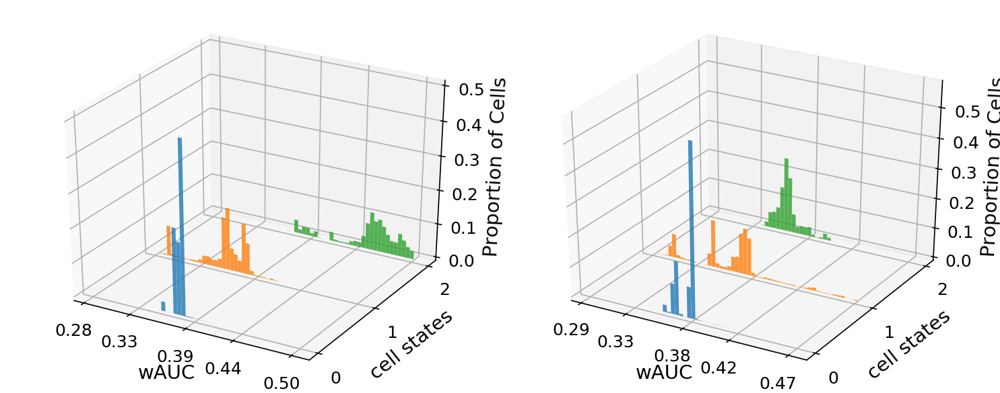

Foxn3


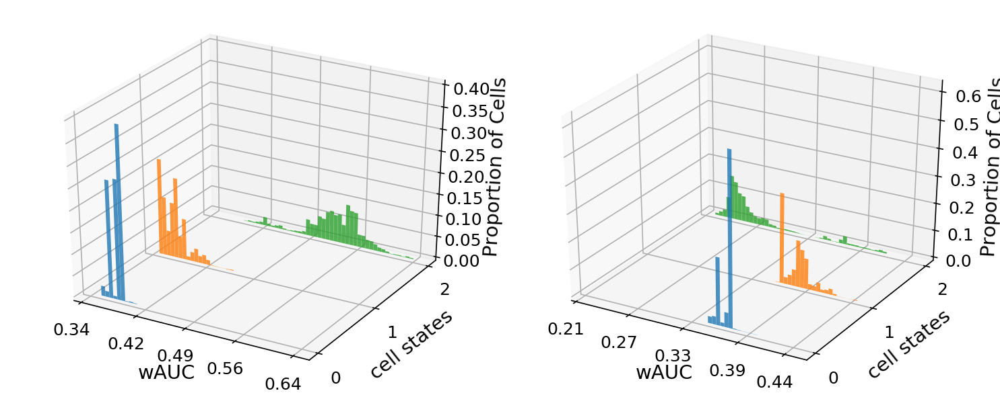

Bhlhe40


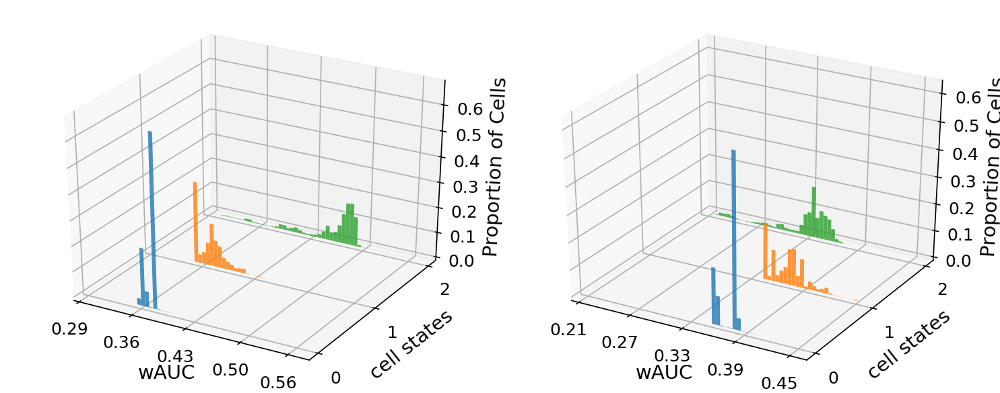

In [53]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, top_only_simic)

# TFs that are only rank top varint in no-simic

Id3


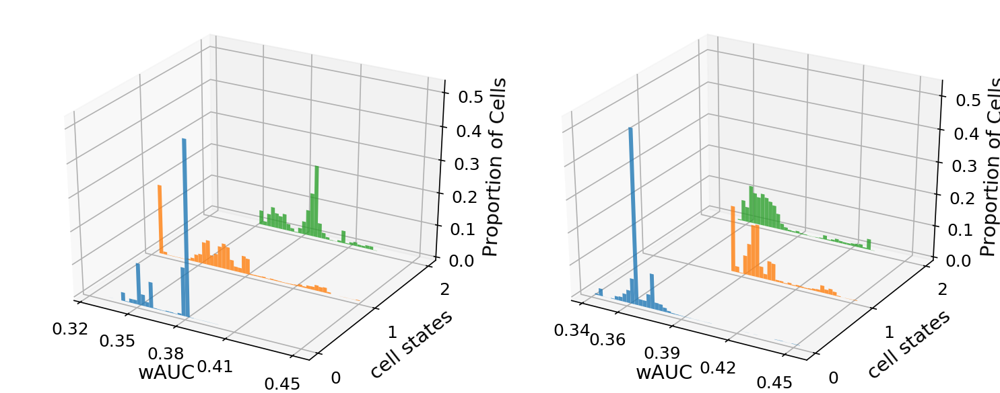

Tfdp1


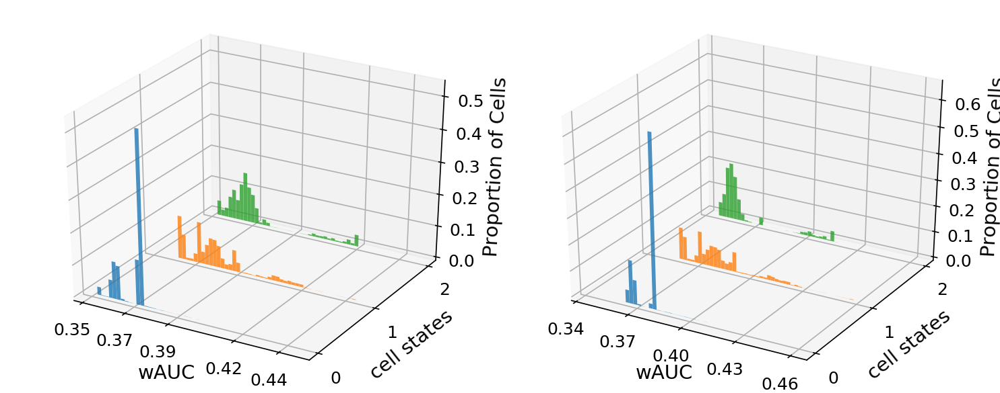

Crem


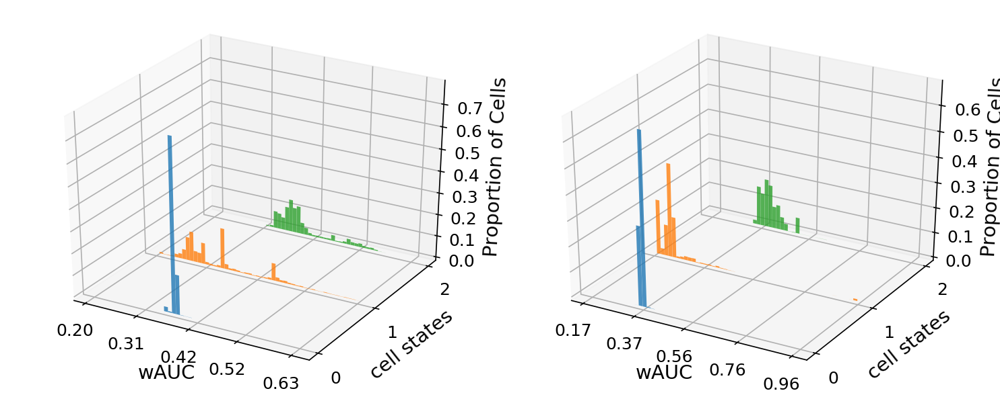

Id1


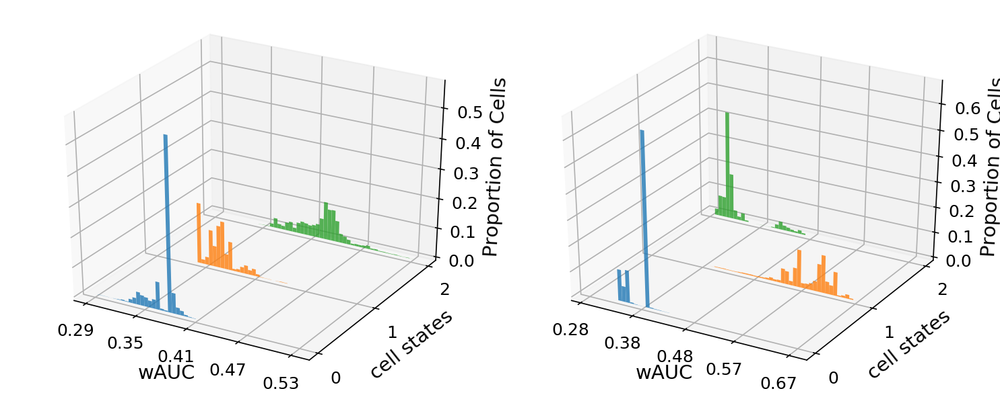

Mlxipl


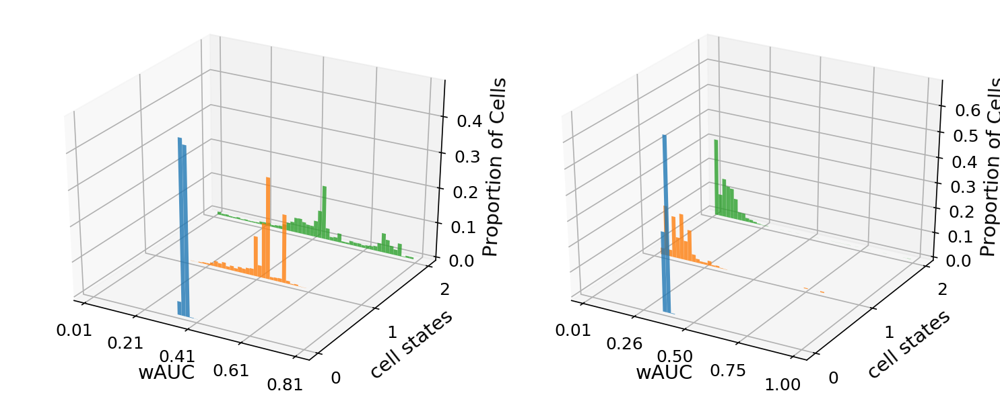

Id2


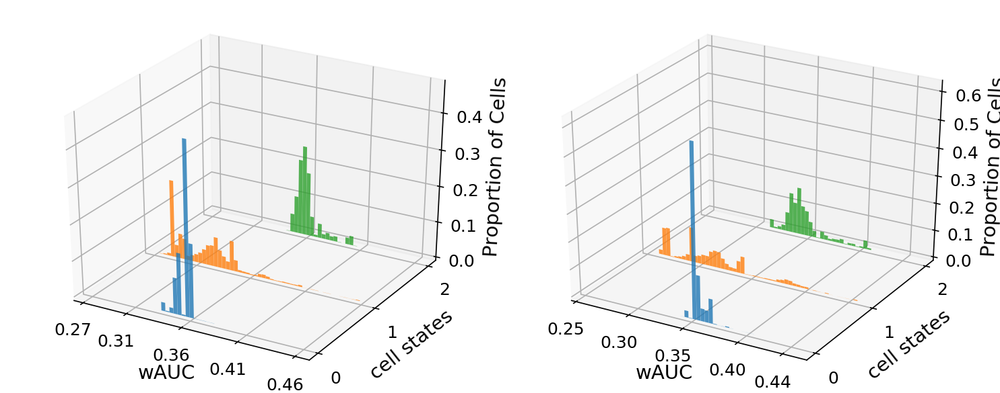

Nr1h3


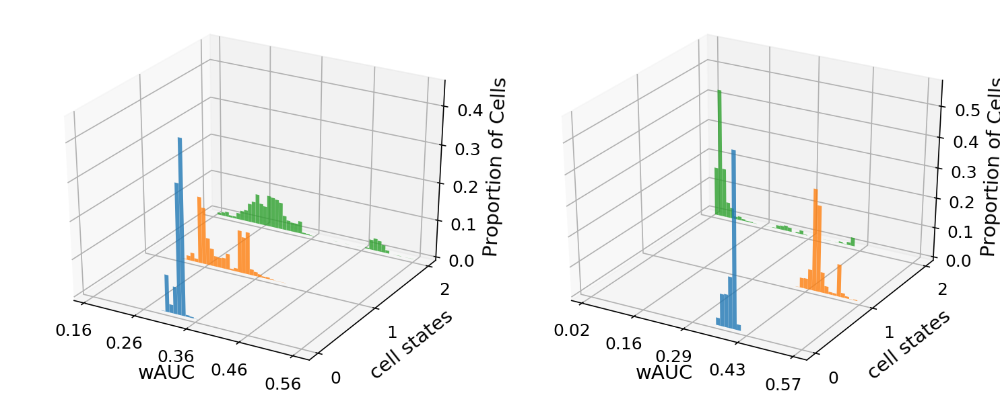

Hif1a


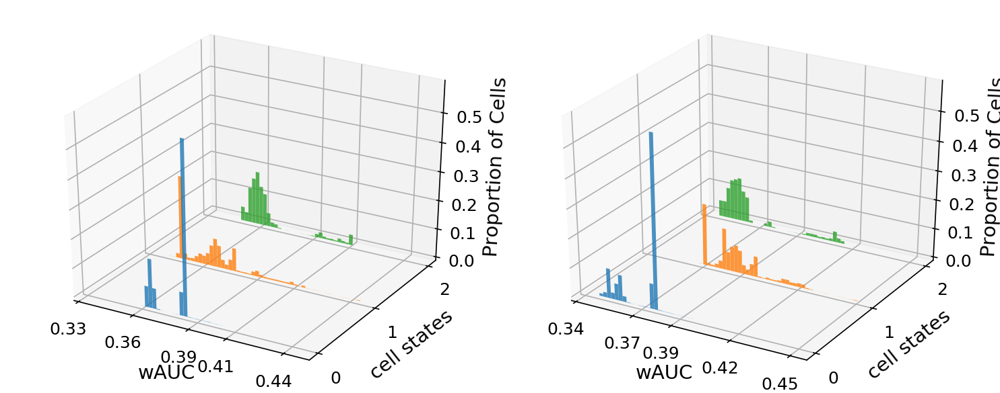

Mlx


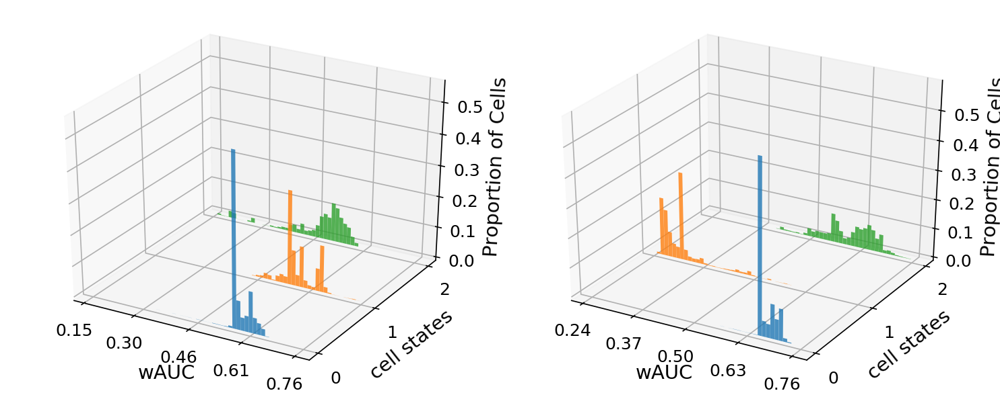

Klf9


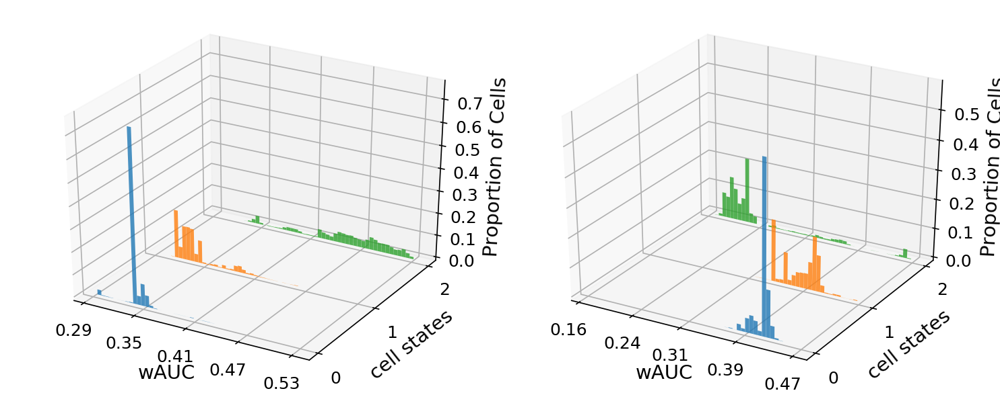

Mafb


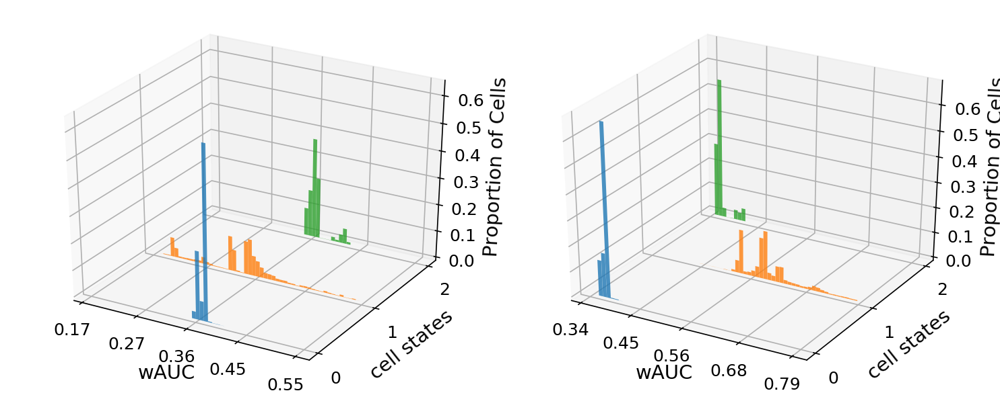

Nr1h4


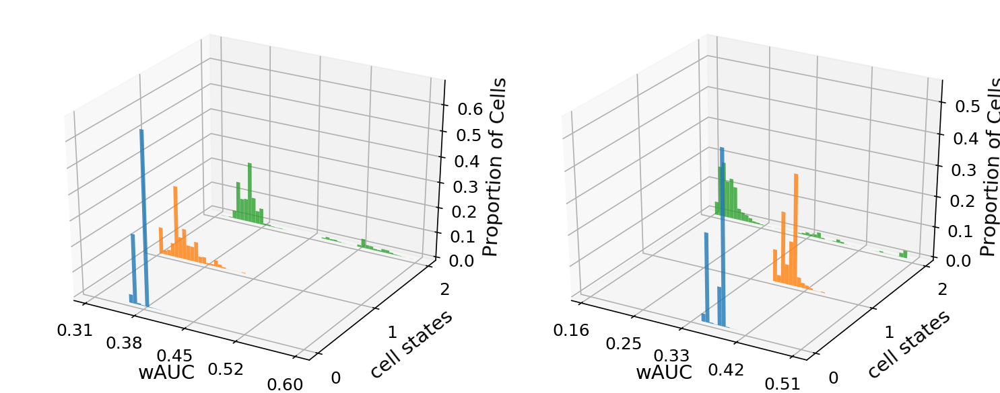

In [55]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, top_only_no_simic)

--------
# TFs that are only rank last variant in simic

Sox5


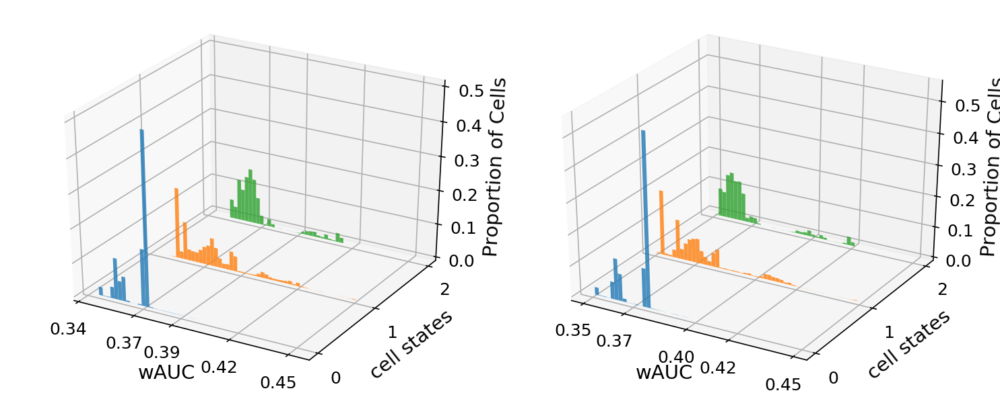

Rlf


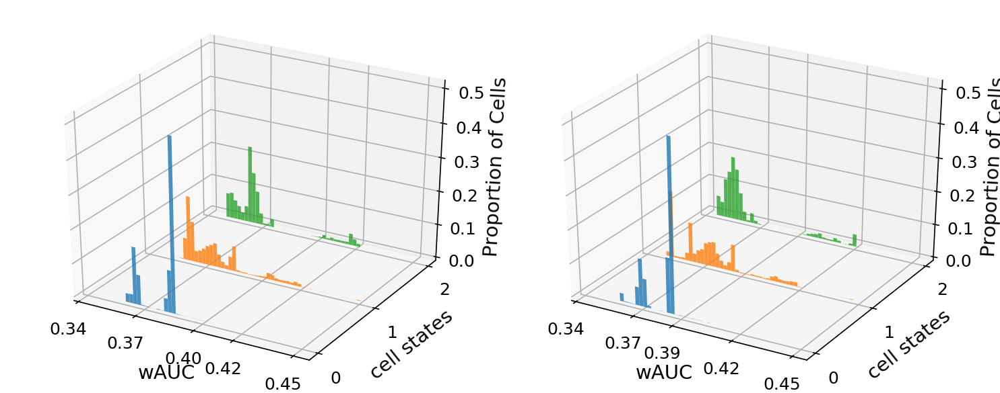

Atf1


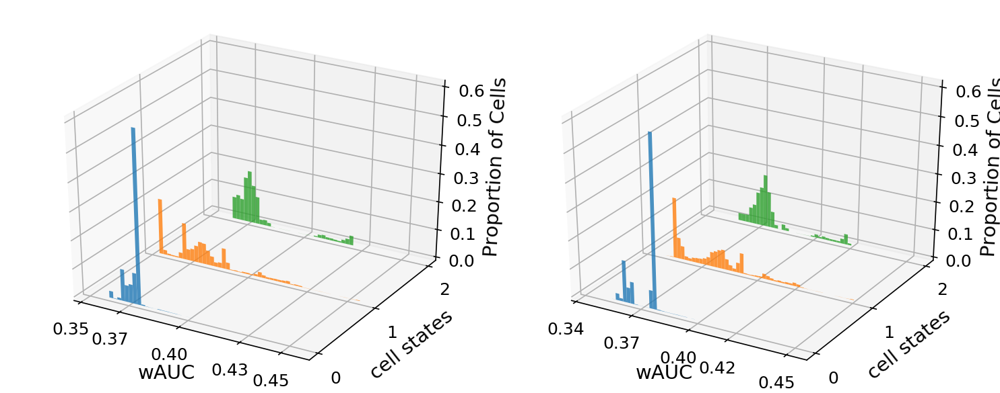

Cebpa


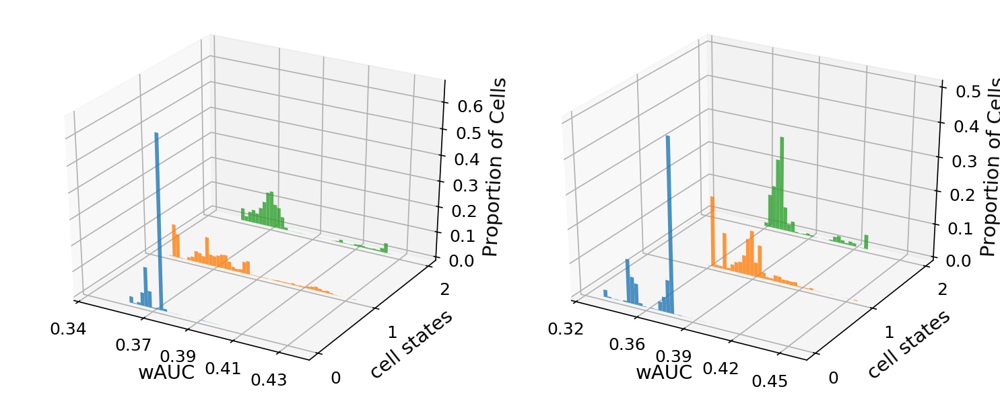

Kdm2a


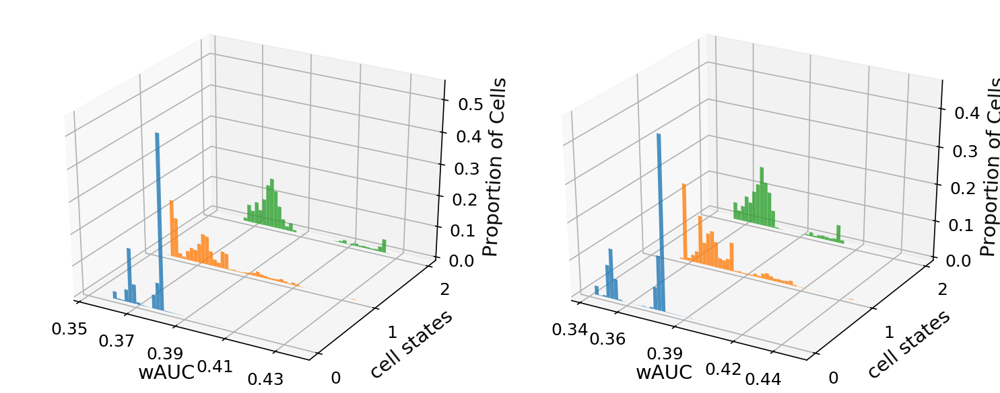

Tox4


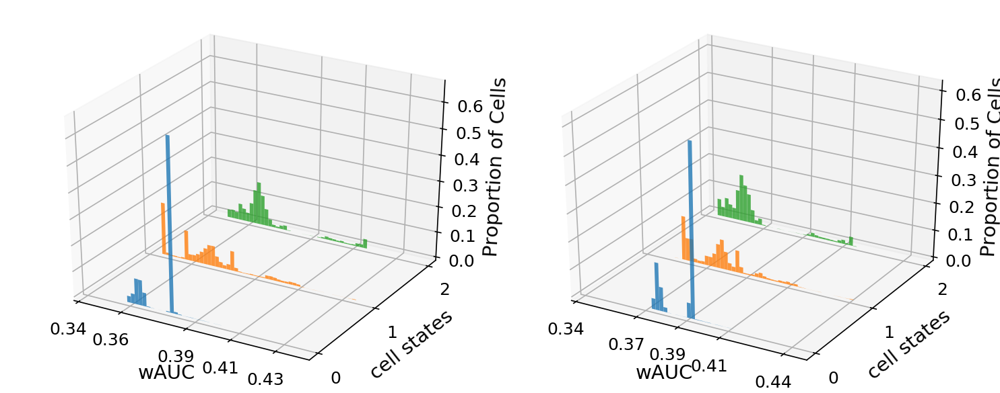

Nfkbia


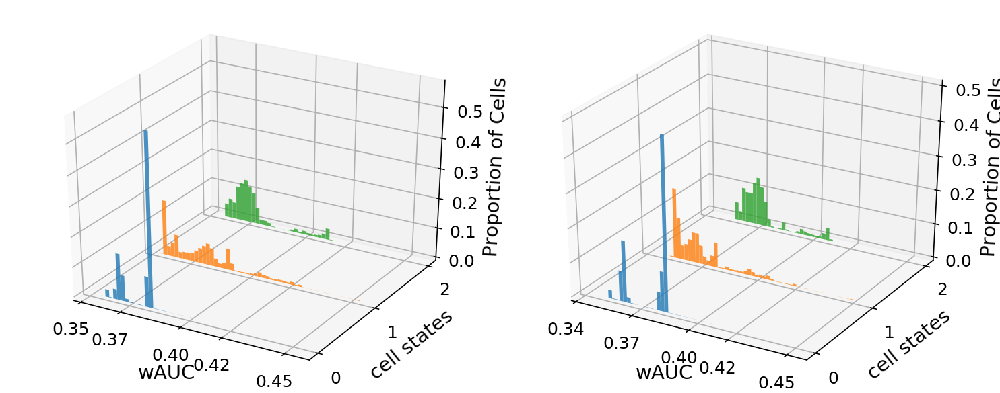

Sox9


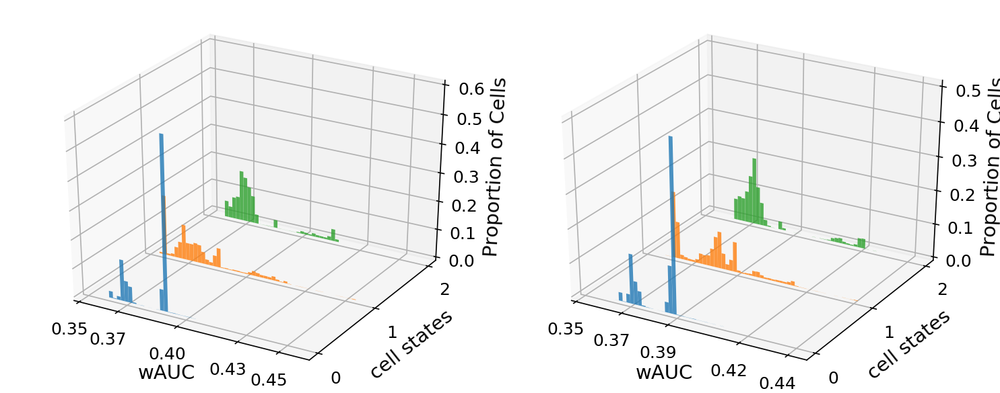

Cux1


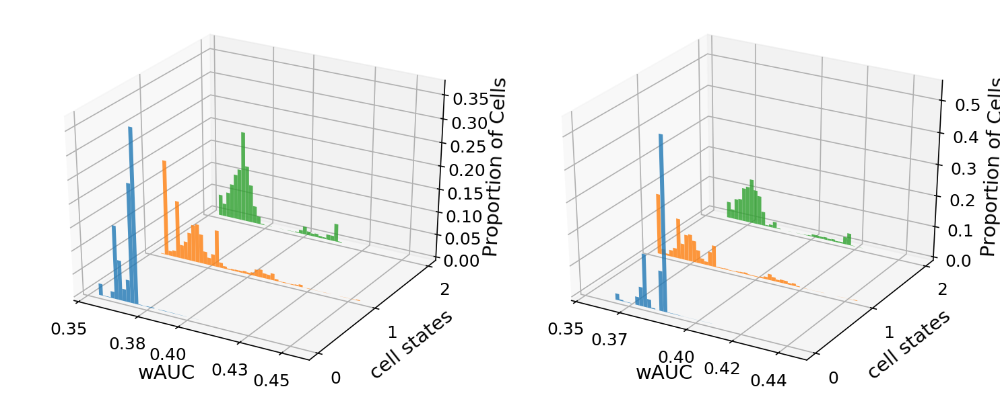

Gzf1


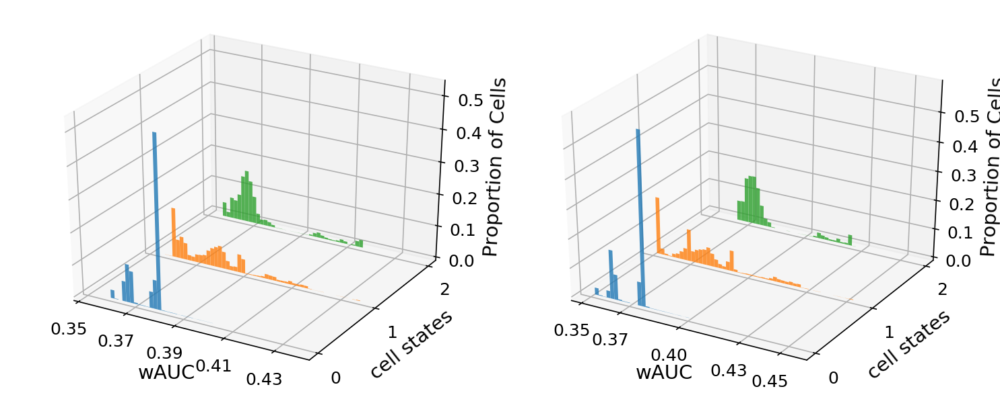

Stat5b


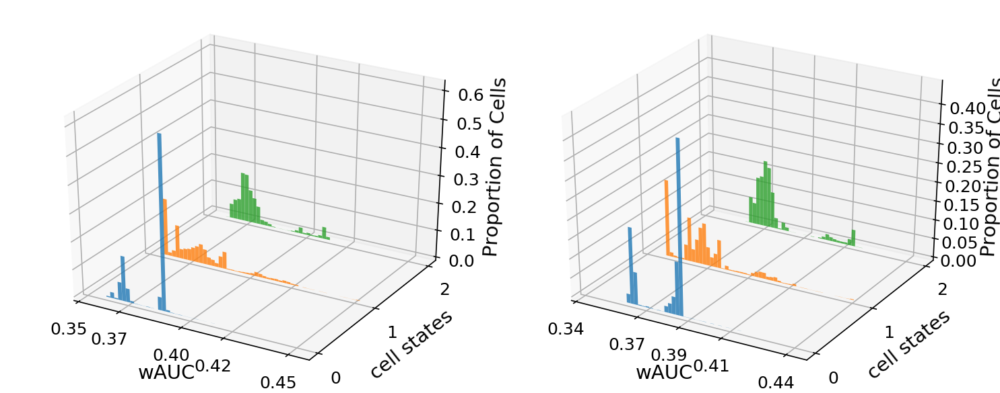

Tef


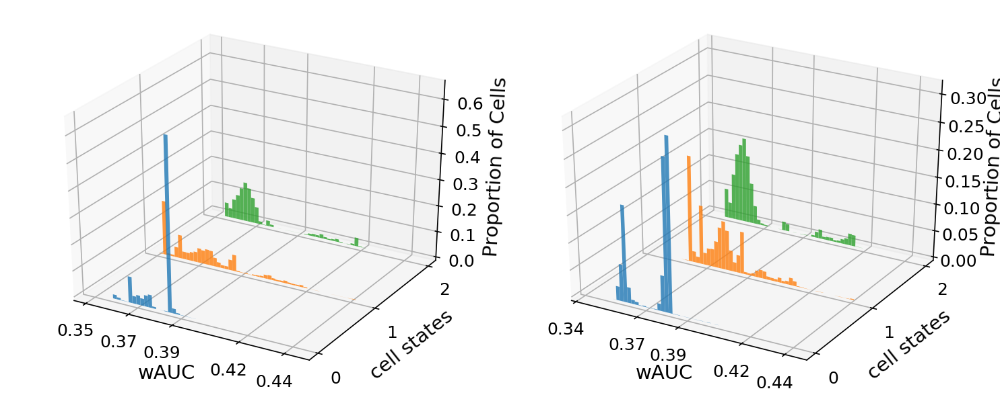

Zbtb7b


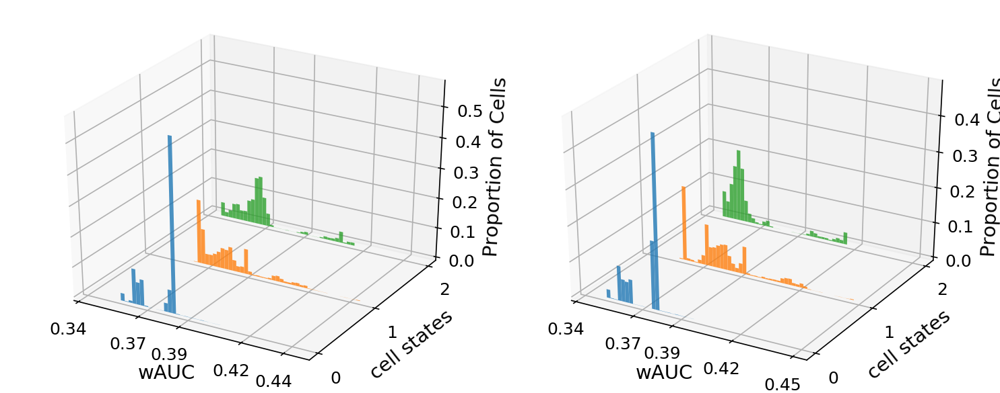

Foxo3


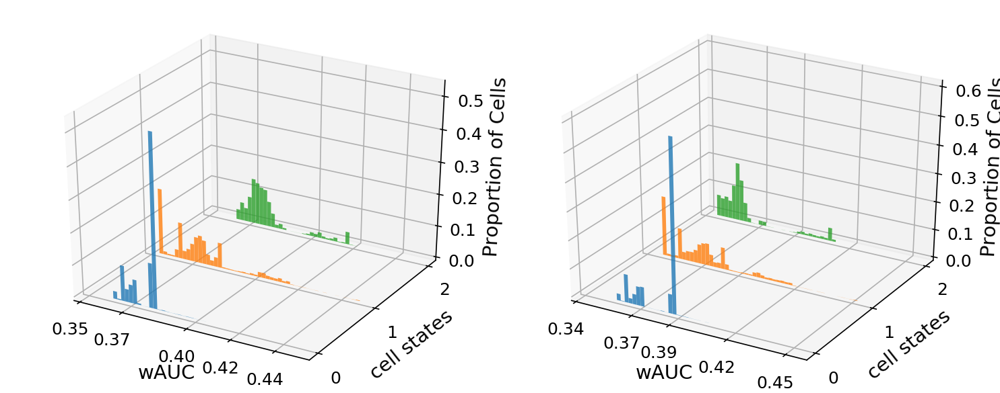

Nfe2l1


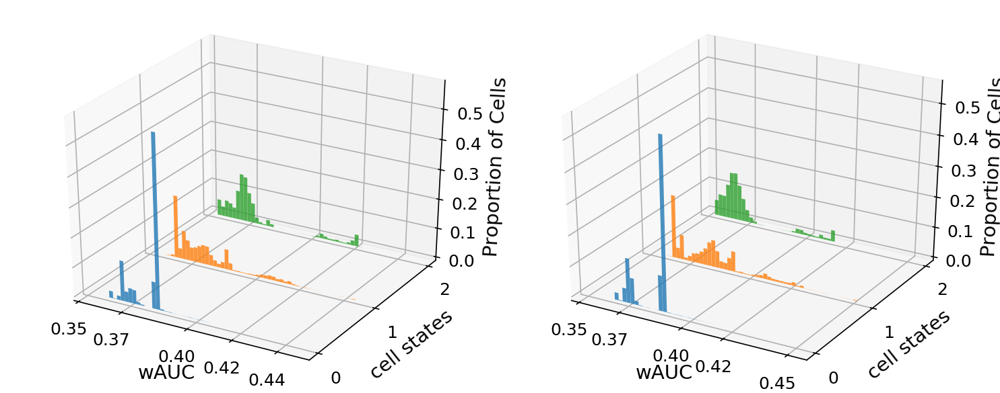

Tfdp1


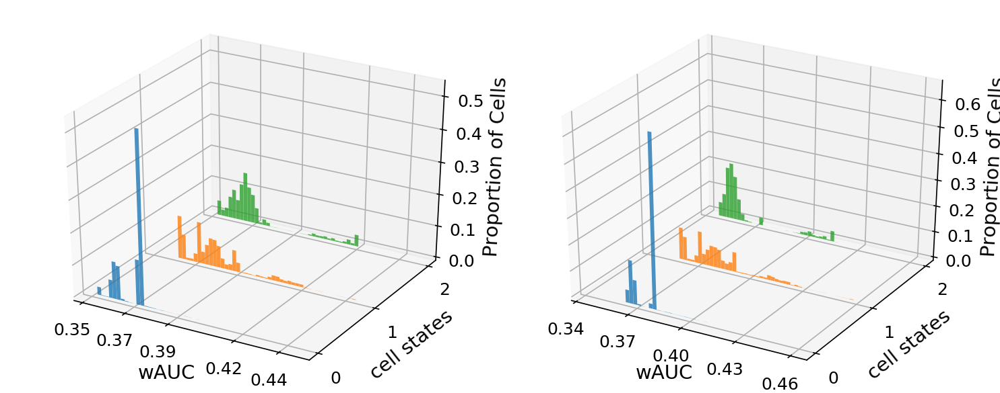

Sp3


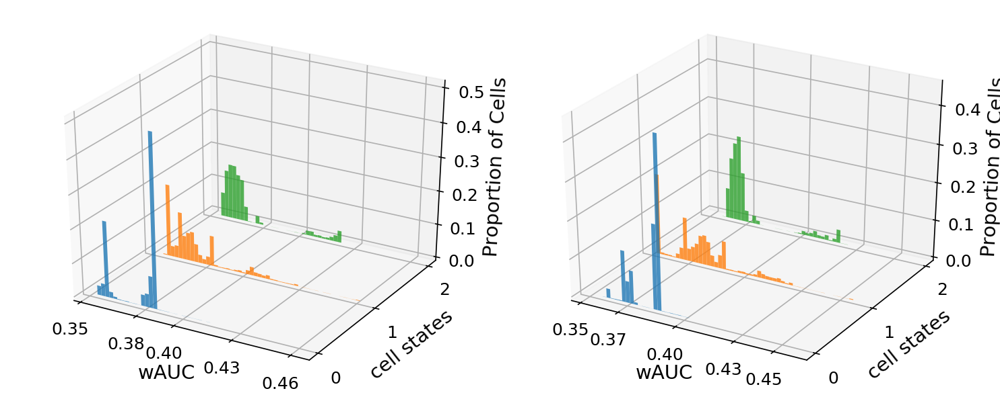

Zhx1


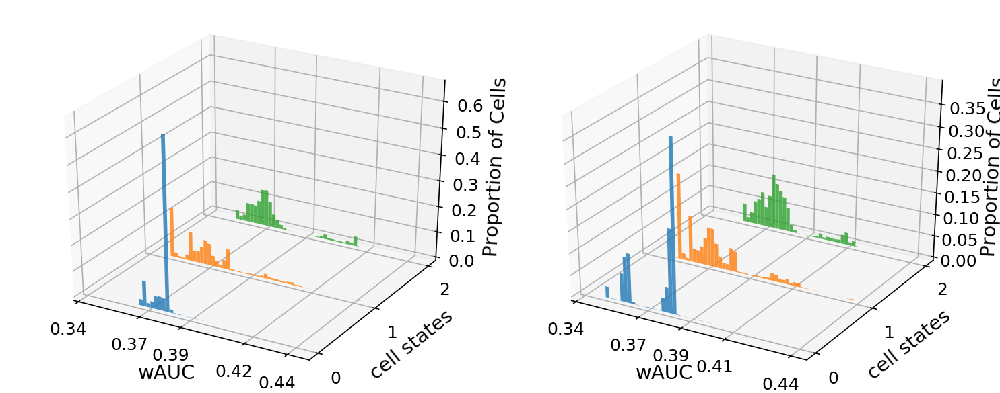

Nr1d2


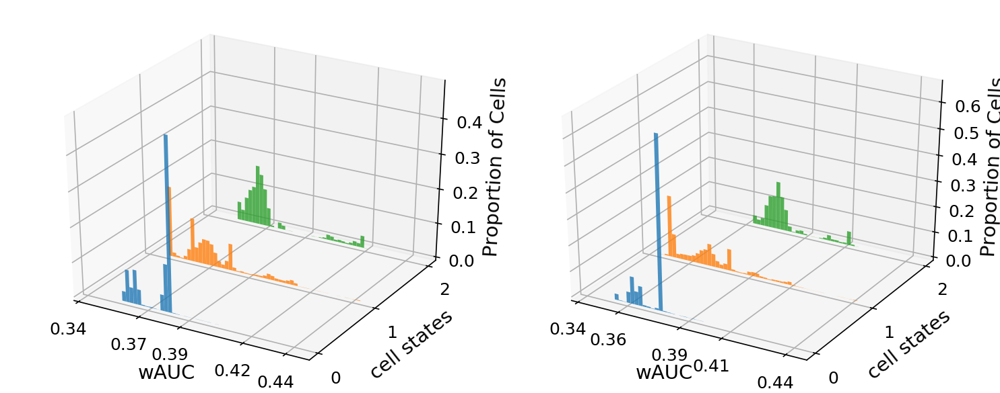

Nr2f2


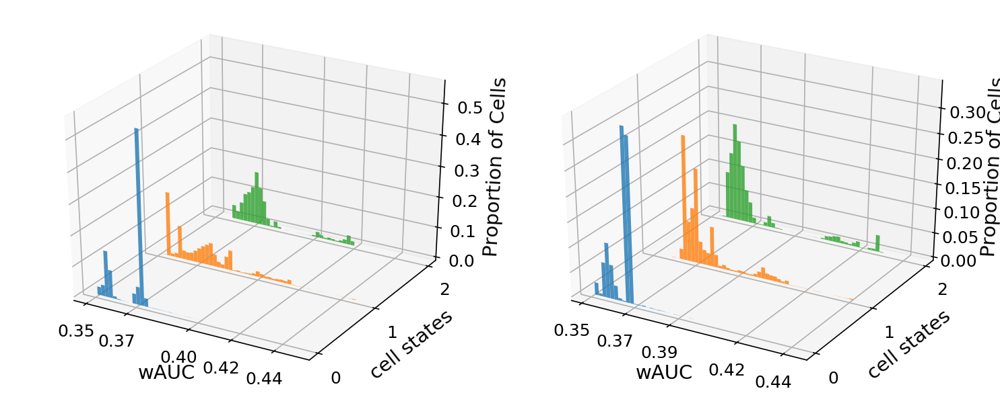

Sall1


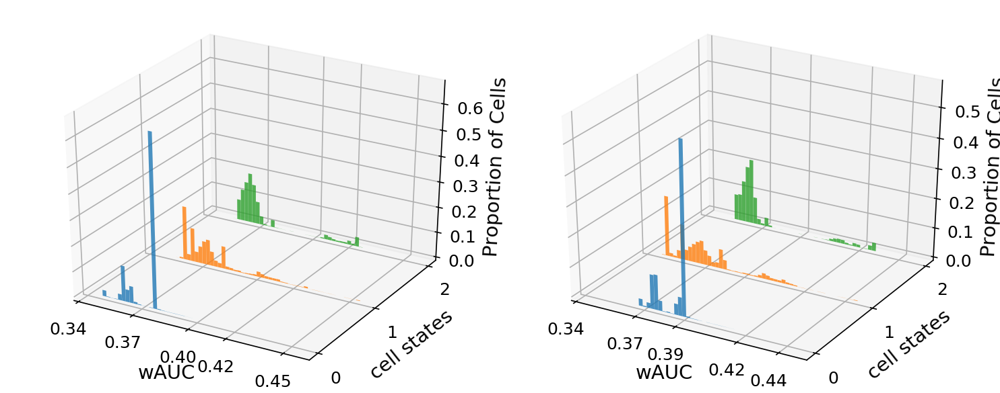

Onecut1


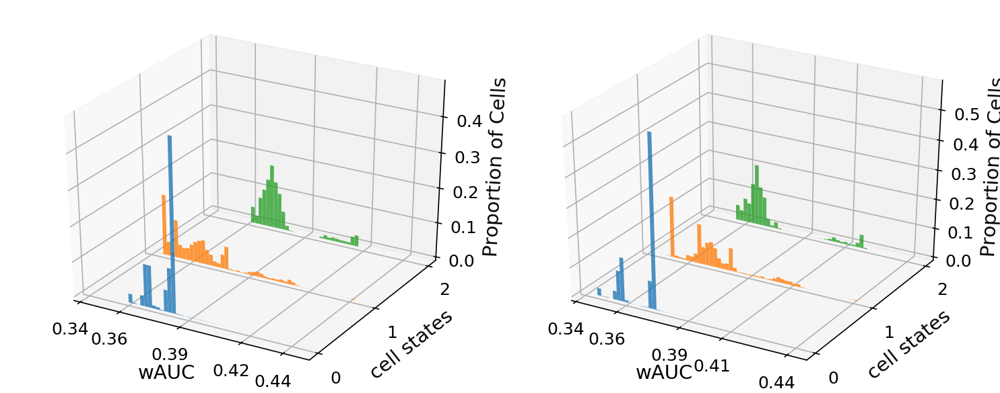

Klf12


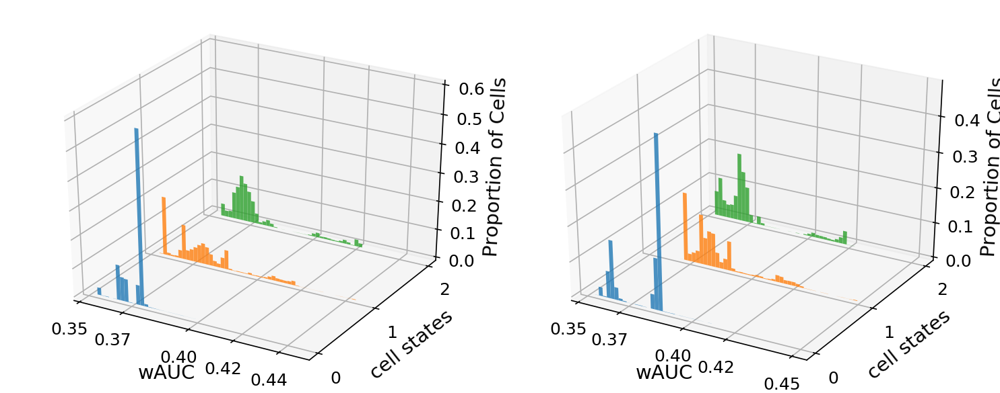

In [56]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, last_only_simic)

--------
# TFs that are only rank last variant in no-simic

Smarcc1


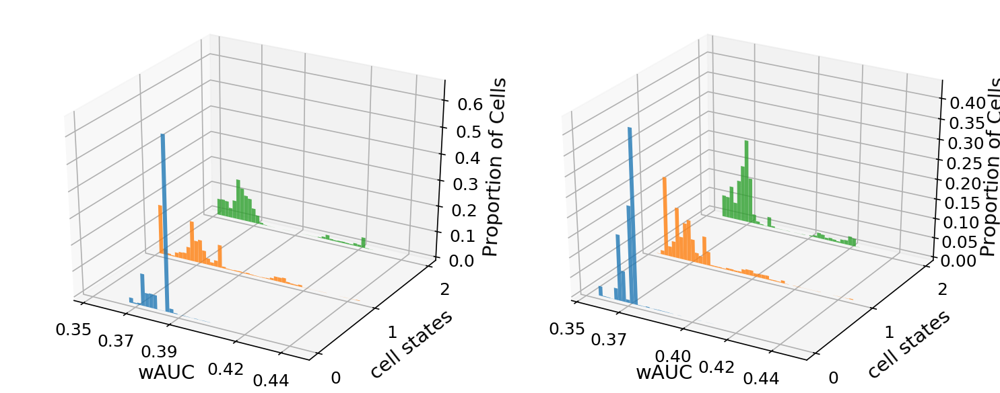

Elf1


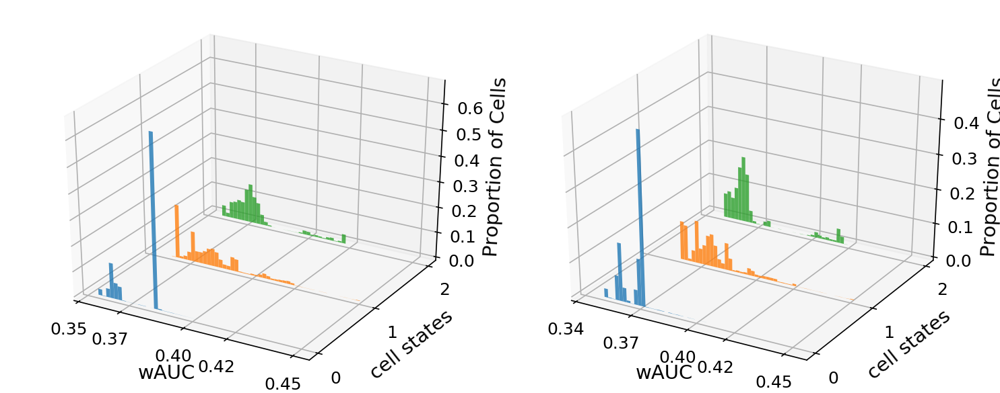

Lrrfip2


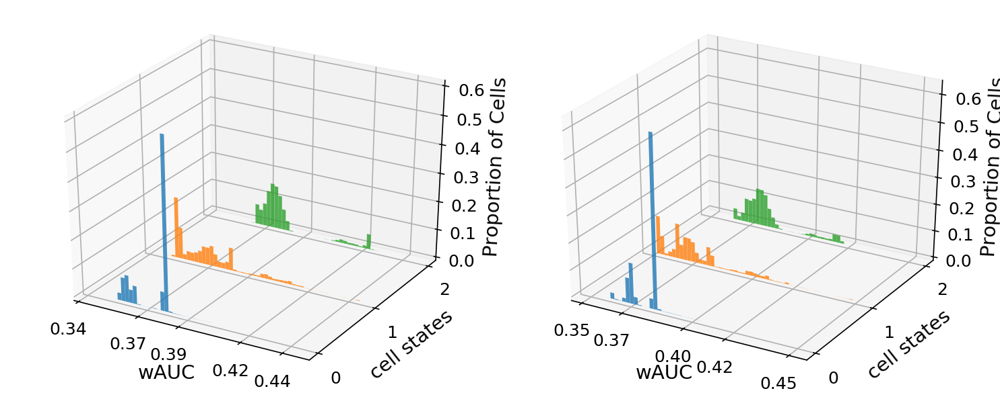

Atf5


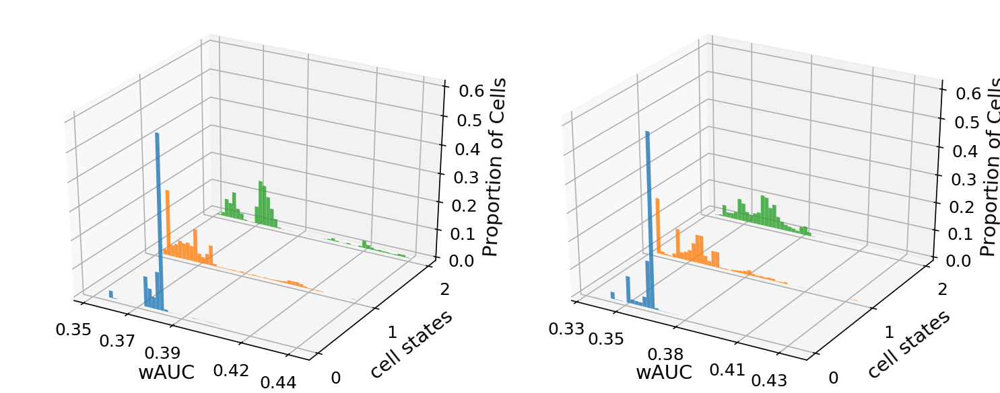

Cebpb


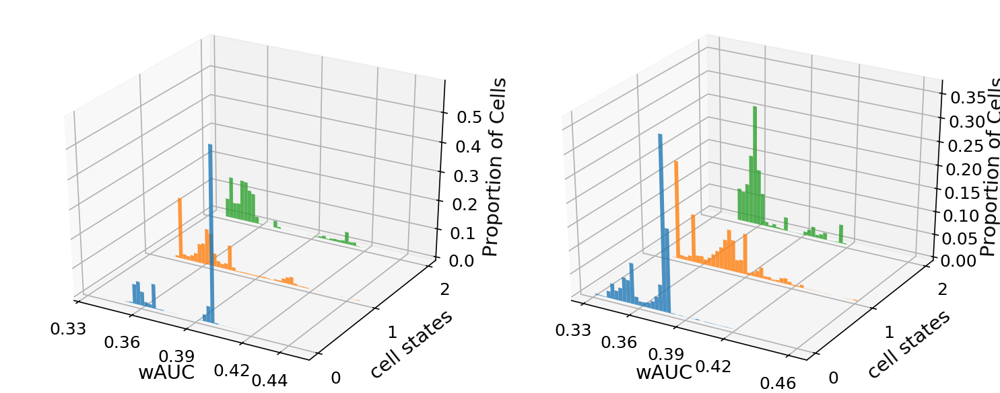

Hhex


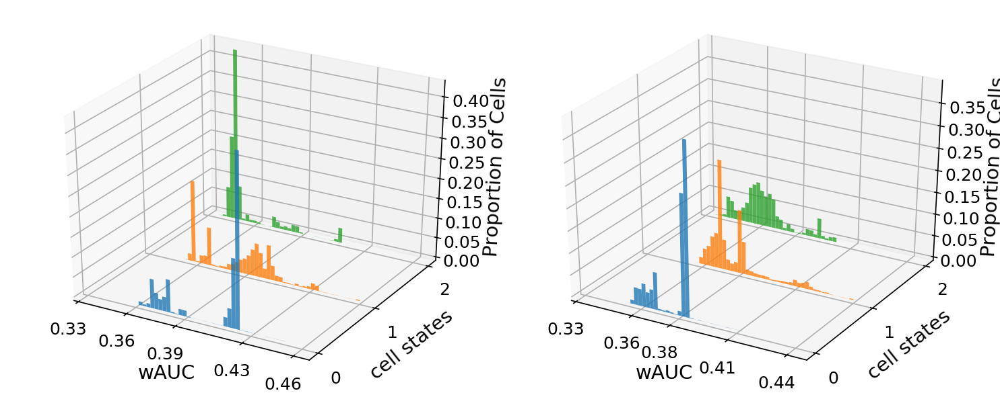

Yy1


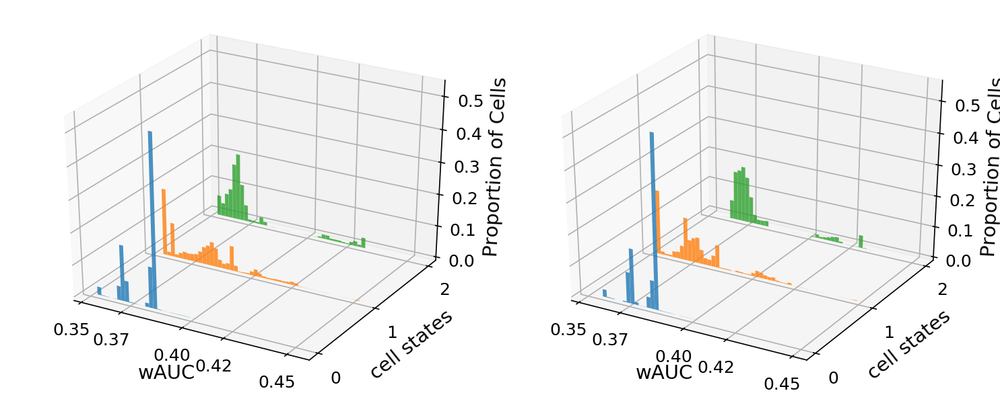

Jund


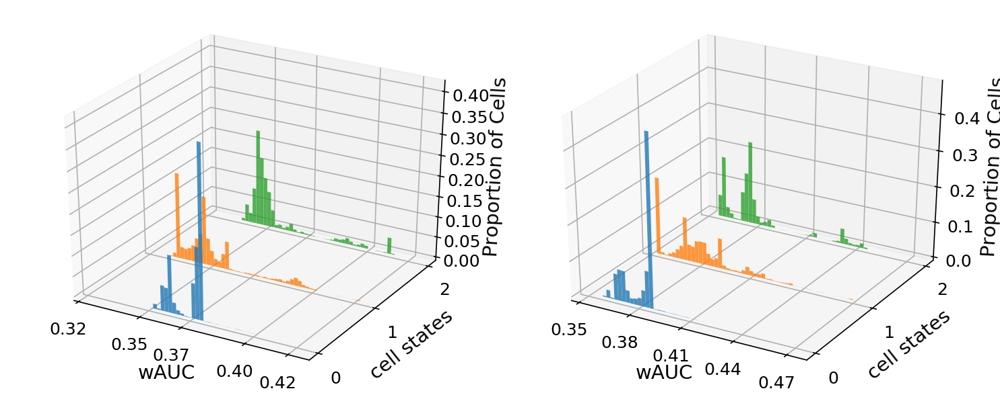

Bach1


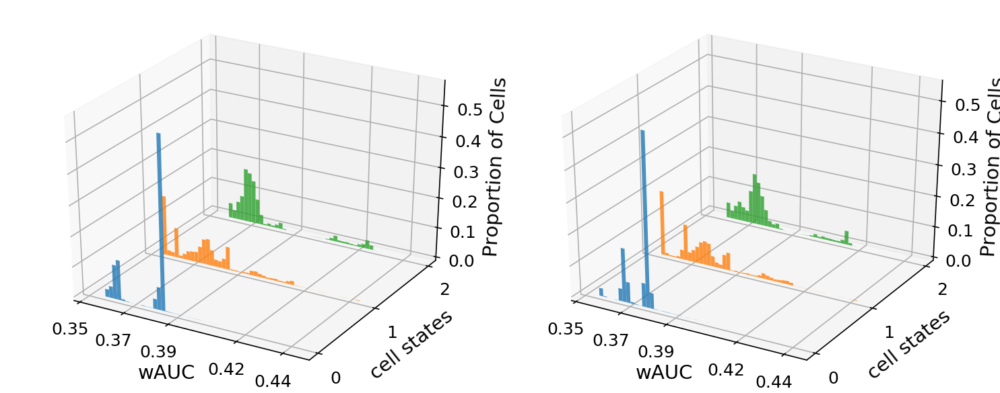

Ctcf


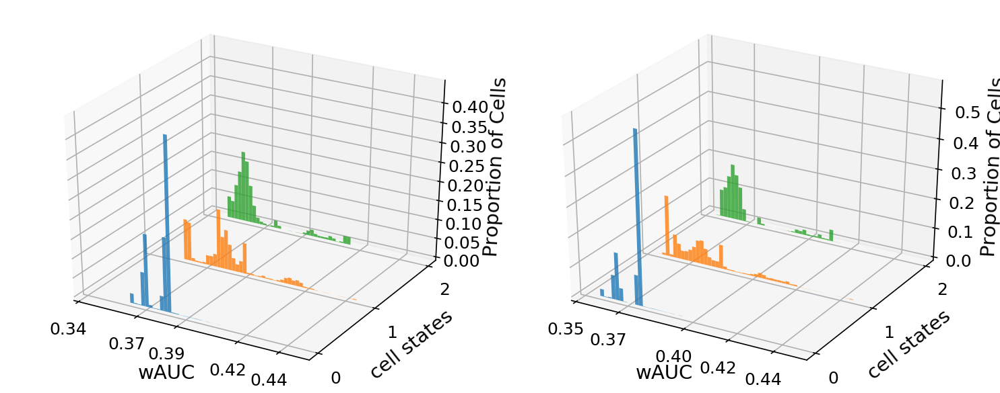

Purb


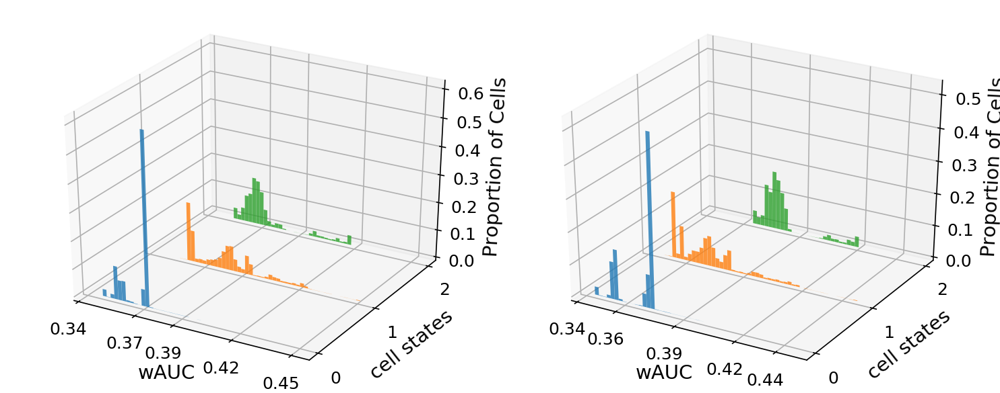

Irf2


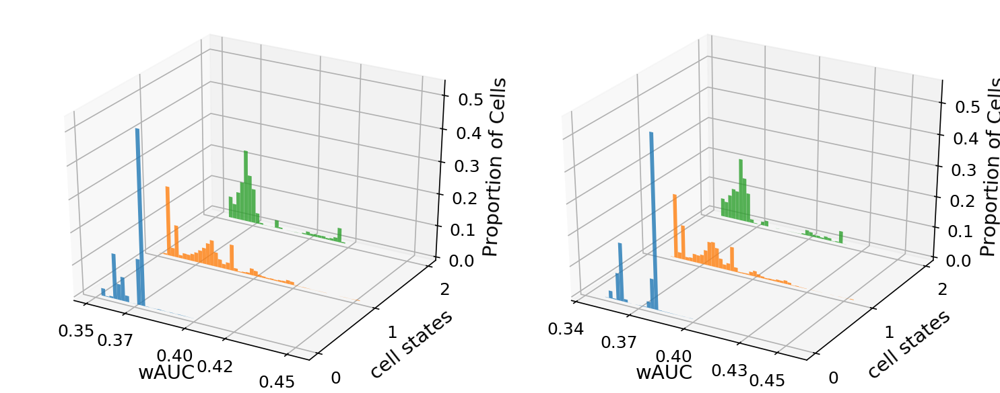

Maz


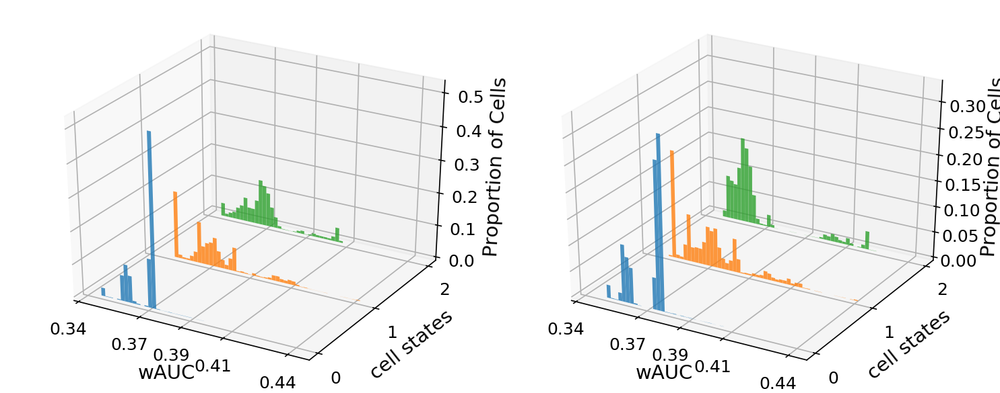

Ncoa2


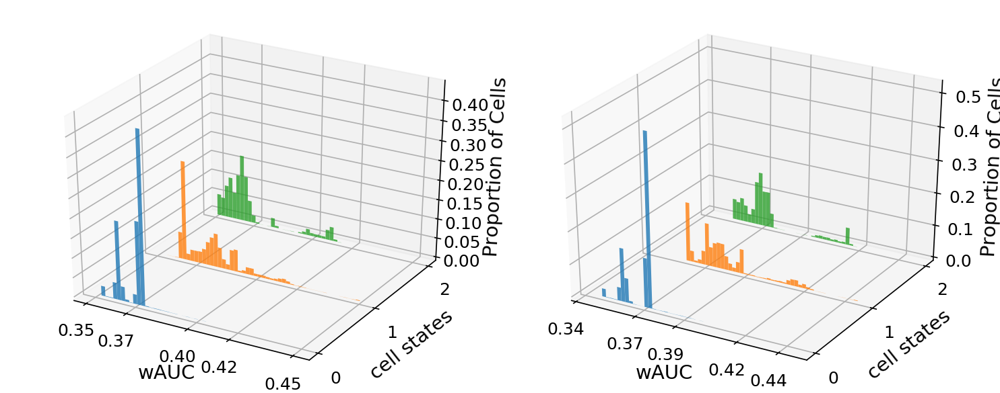

Stat3


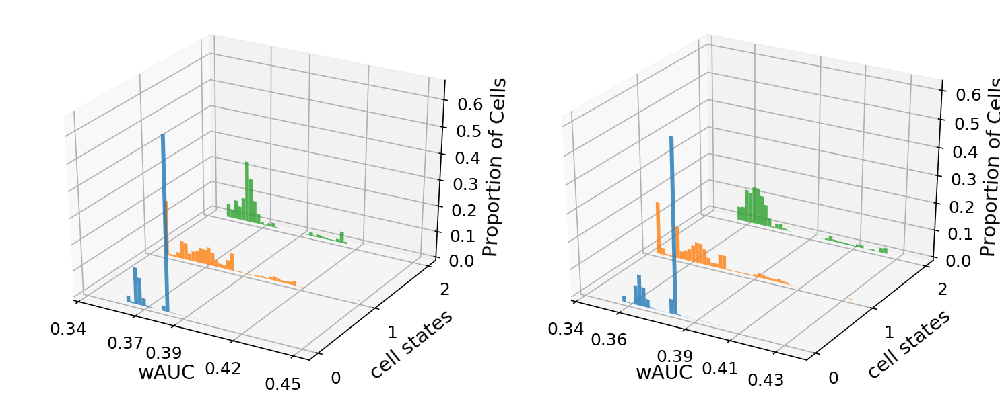

Hmg20b


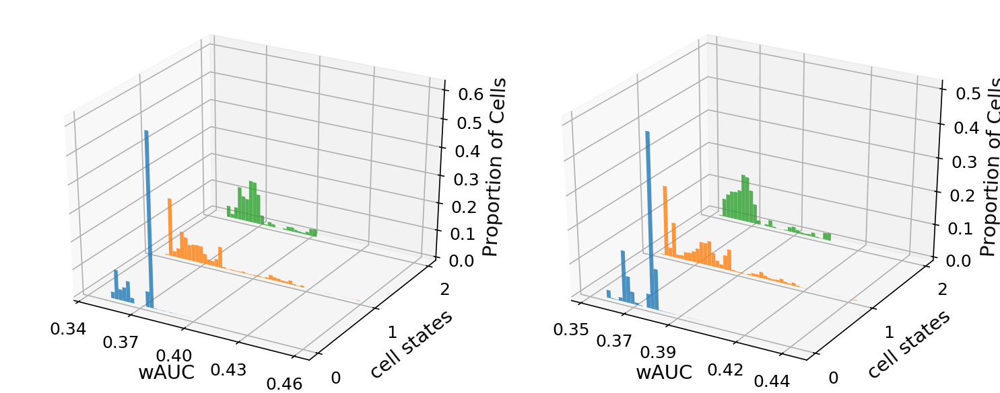

Ssrp1


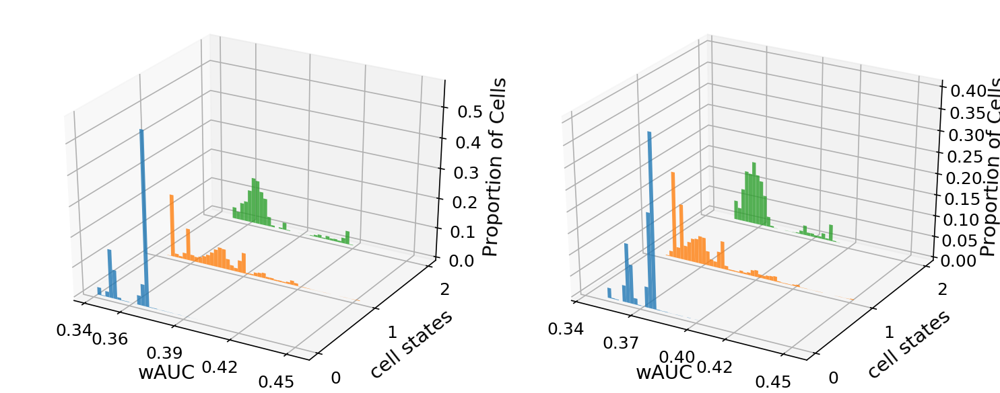

Creb3l2


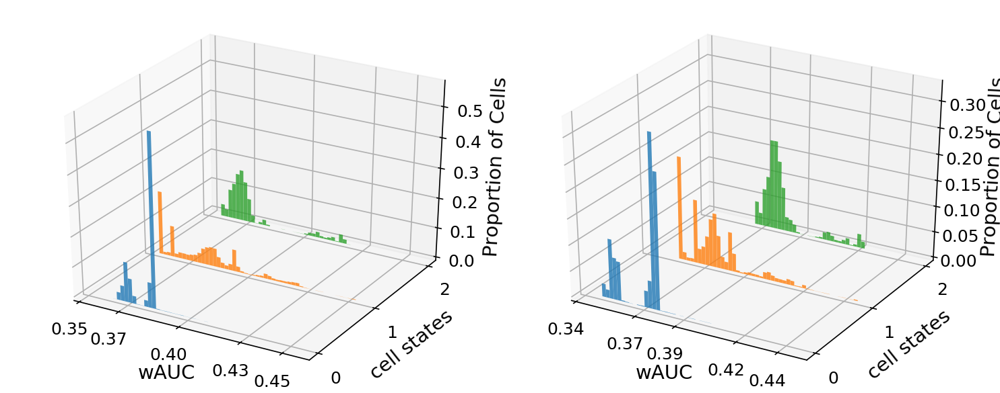

Mef2a


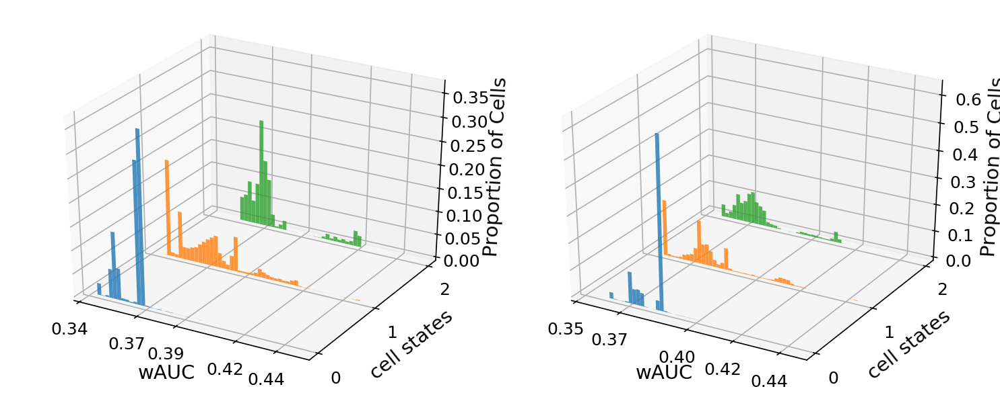

Pura


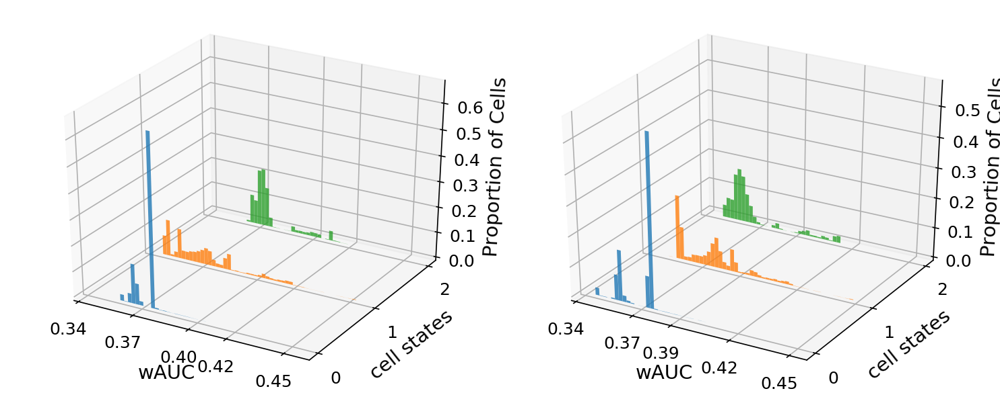

Ets2


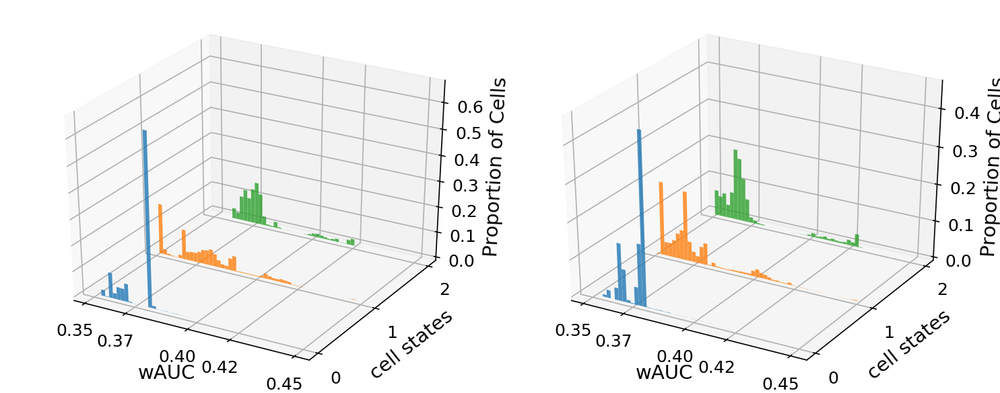

Mafg


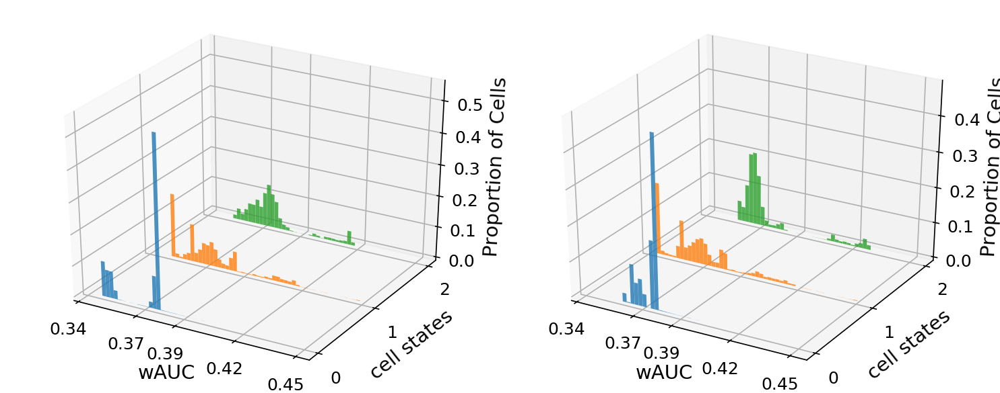

Rc3h2


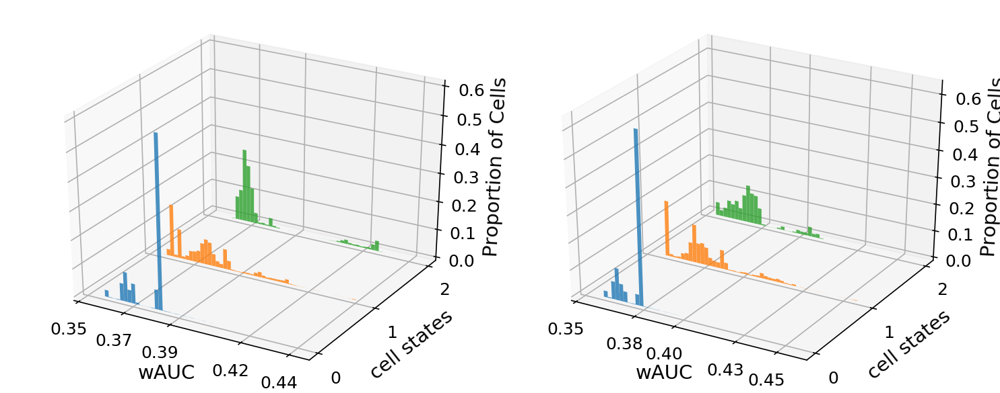

In [57]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, last_only_no_simic)

---------
# TFs that are rank top in simic, but last in no-simic

In [58]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, top_simic_last_no_simic)

---
# TFs that are rank last in simic, but top in no-simic

Tfdp1


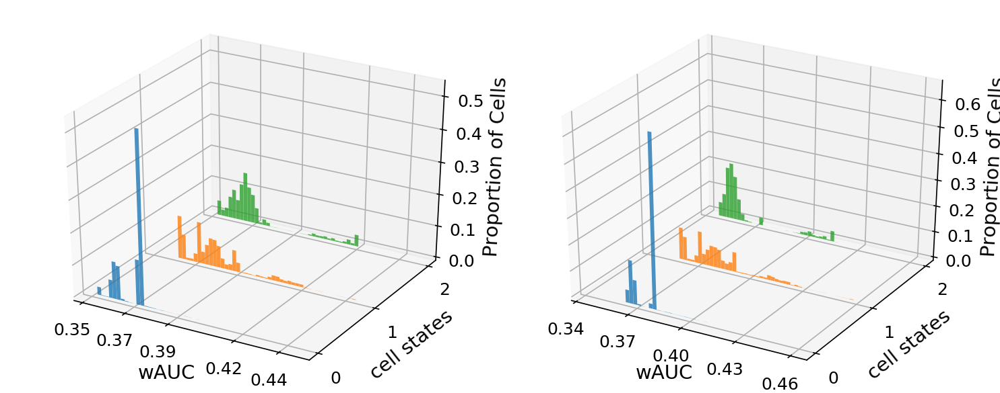

In [67]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, last_simic_top_no_simic)

# List of gene of interests

Ybx1


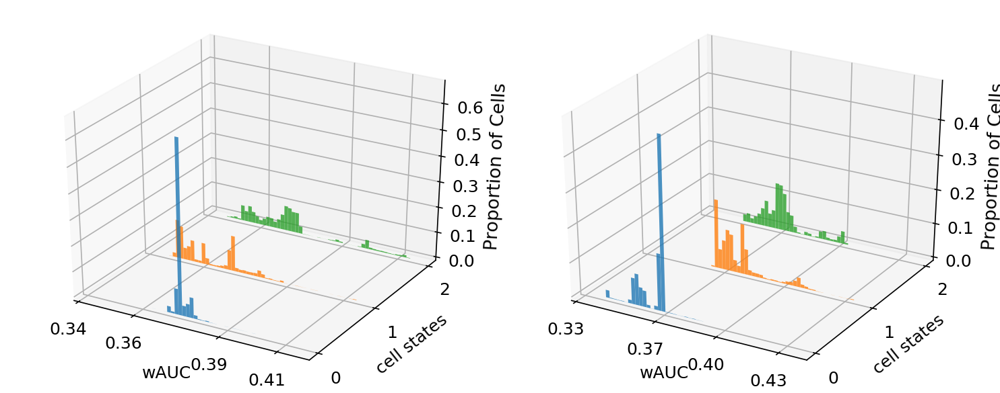

Id3


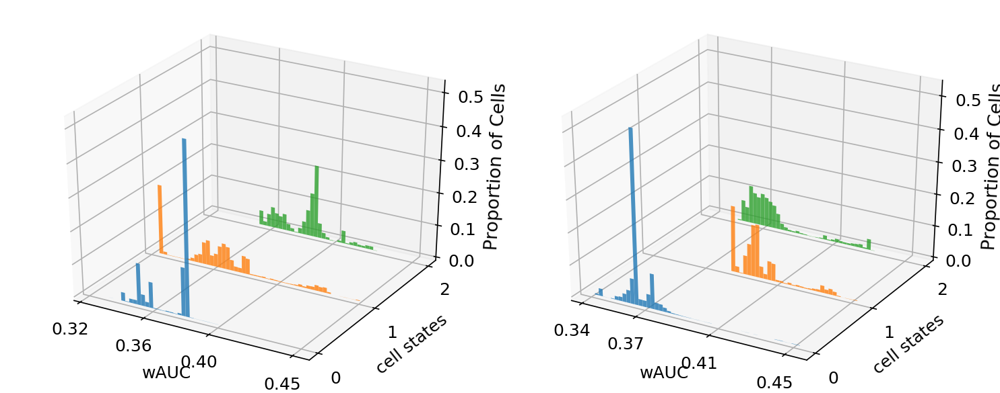

Nr0b2


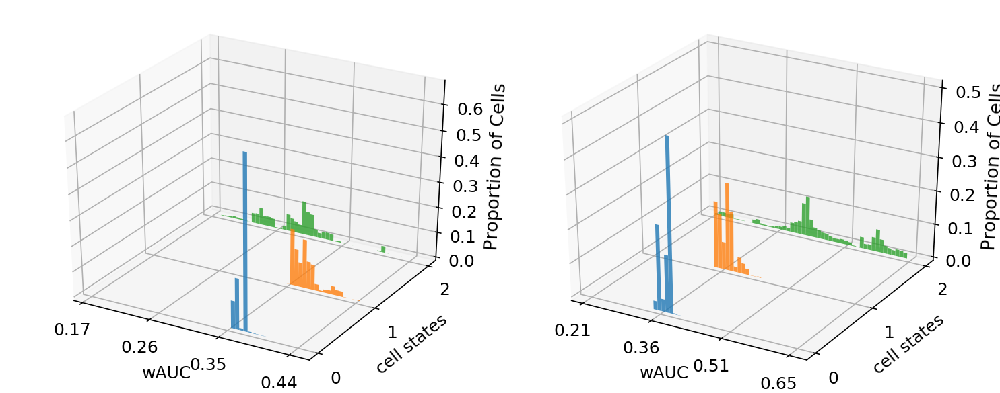

Ncor1


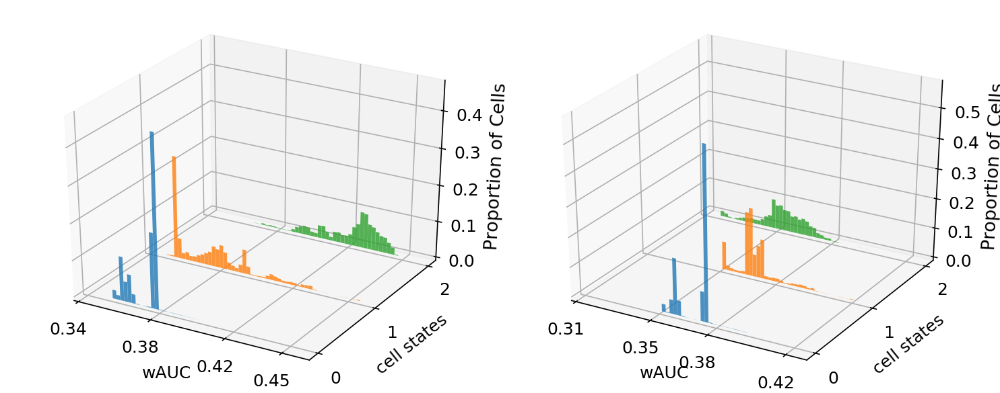

Cebpa


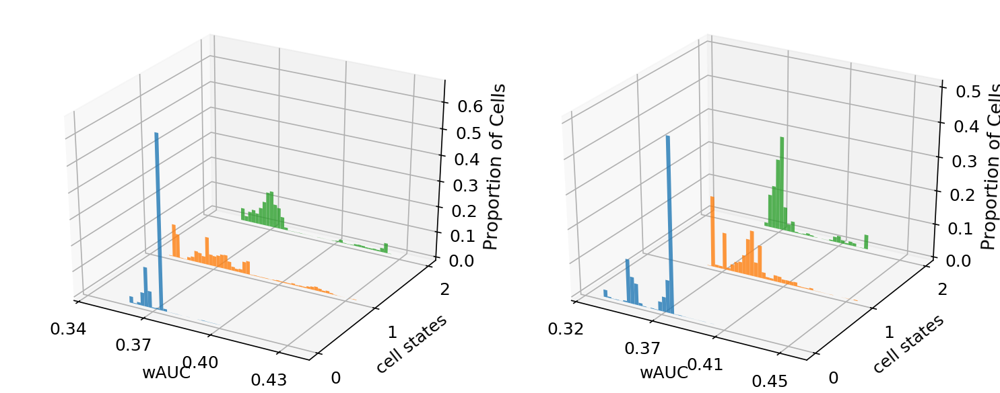

Jund


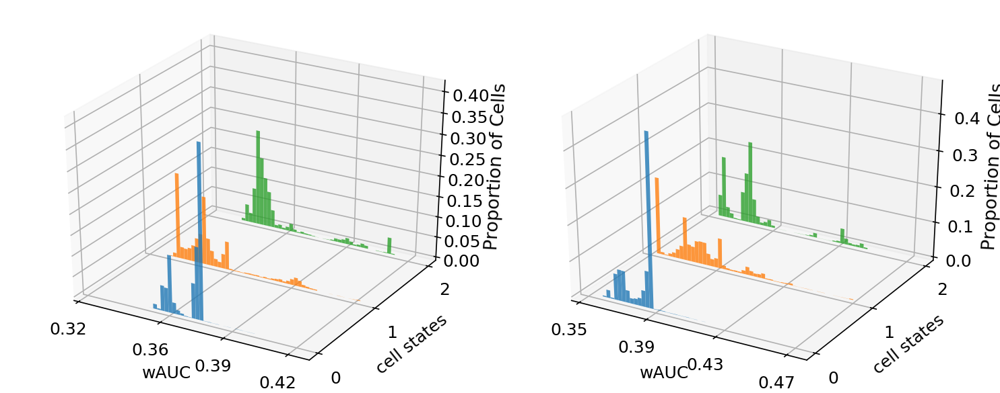

Cebpb


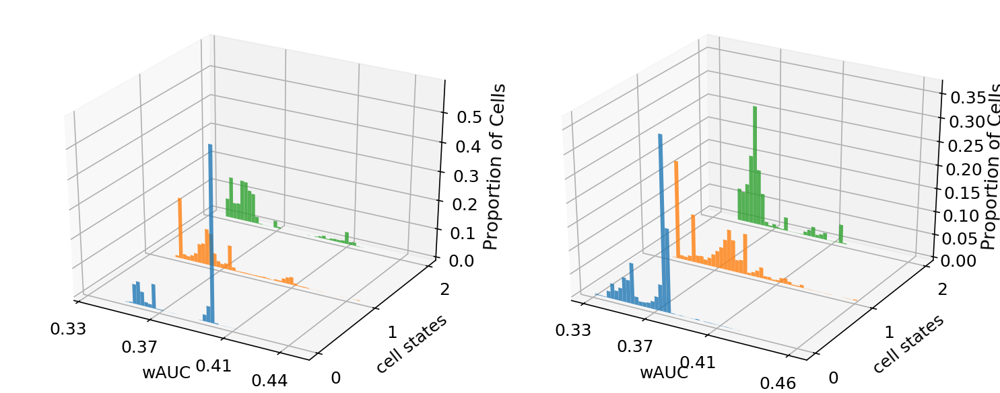

In [107]:
test_list = [x.capitalize() for x in {'YBX1', 'CEBPA', 'CEBPB', 'JUND', 'ID3', 'NCOR1',
                                                       'NR0B2'}]
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, test_list)

-----
# UMAP plot of imputed expression colorred in binarized AUC

In [69]:
import umap
%matplotlib inline

import pickle
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from functools import reduce
import numpy as np
import pandas as pd
import ipdb
import copy
import seaborn as sns

plt.rcParams['figure.dpi'] = 150

/home/jianhao2/miniconda3/envs/conda3_py/lib/python3.6/site-packages/sklearn/externals/joblib/__init__.py:15: FutureWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=FutureWarning)


In [71]:
p2df = '/data/jianhao/hepatocyte_update_dataset_101619/magic_cell_mat_w_label_pd'
# p2assign = '/data/jianhao/hepatocyte_update_dataset_101619/hepa_A249P_assign'

# assignment = []
# with open(p2assign, 'r') as f:
#     for line in f:
#         assignment.append(int(line))

df = pd.read_pickle(p2df)
df = df.drop(columns = ['label'])
# df

In [72]:
set(assign_list)

{0, 1, 2}

In [73]:
reducer = umap.UMAP(random_state= 42)
embedding = reducer.fit_transform(df.values)
print(embedding.shape)

/home/jianhao2/miniconda3/envs/conda3_py/lib/python3.6/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 4 separate connected components using meta-embedding (experimental)
  n_components


(18272, 2)


In [74]:
len(assign_list)

18272

In [75]:
def umap_plot(embedding, assignment, title, n_states = None, cmap_name = 'Spectral'):
    if n_states == None:
        n_states = len(set(assignment))
    plt.figure(figsize = (4, 3))
    scatter = plt.scatter(embedding[:, 0], embedding[:, 1], c=assignment, 
                          cmap = plt.get_cmap(cmap_name), s = 5)
    plt.colorbar(boundaries=np.arange(n_states + 1) - 0.5).set_ticks(np.arange(n_states))
    plt.title(title)
    
    plt.grid(alpha = 0.5)
    plt.show()

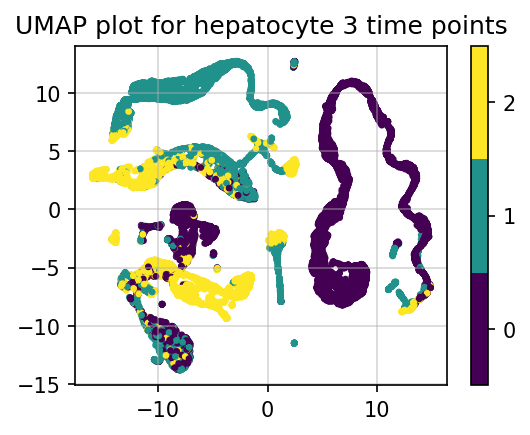

In [78]:
# On Mar-16-2020
umap_plot(embedding, assign_list, 'UMAP plot for hepatocyte 3 time points', cmap_name = 'viridis')

# UMAP plots with RAW/Binarized AUC value for each cell

In [79]:
selected_gene = 'Nfib'
# selected_gene = 'Nono'

In [80]:
def four_plots_together(embedding, df, assign_list, gene_name, cmap_name = 'viridis'):
#     if n_states == None:
#         n_states = len(set(assignment))
    fig, axs = plt.subplots(2, 2, sharex = True, sharey = True, figsize = (6, 5))
    normalize = colors.Normalize(vmin = 0, vmax=1)
    
    # plot of true label.
    ax = axs[0, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=assign_list,
                          cmap = plt.get_cmap(cmap_name), 
                          s = 3, alpha = 0.6)
    n_states = len(set(assign_list))
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP of expression for {} states'.format(n_states)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False)
    
    # plot of normalized raw AUC value.
    ax = axs[0, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized)'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value.
    ax = axs[1, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar un-norm)'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of binarized AUC value.
    ax = axs[1, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['bin_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    n_states = 2
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP labeled by binarized AUC value \n of gene {}'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    plt.show()

Nfib


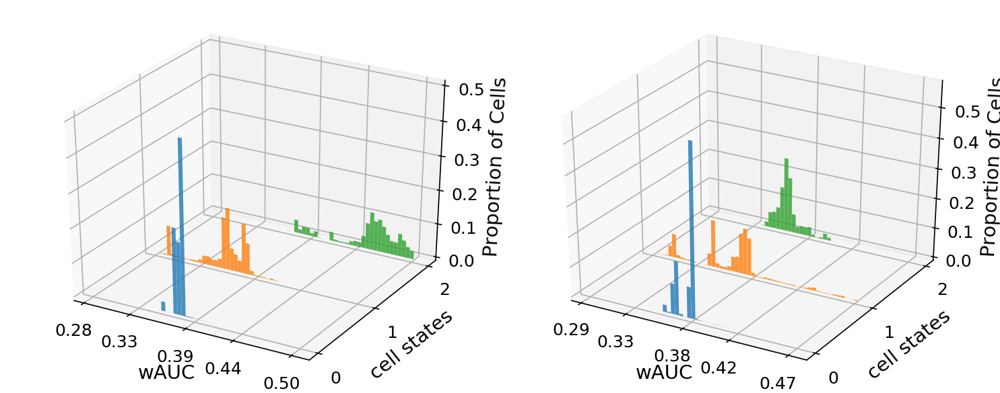

In [81]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, [selected_gene])

## Results for simic

In [82]:
with open(p2AUC_dict_simic, 'rb') as f:
    AUC_dict_simic = pickle.load(f)
    AUC_dict_simic = separate_state(AUC_dict_simic)
AUC_dict_simic.keys()

dict_keys([0, 1, 2])

In [83]:
threshold = 0.4
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_simic.keys():
#     AUC_dict_simic[0].keys()
    binarized_label = (AUC_dict_simic[state][selected_gene.capitalize()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_simic[state][selected_gene.capitalize()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['raw_label'] = total_raw_label

## Results for no simic

In [84]:
with open(p2AUC_dict_no_simic, 'rb') as f:
    AUC_dict_no_simic = pickle.load(f)
    AUC_dict_no_simic = separate_state(AUC_dict_no_simic)
AUC_dict_no_simic.keys()

dict_keys([0, 1, 2])

In [85]:
threshold = 0.375
# umap_plot(embedding, assign_list, 'UMAP plot for hepatocyte 5 time points')
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_no_simic.keys():
#     AUC_dict_simic[0].keys()
    binarized_label = (AUC_dict_no_simic[state][selected_gene.capitalize()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_no_simic[state][selected_gene.capitalize()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['raw_label'] = total_raw_label

# Side by side comparison of simic & no-simic

In [86]:
def side_by_side_cmp(embedding, df, assign_list, gene_name, cmap_name = 'summer'):
#     if n_states == None:
#         n_states = len(set(assignment))
    fig, axs = plt.subplots(4, 2, sharex = True, sharey = True, figsize = (6, 10))
    normalize = colors.Normalize(vmin = 0, vmax=1)
    
    # plot of true label.
    ax = axs[0, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=assign_list,
                          cmap = plt.get_cmap(cmap_name), 
                          s = 3, alpha = 0.6)
    n_states = len(set(assign_list))
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP of expression for {} states'.format(n_states)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False)
    axs[0, 1].axis('off')
    
    # plot of normalized raw AUC value.
    ax = axs[1, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['simic_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized) - simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value - no simic.
    ax = axs[1, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['no_simic_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized) - NO simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value.
    ax = axs[2, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['simic_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar un-norm) - simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of normalized raw AUC value - no simic.
    ax = axs[2, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['no_simic_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar un-norm) - NO simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of binarized AUC value.
    ax = axs[3, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['simic_bin_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    n_states = 2
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP labeled by binarized AUC value \n of gene {} - simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of binarized AUC value - no simic.
    ax = axs[3, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['no_simic_bin_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    n_states = 2
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP labeled by binarized AUC value \n of gene {} - NO simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    plt.show()

In [87]:
# --- simic
threshold = 0.4
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_simic.keys():
    binarized_label = (AUC_dict_simic[state][selected_gene.capitalize()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_simic[state][selected_gene.capitalize()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['simic_bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['simic_raw_label'] = total_raw_label

# --- no simic
threshold = 0.375
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_no_simic.keys():
    binarized_label = (AUC_dict_no_simic[state][selected_gene.capitalize()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_no_simic[state][selected_gene.capitalize()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['no_simic_bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['no_simic_raw_label'] = total_raw_label

# UMAP plots for all TFs

In [96]:
def intersect_vs_all(embedding, df, assign_list, AUC_dict_simic, AUC_dict_no_simic, gene_name, cmap_name = 'summer'):
    # --- simic
#     threshold = 0.07
#     state_label_list = []
    raw_AUC_list = []
    for state in AUC_dict_simic.keys():
#         binarized_label = (AUC_dict_simic[state][gene_name.upper()] > threshold).astype(int)
#         state_label_list.append(binarized_label)
        raw_AUC_list.append(AUC_dict_simic[state][gene_name.capitalize()])

    total_raw_label = pd.concat(raw_AUC_list)
    df['inter_raw_label'] = total_raw_label

    # --- no simic
#     threshold = 0.36
#     state_label_list = []
    raw_AUC_list = []
    for state in AUC_dict_no_simic.keys():
#         binarized_label = (AUC_dict_no_simic[state][gene_name.upper()] > threshold).astype(int)
#         state_label_list.append(binarized_label)
        raw_AUC_list.append(AUC_dict_no_simic[state][gene_name.capitalize()])

    total_raw_label = pd.concat(raw_AUC_list)
    df['all_raw_label'] = total_raw_label


#     if n_states == None:
#         n_states = len(set(assignment))
    fig, axs = plt.subplots(1, 2, sharex = True, sharey = True, figsize = (6, 2))
    normalize = colors.Normalize(vmin = 0, vmax=1)
    
#     # plot of true label.
#     ax = axs[0, 0]
#     im = ax.scatter(embedding[:, 0], embedding[:, 1], c=assign_list,
#                           cmap = plt.get_cmap(cmap_name), 
#                           s = 3, alpha = 0.6)
#     n_states = len(set(assign_list))
#     cb = fig.colorbar(im, ax = ax,
#                      boundaries=np.arange(n_states + 1) - 0.5)
#     cb.set_ticks(np.arange(n_states))
#     title = 'UMAP of expression for {} states'.format(n_states)
#     ax.set_title(title, fontsize = 6)
#     ax.grid(alpha = 0.5)
#     ax.tick_params(axis = 'both', which = 'both', labelleft = False)
#     axs[0, 1].axis('off')
    
    # plot of normalized raw AUC value.
    ax = axs[0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['inter_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized) - simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value - no simic.
    ax = axs[1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['all_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized) - LASSO'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    print('-' * 7)
    print(gene_name)
    
    plt.show()
#     df.drop('inter_raw_label')
#     df.drop('all_raw_label')

In [94]:
top_only_simic_3_states = {'Foxp1', 'Peg3', 'Bhlhe40', 'Ahr', 'Tsc22d1', 'Foxn3', 'Mier1', 'Zfp91', 'Klf13', 'Klf15', 'Foxa3', 'Nono', 'Nr0b2', 'Nfib', 'Smarca5'}
last_only_simic_3_states = {'Nr2f2', 'Nr1d2', 'Stat5b', 'Gzf1', 'Tox4', 'Tef', 'Zbtb7b', 'Sox9', 'Nfe2l1', 'Kdm2a', 'Cebpa', 'Nfkbia', 'Foxo3', 'Sall1', 'Zhx1', 'Sox5', 'Atf1', 'Rlf', 'Sp3', 'Onecut1', 'Tfdp1', 'Cux1', 'Klf12'}

TFs_that_changes_in_ranking = ['PHF5A', 'DBP', 'NFIA', 'TFDP2', 'ID3', 'YBX1']
union = {'ATF5',
 'CEBPA',
 'CEBPB',
 'CREB3L3',
 'DBP',
 'HHEX',
 'HNF4A',
 'ID2',
 'ID3',
 'JUND',
 'NFIA',
 'NR1I3',
 'PHF5A',
 'PPARA',
 'SREBF1',
 'TFDP2',
 'TSC22D1',
 'XBP1',
 'YBX1',
 'ZBTB20'}

-------
NCOA2


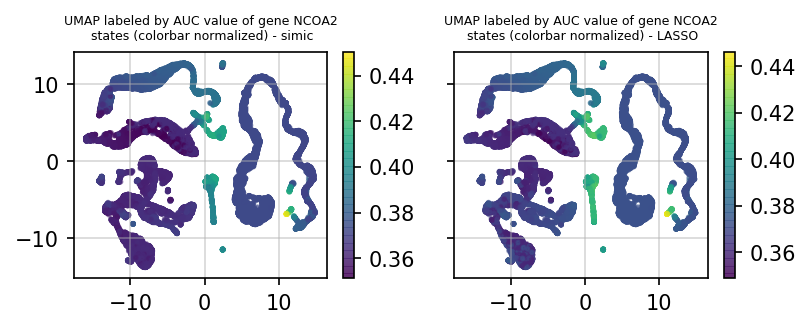

-------
STAT1


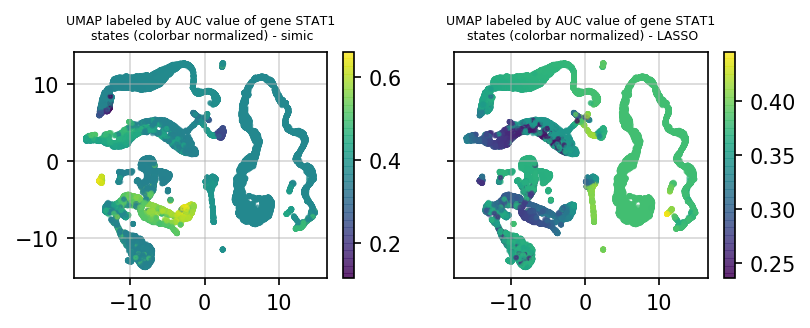

-------
LRRFIP1


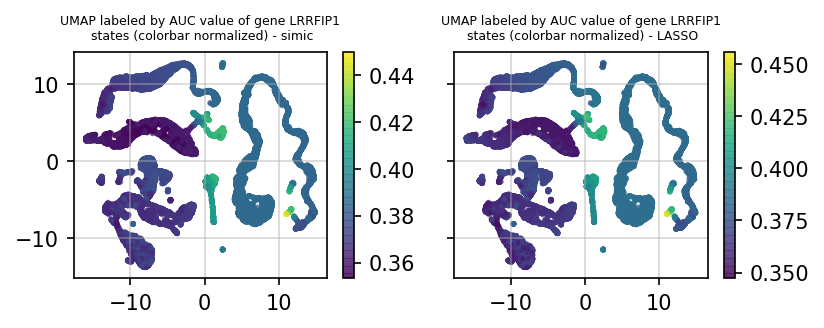

-------
HES6


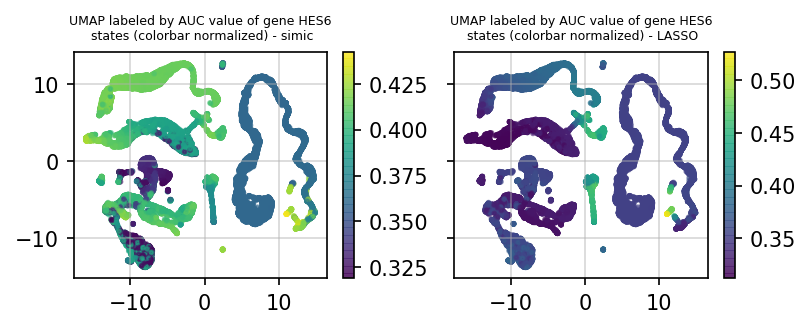

-------
ELK4


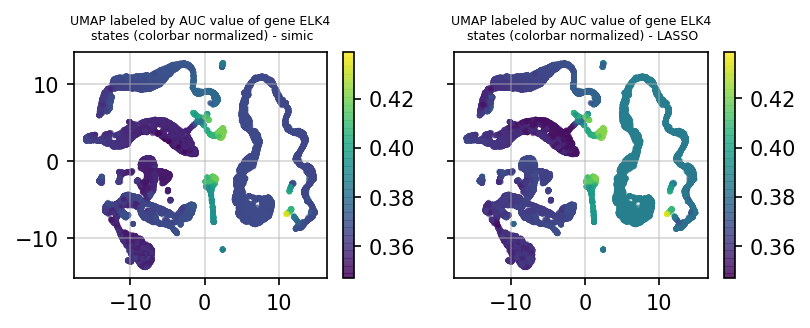

-------
NR5A2


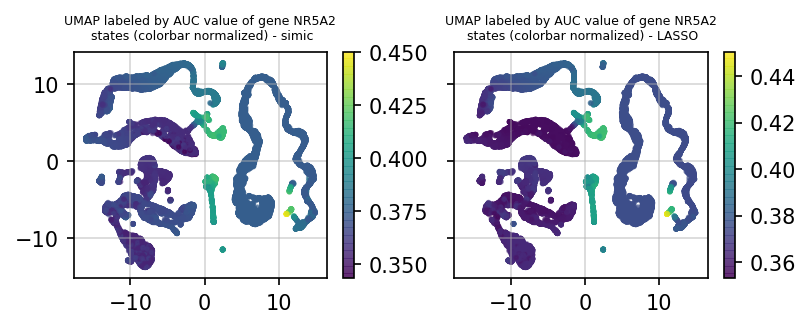

-------
ATF6


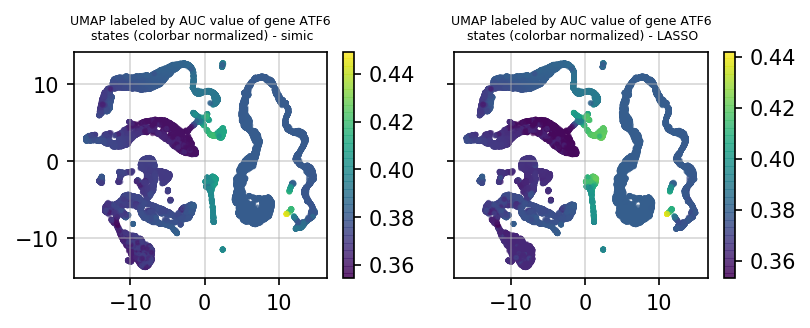

-------
NR1I3


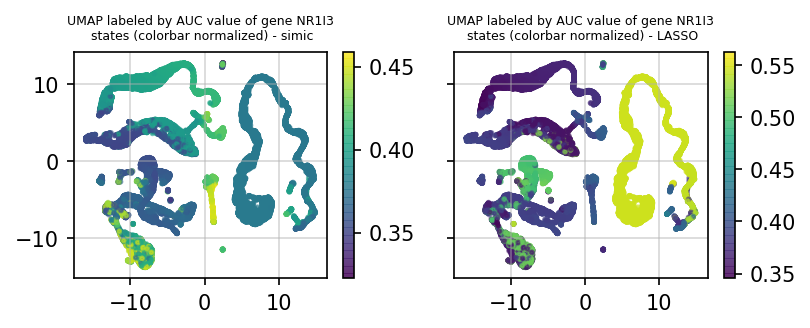

-------
PROX1


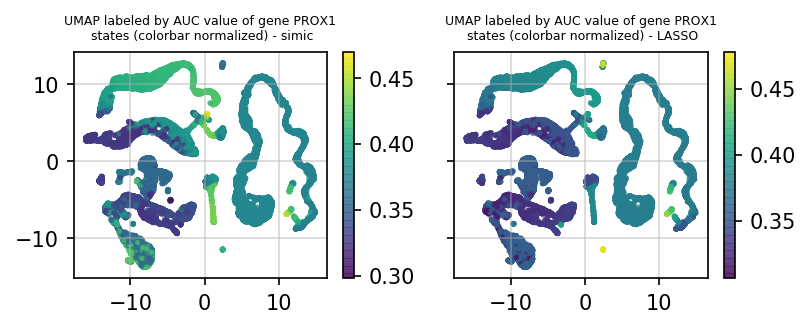

-------
IRF6


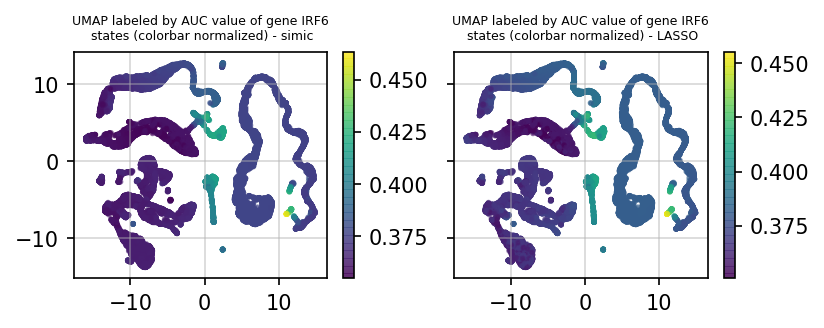

-------
DNAJC1


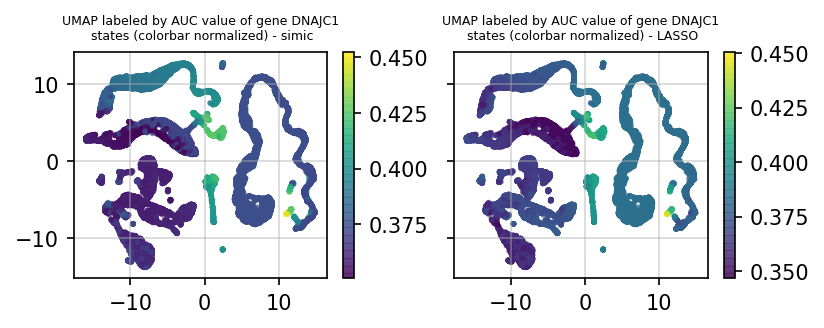

-------
RXRA


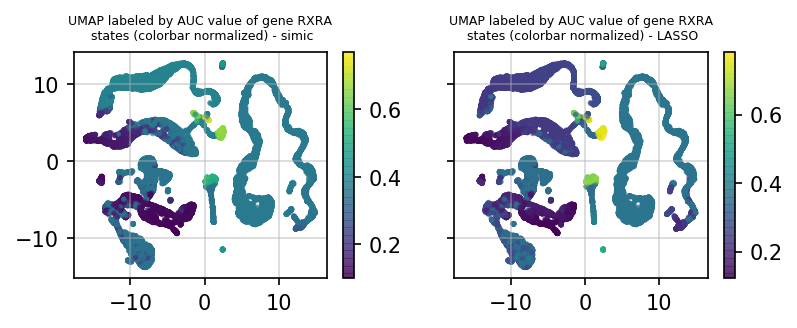

-------
RC3H2


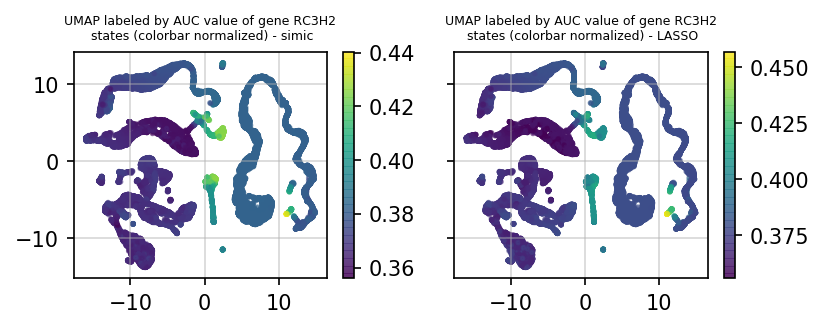

-------
SP3


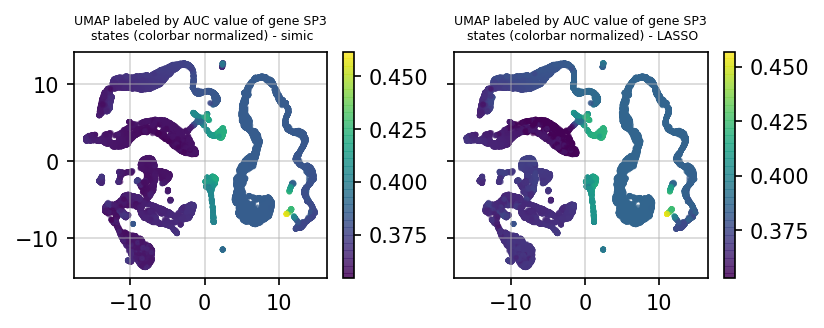

-------
ATF2


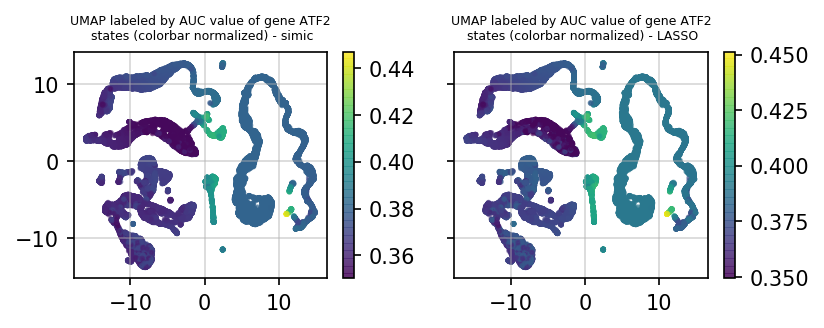

-------
NFE2L2


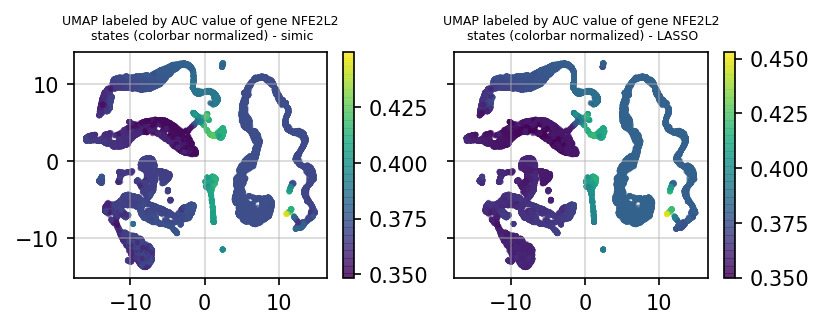

-------
SSRP1


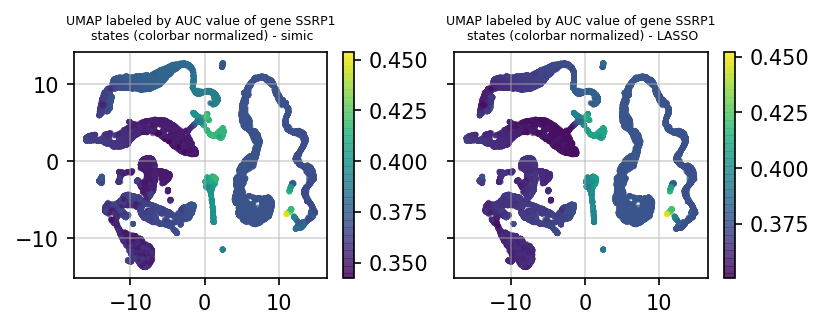

-------
NR1H3


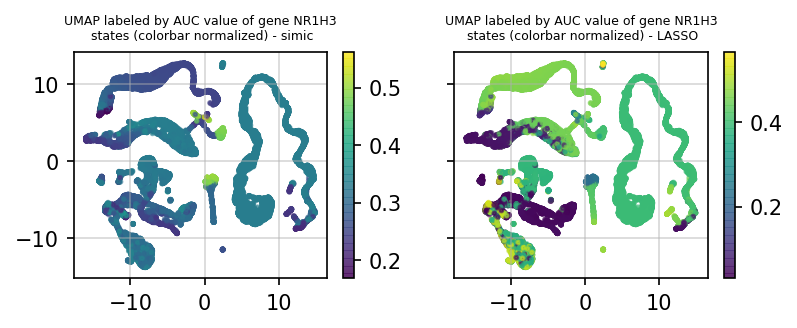

-------
MGA


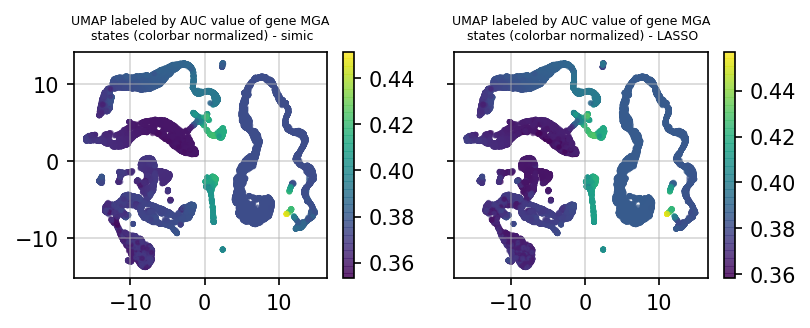

-------
FOXA2


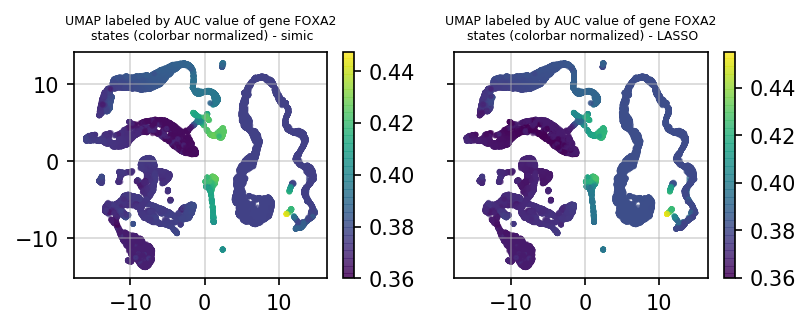

-------
GZF1


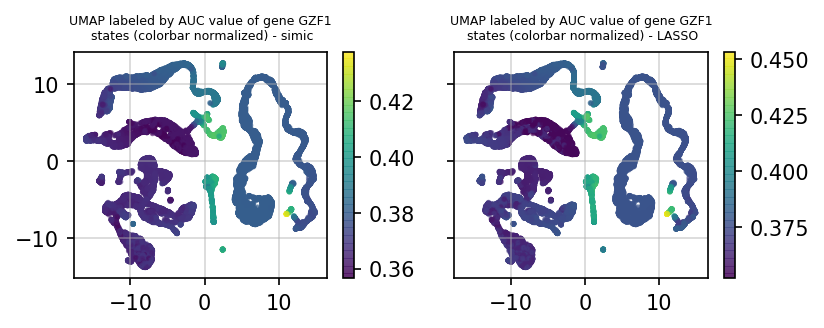

-------
ID1


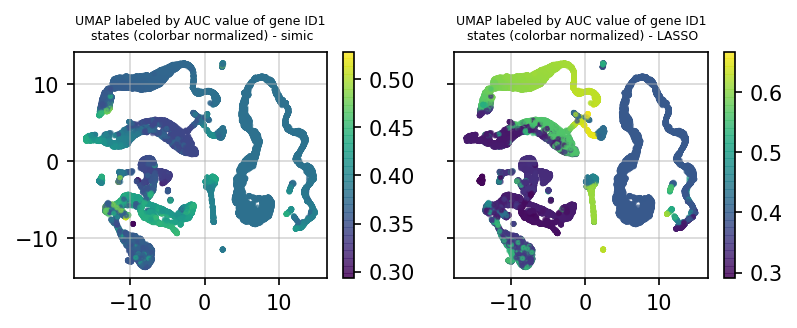

-------
E2F1


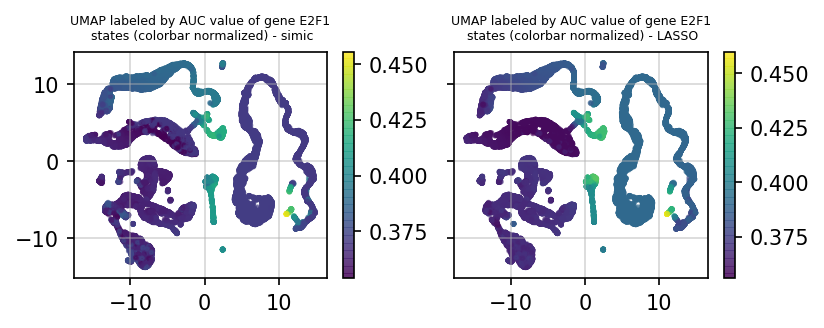

-------
MAFB


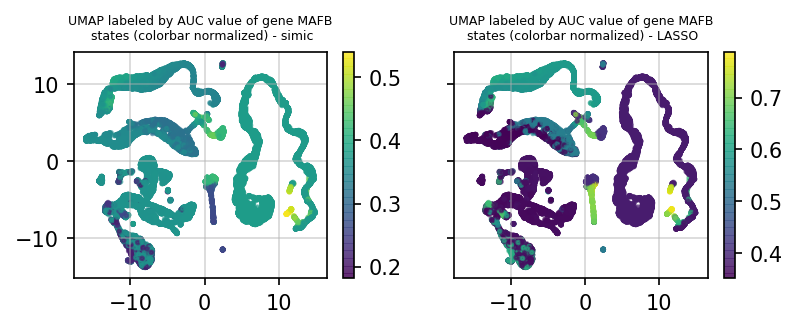

-------
ZHX3


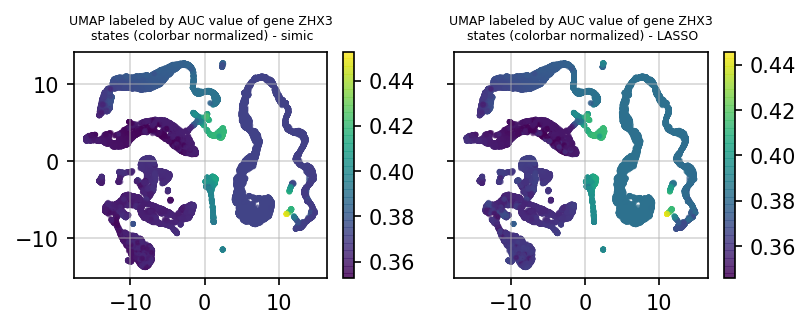

-------
HNF4A


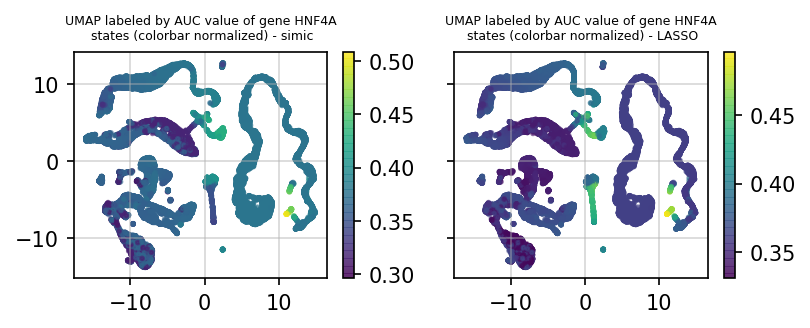

-------
CEBPB


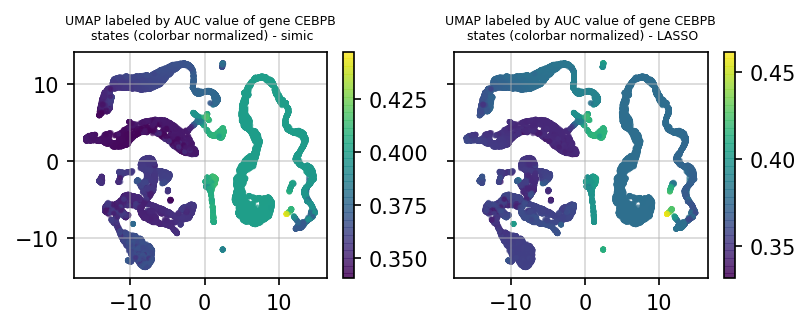

-------
TFE3


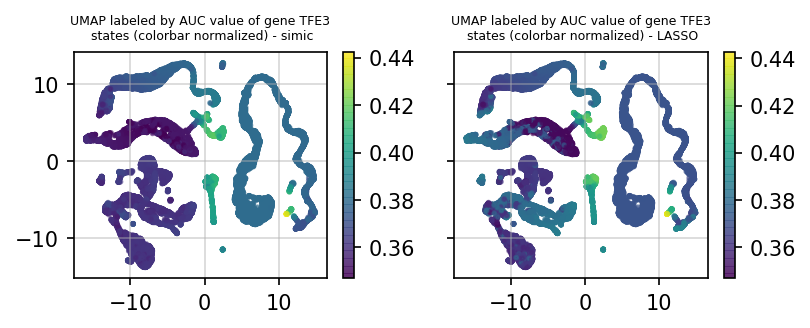

-------
ZBTB33


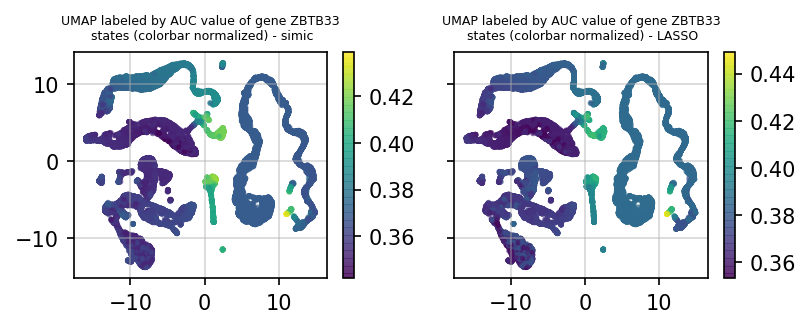

-------
NONO


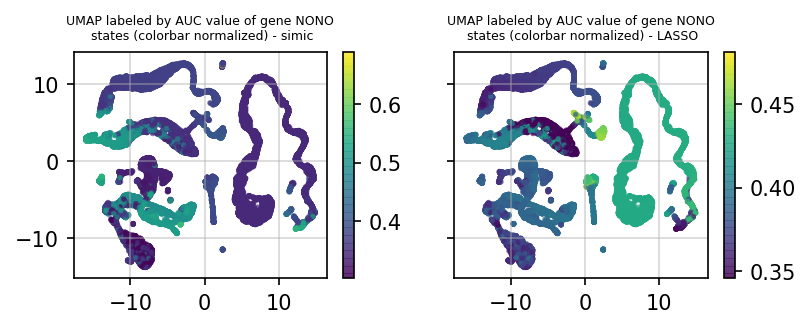

-------
ATRX


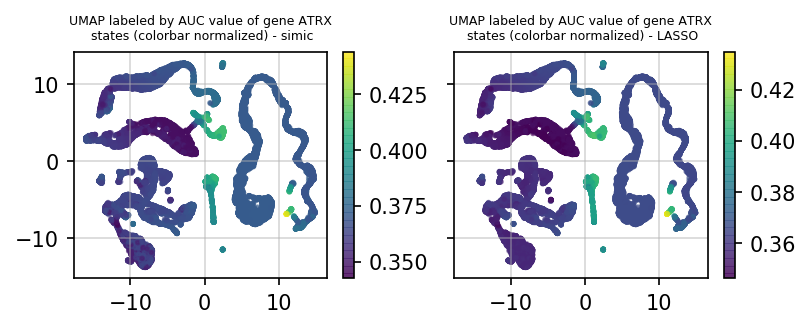

-------
TSC22D3


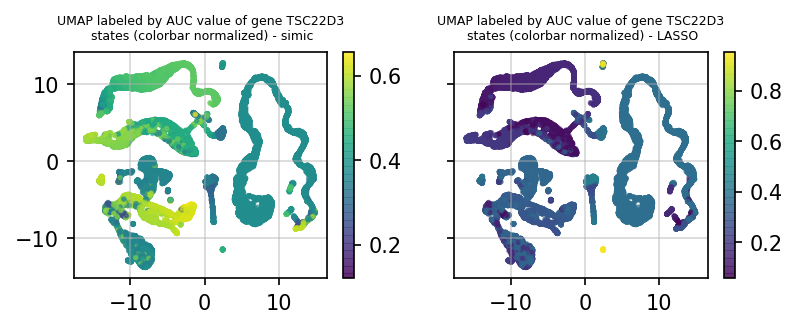

-------
FOXO1


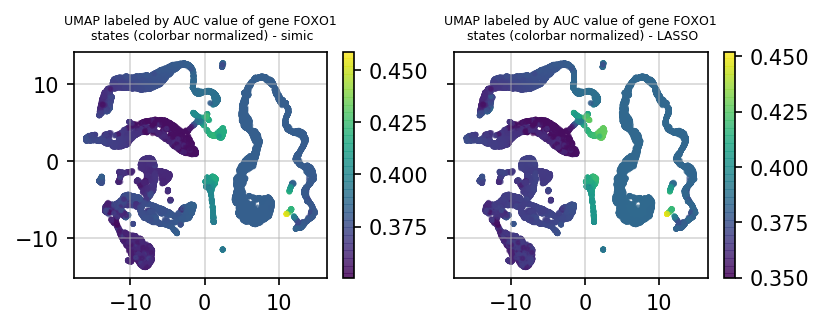

-------
RFXAP


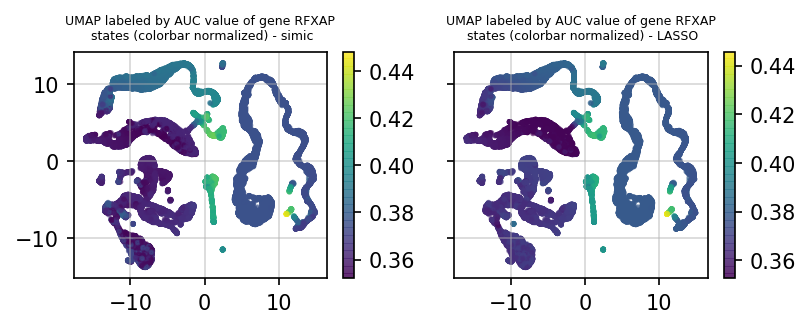

-------
TSC22D2


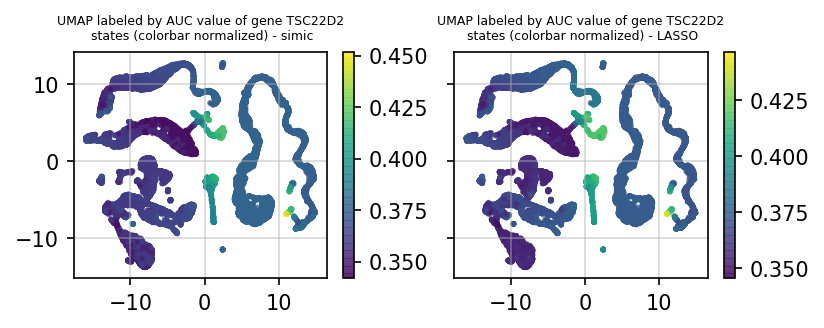

-------
ZBTB7B


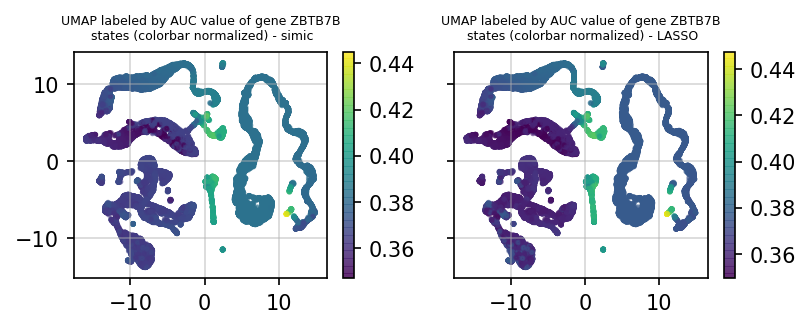

-------
GATAD2B


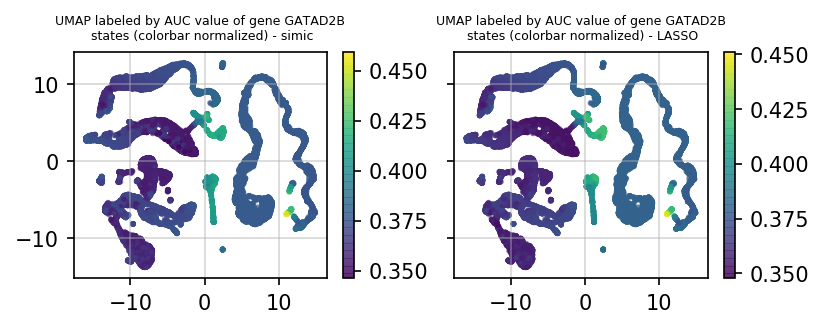

-------
NFX1


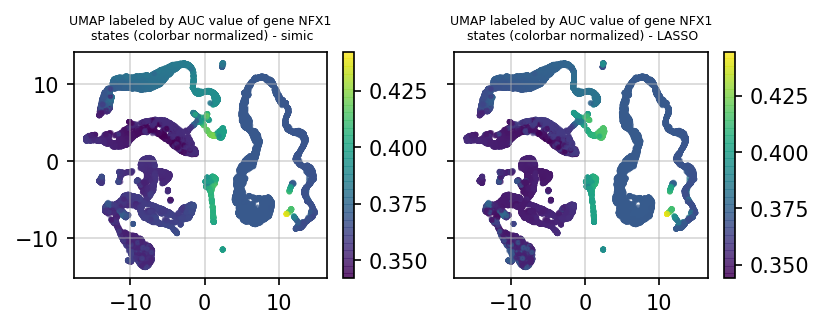

-------
NFIB


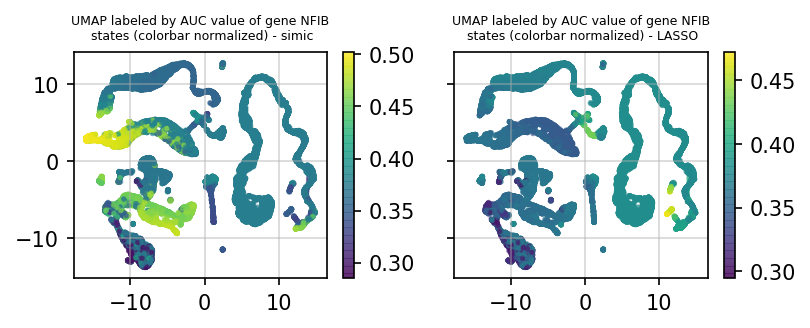

-------
JUN


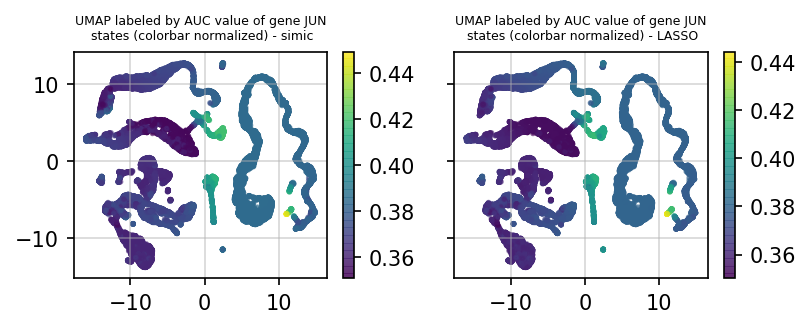

-------
NFIA


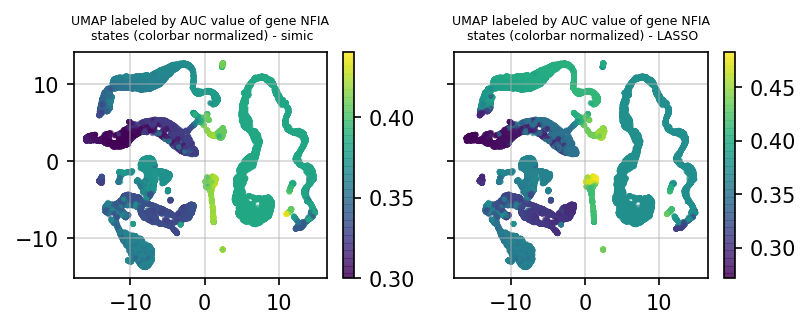

-------
MIER1


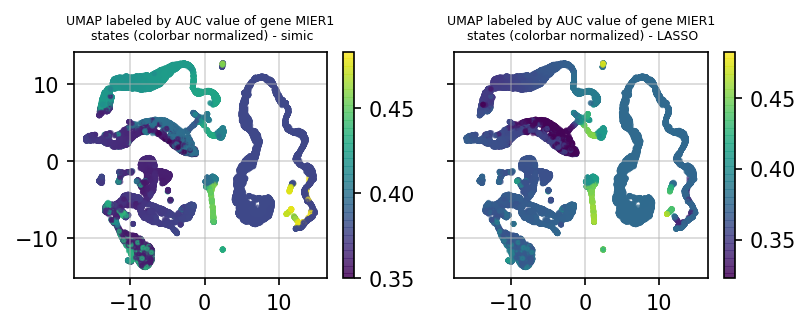

-------
YBX1


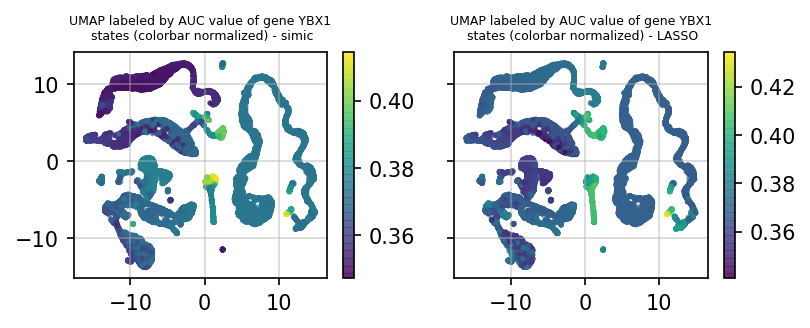

-------
RLF


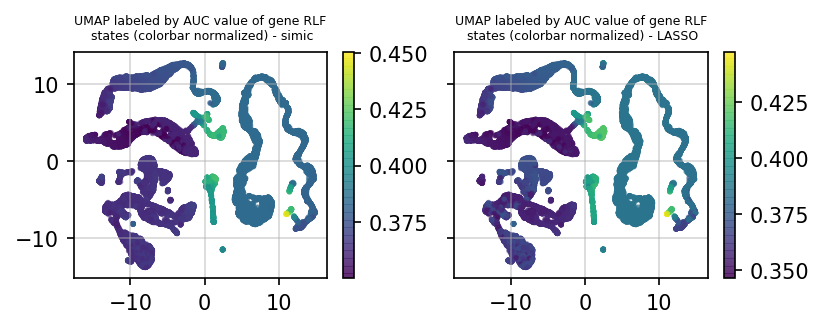

-------
SFPQ


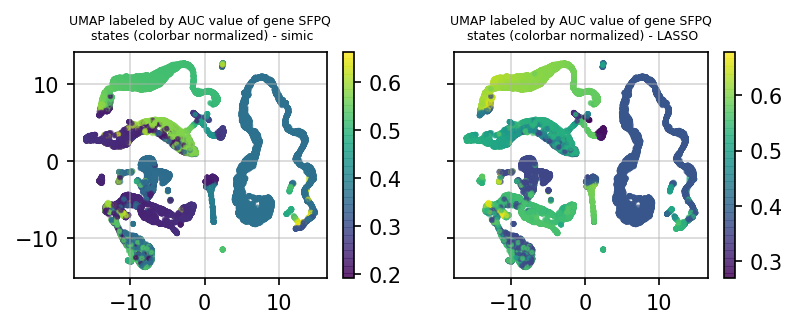

-------
NR0B2


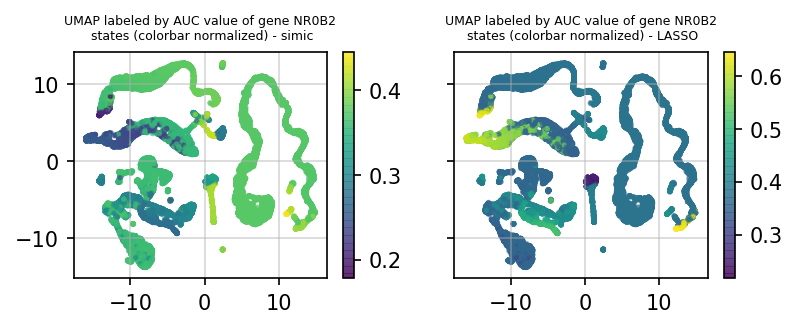

-------
ARID1A


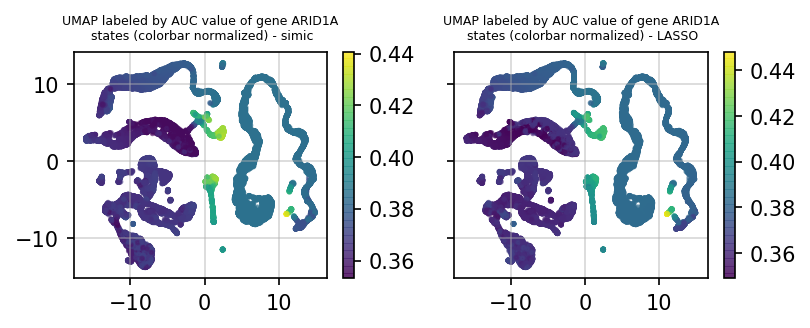

-------
ID3


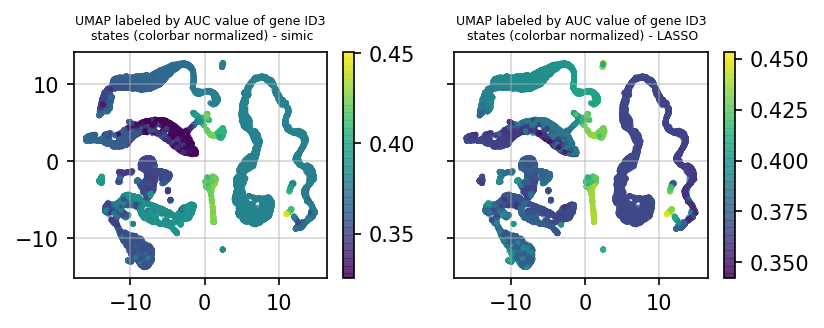

-------
RERE


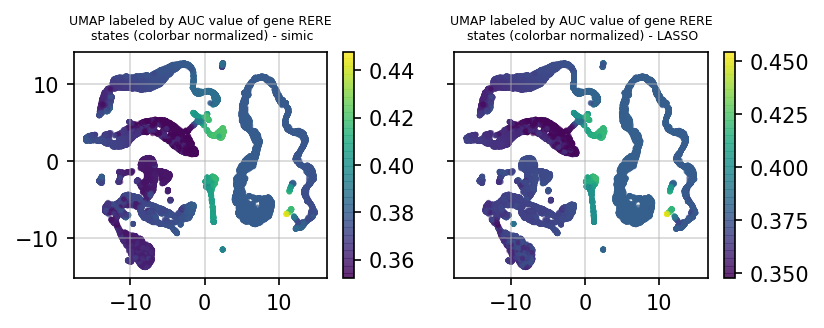

-------
GATAD1


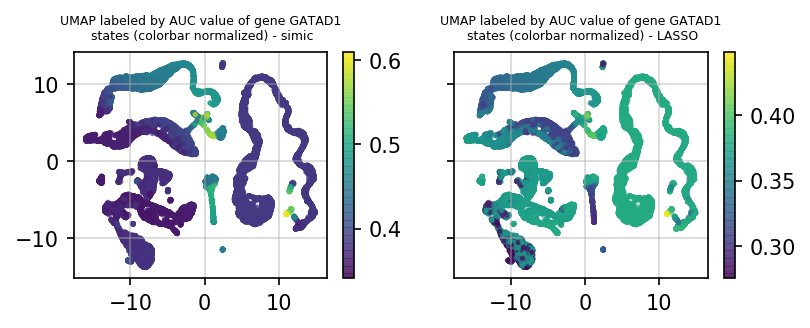

-------
DNAJC2


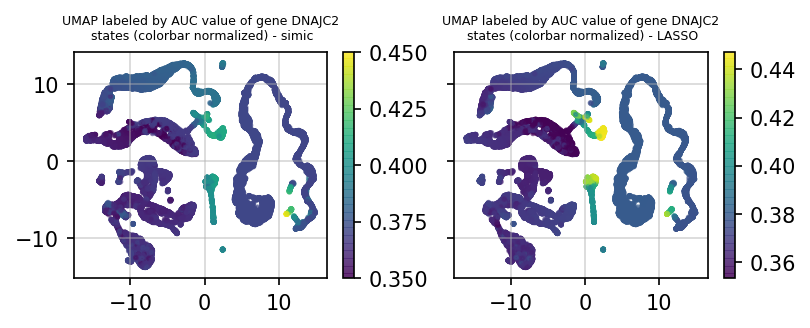

-------
MXD4


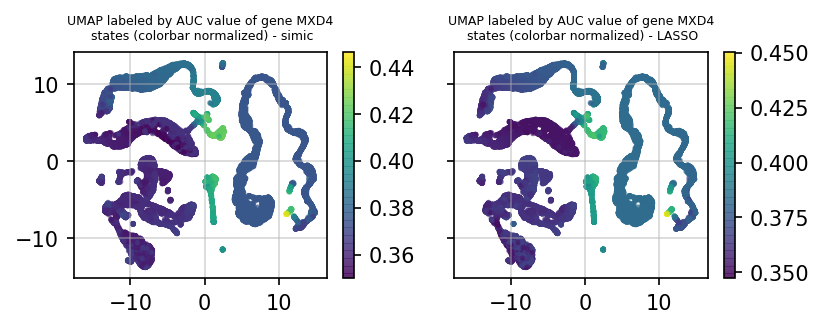

-------
LYAR


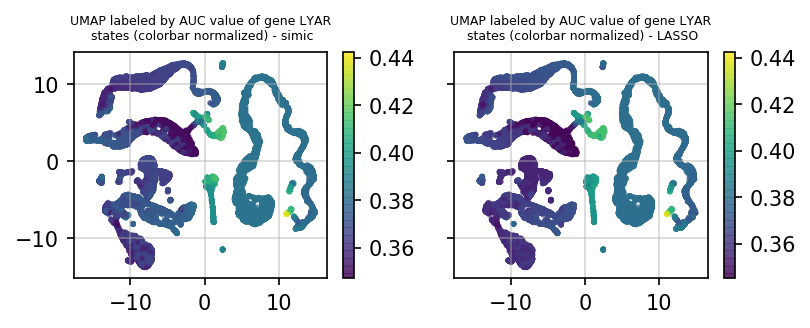

-------
KLF3


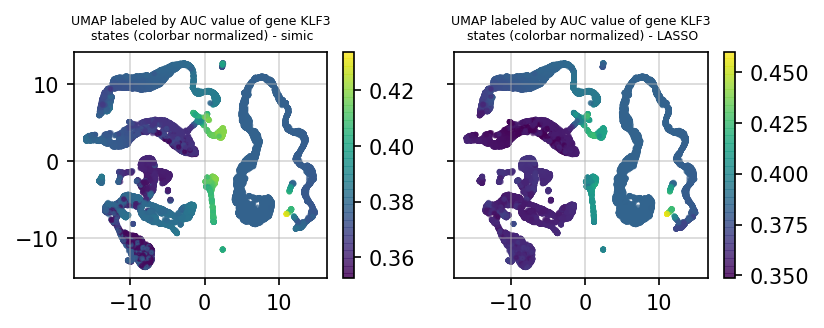

-------
CLOCK


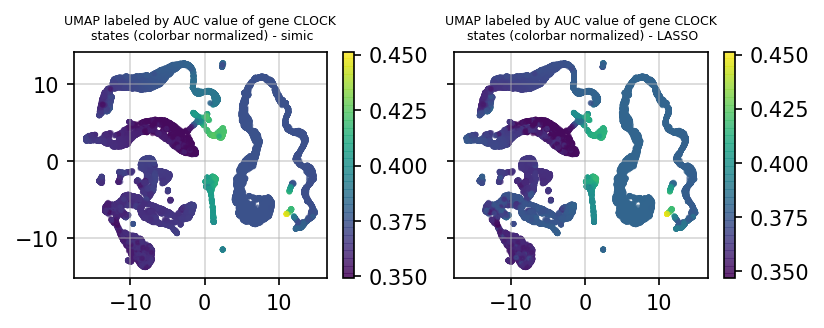

-------
HOPX


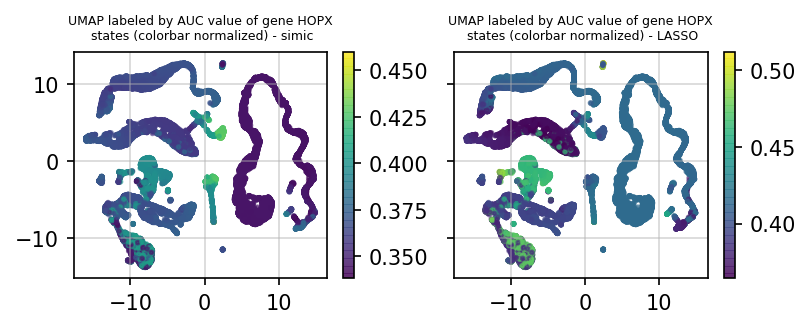

-------
REST


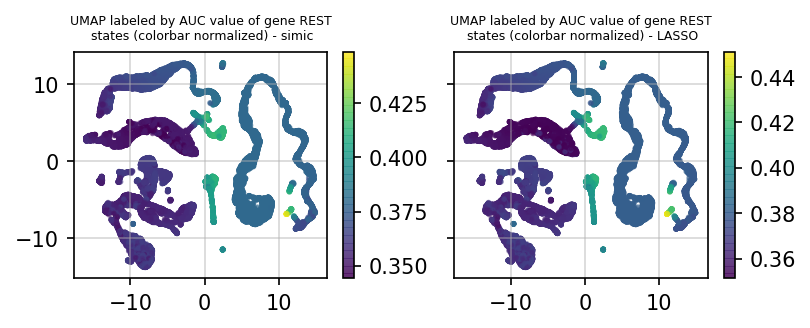

-------
TBX3


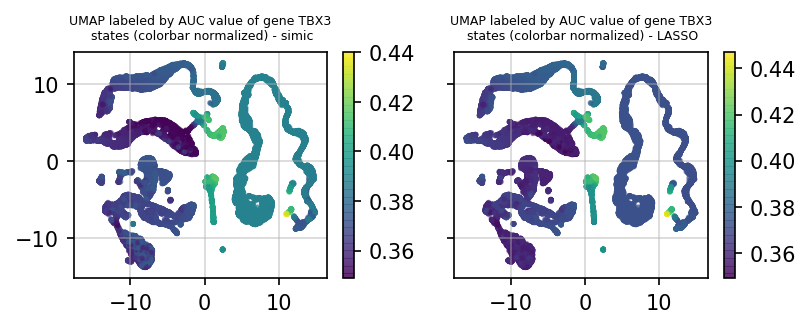

-------
CUX2


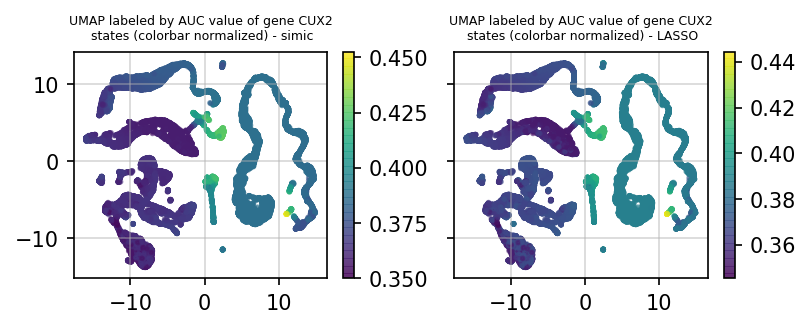

-------
MLXIPL


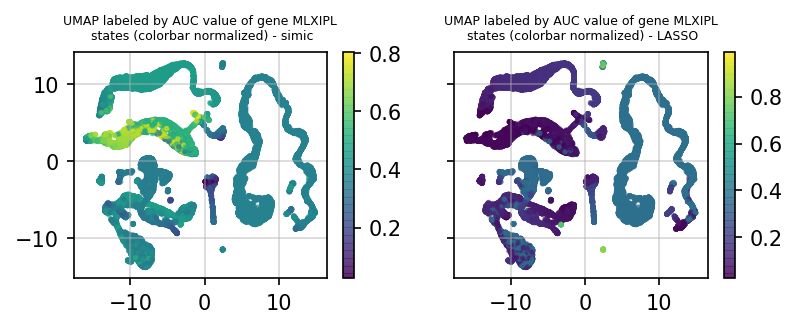

-------
CUX1


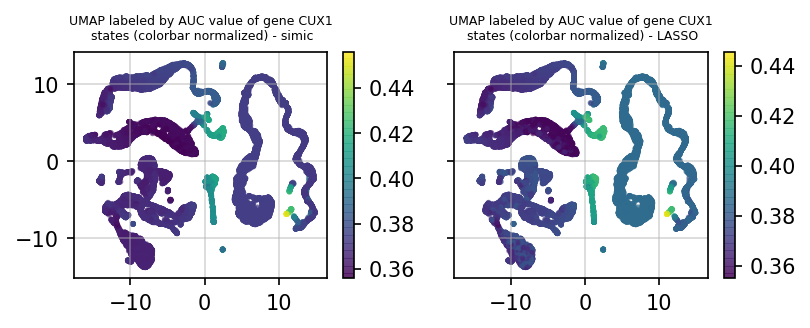

-------
ZKSCAN1


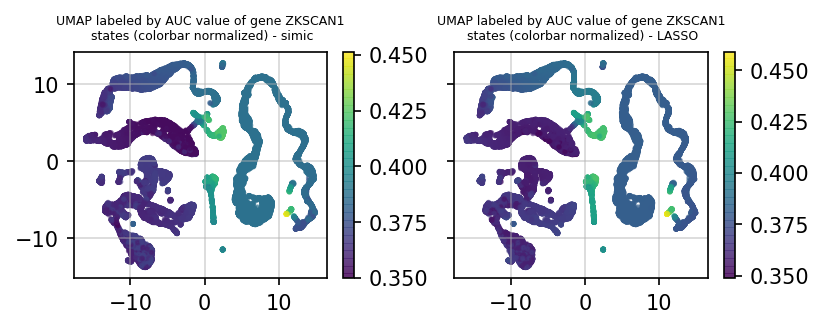

-------
GTF3A


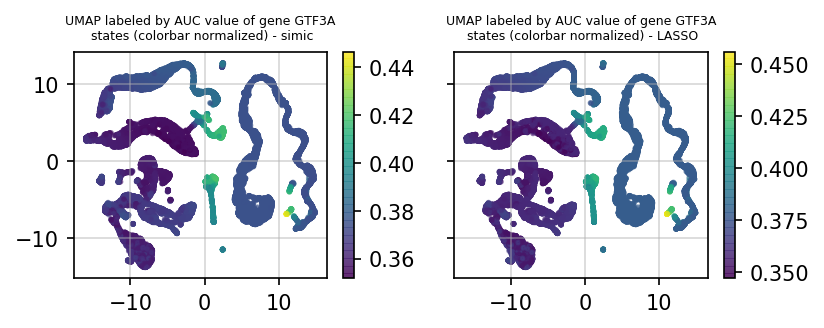

-------
CREB3L2


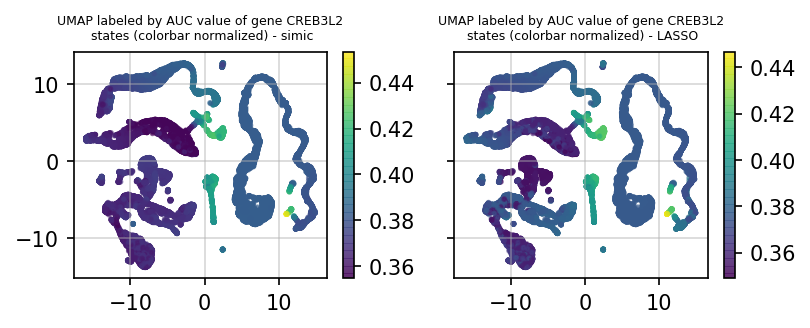

-------
KLF15


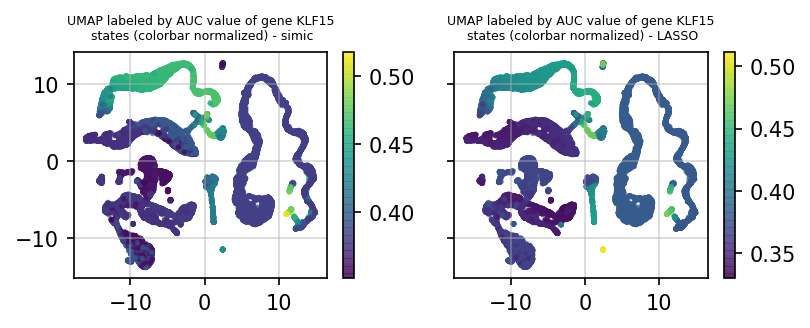

-------
FOXP1


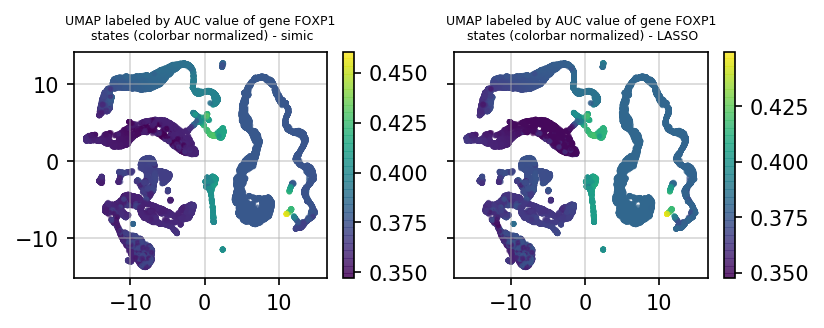

-------
BHLHE40


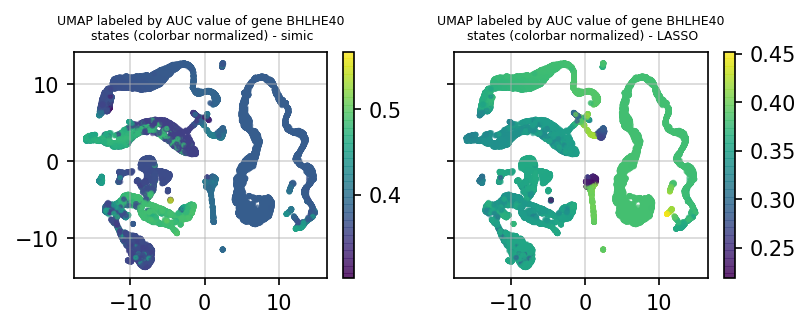

-------
ZFP637


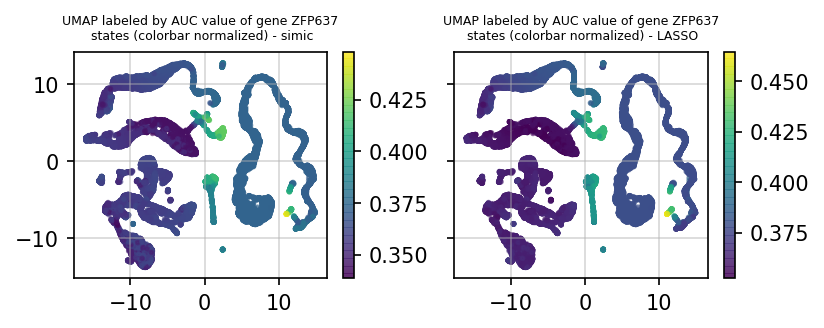

-------
KDM5A


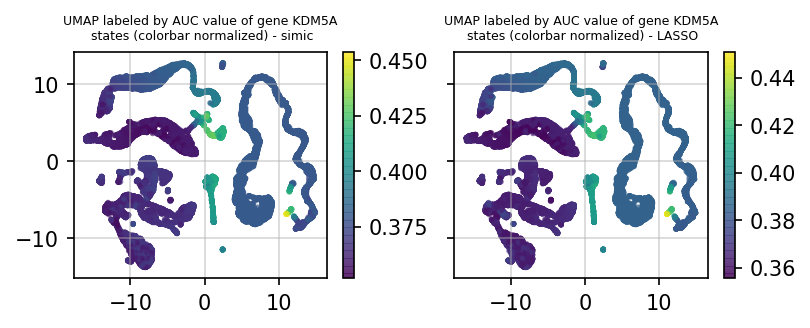

-------
YBX3


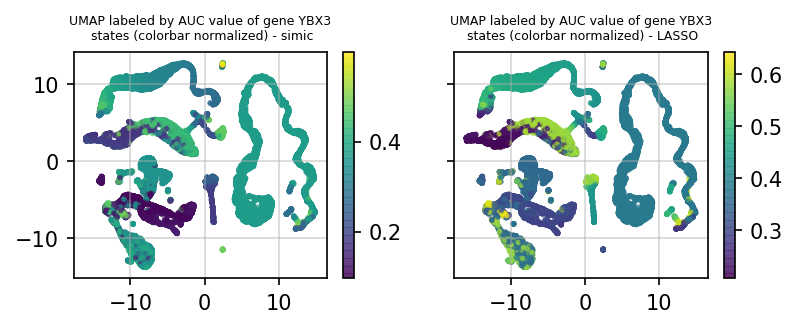

-------
CREBL2


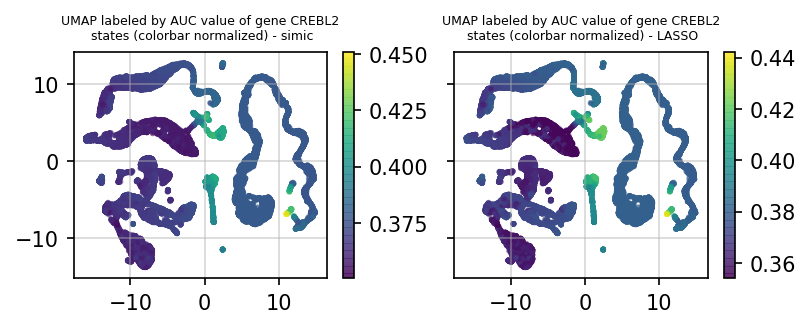

-------
AEBP2


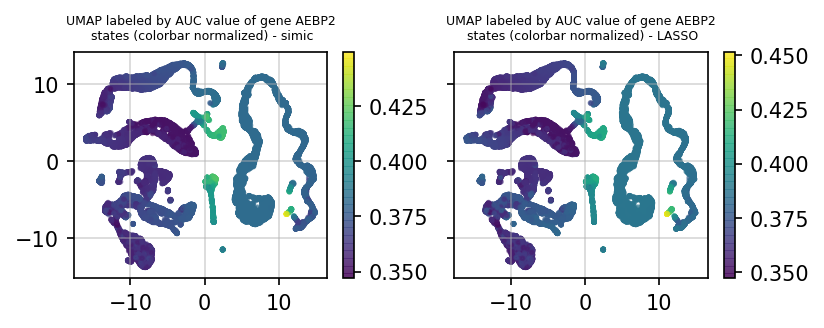

-------
SOX5


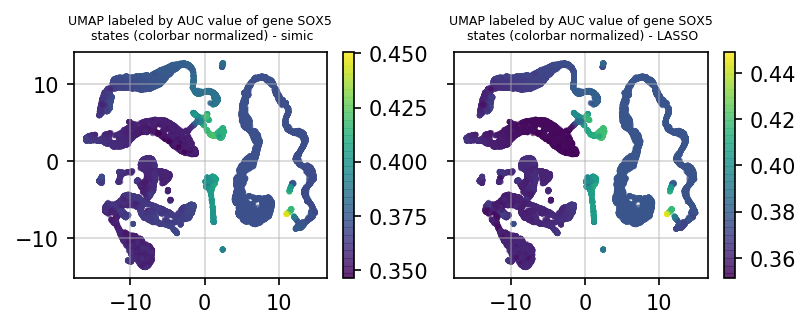

-------
PEG3


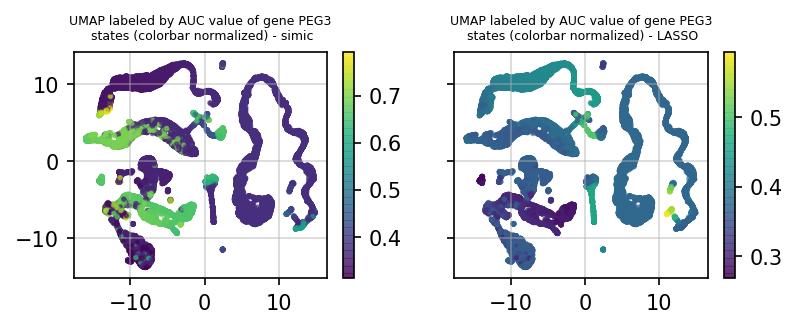

-------
FOXA3


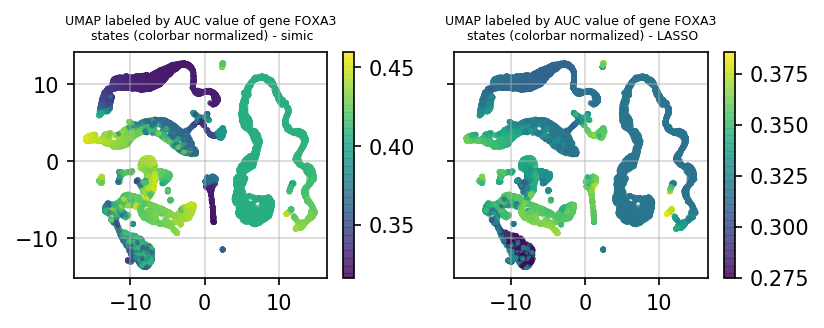

-------
BCL3


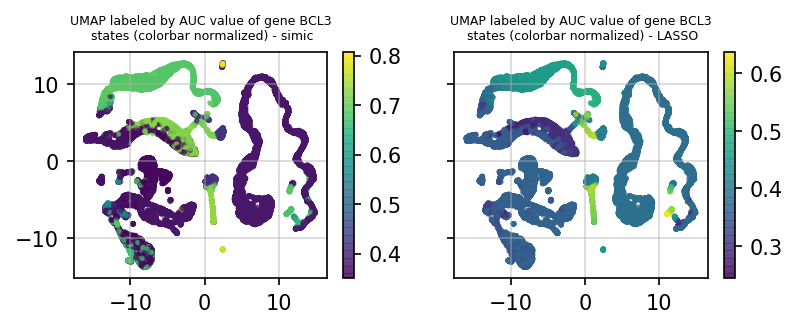

-------
NFKBIB


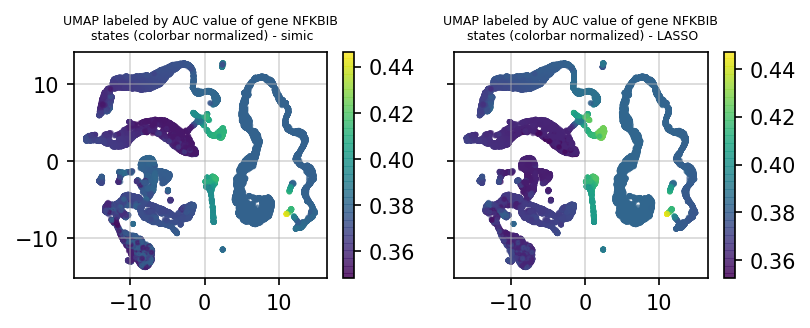

-------
USF2


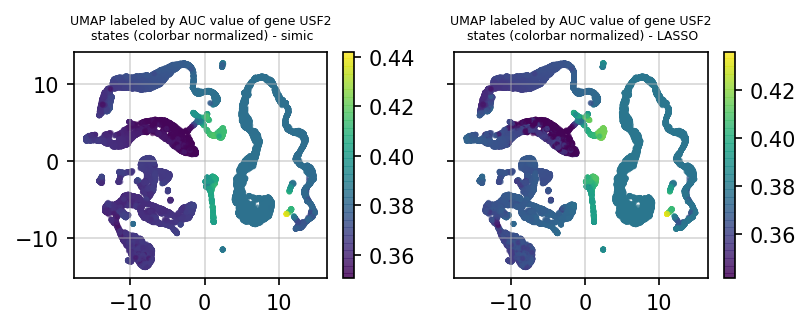

-------
CEBPG


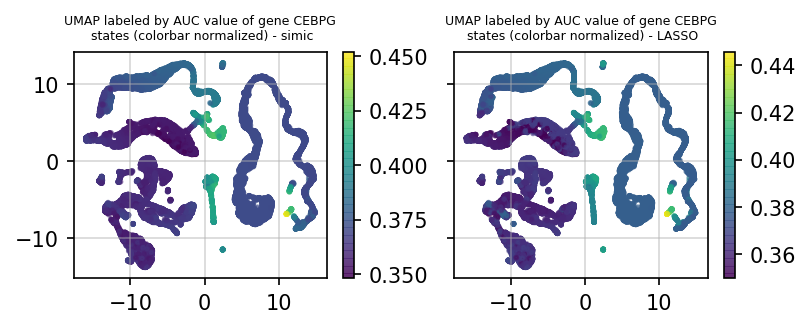

-------
CEBPA


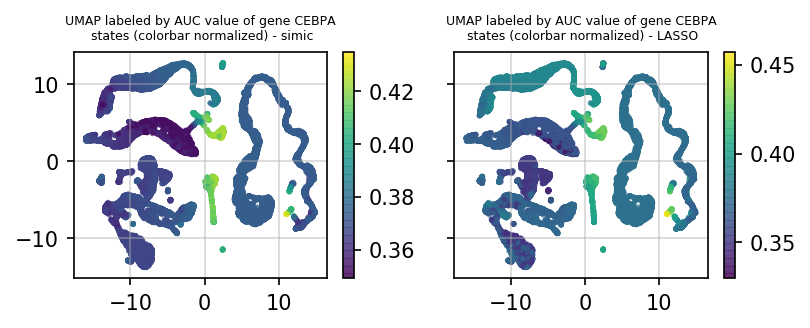

-------
ATF5


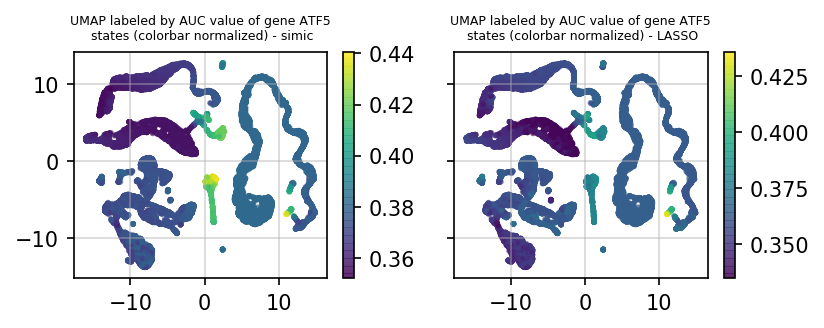

-------
IRF3


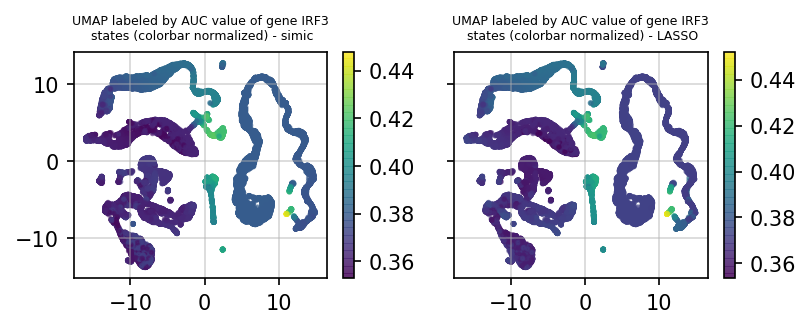

-------
DBP


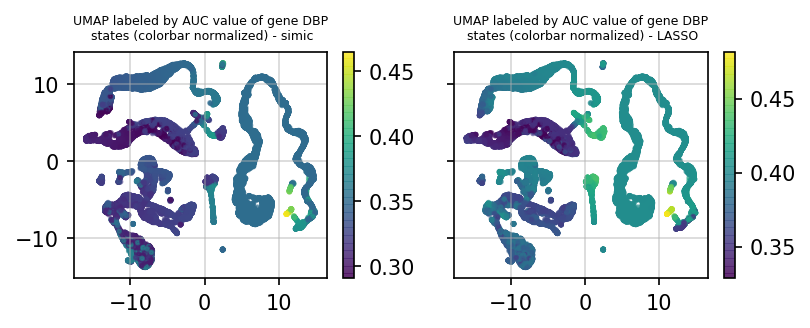

-------
KLF13


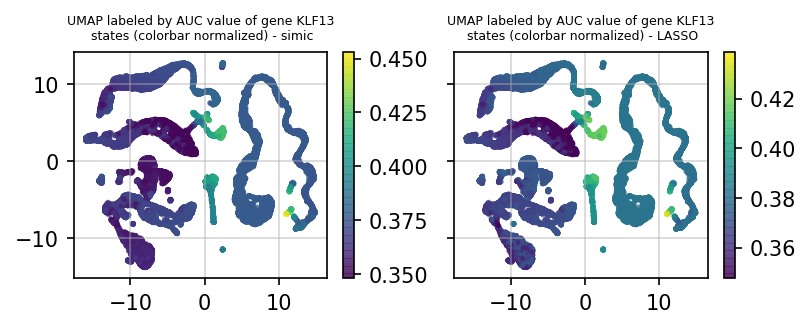

-------
MEF2A


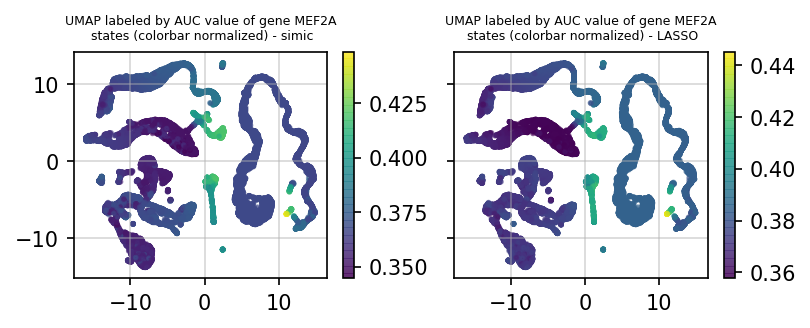

-------
NR2F2


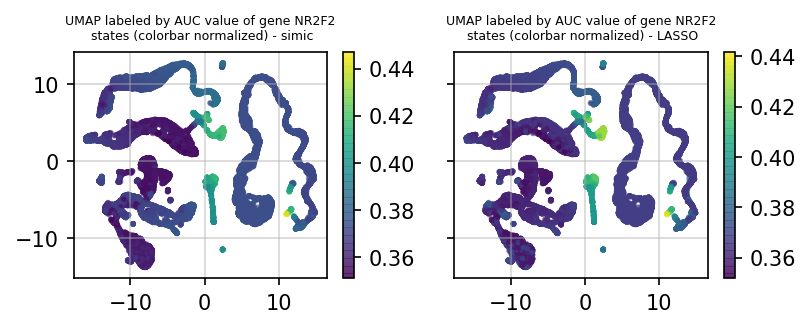

-------
MAZ


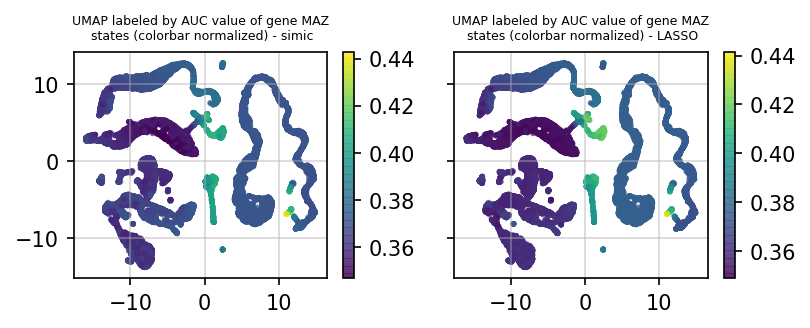

-------
IRF7


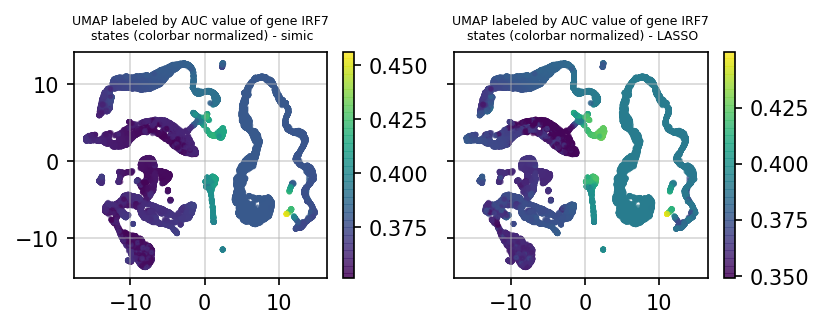

-------
FOXO3


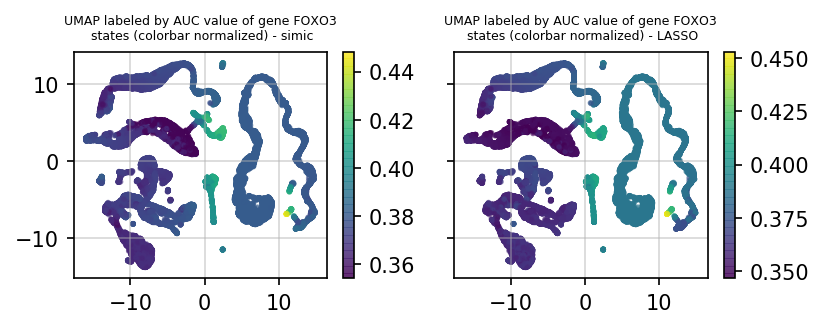

-------
HSF2


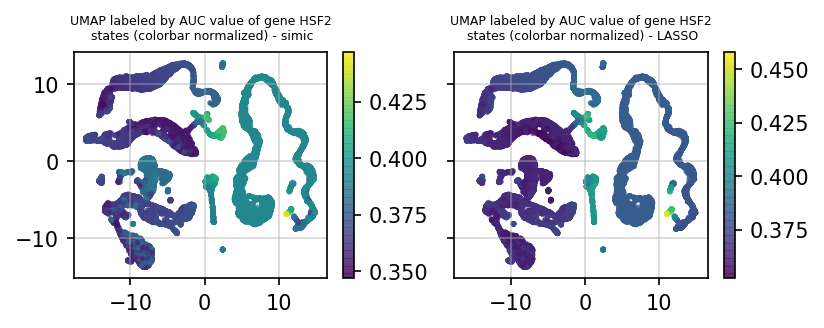

-------
ARID5B


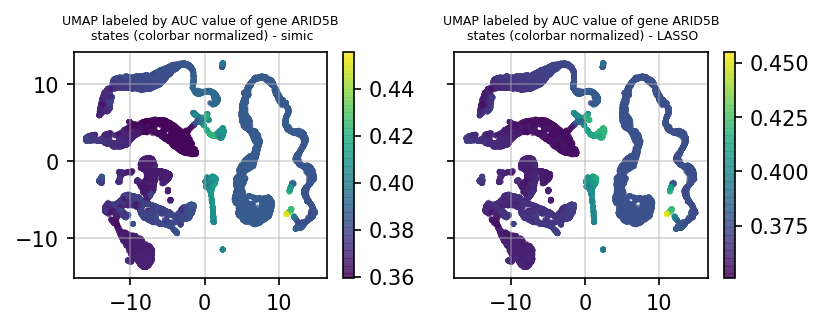

-------
TFAM


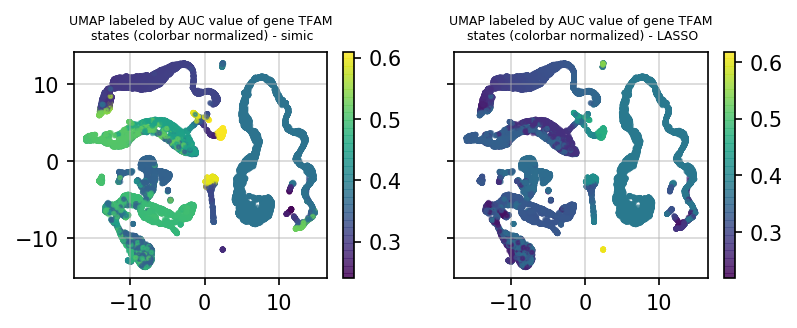

-------
CREB3L3


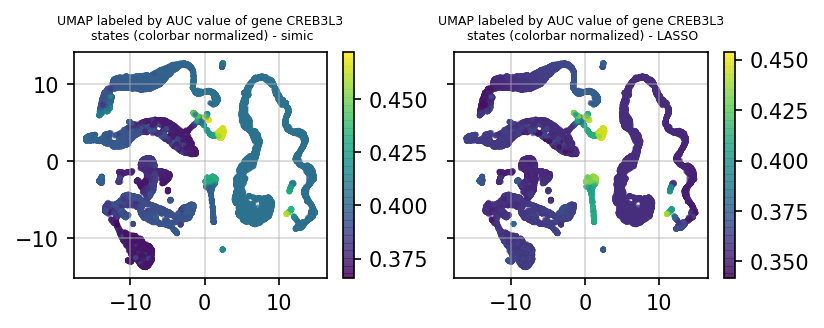

-------
ZBTB7A


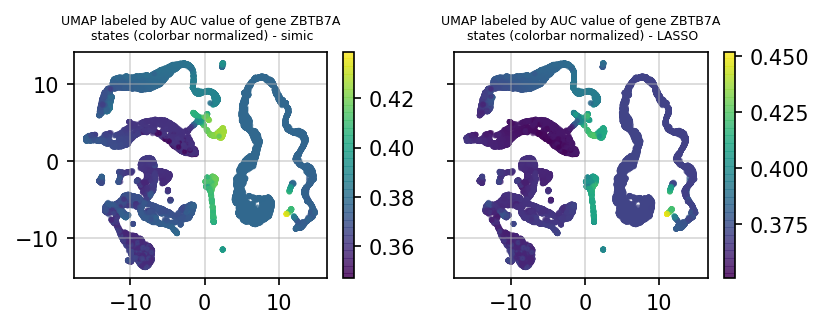

-------
HMG20B


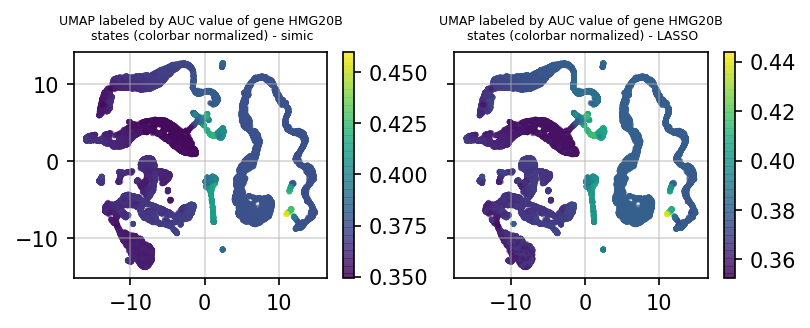

-------
NFIC


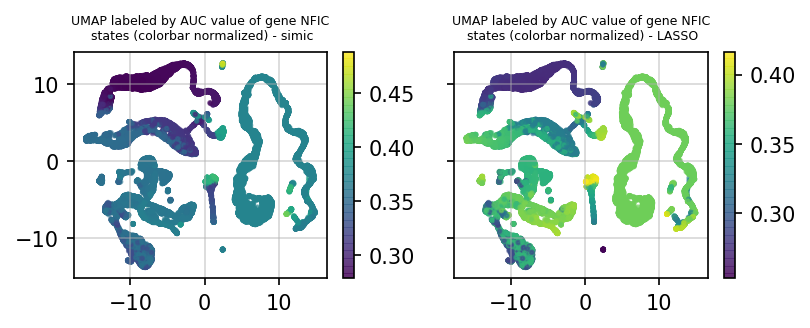

-------
NFYB


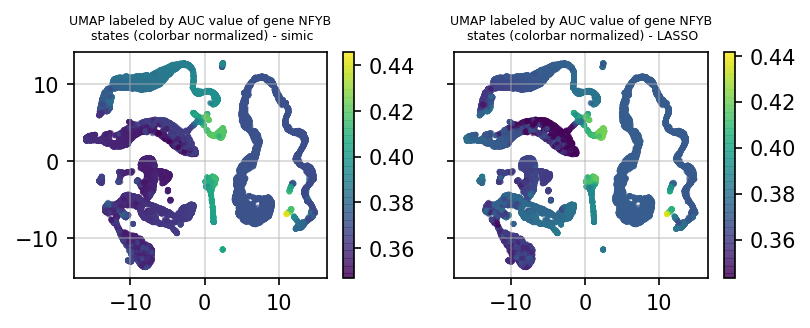

-------
NR1H4


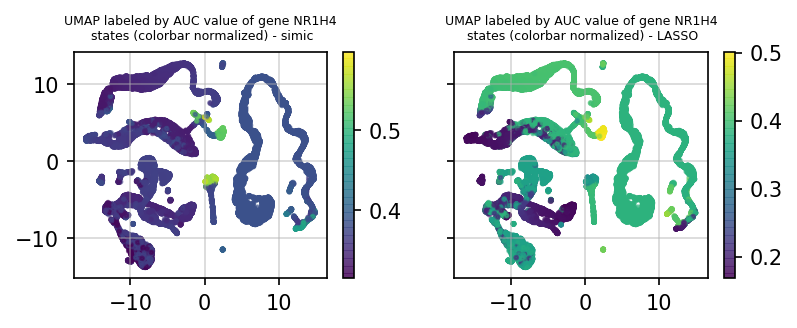

-------
THAP2


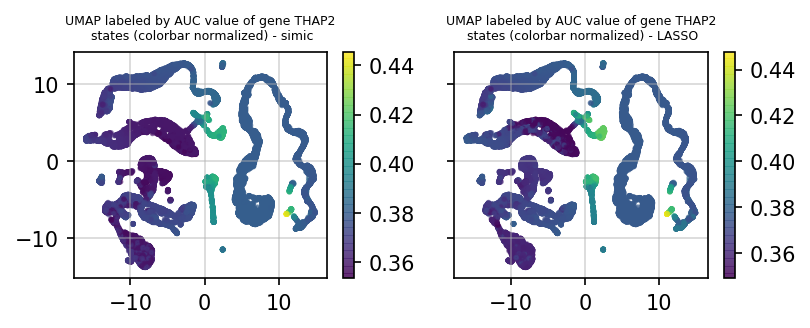

-------
STAT6


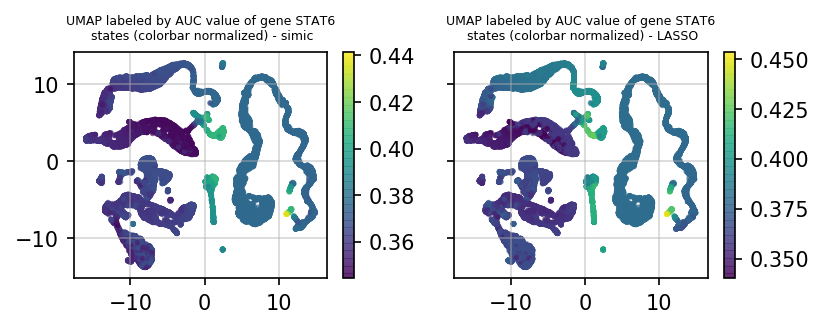

-------
STAT2


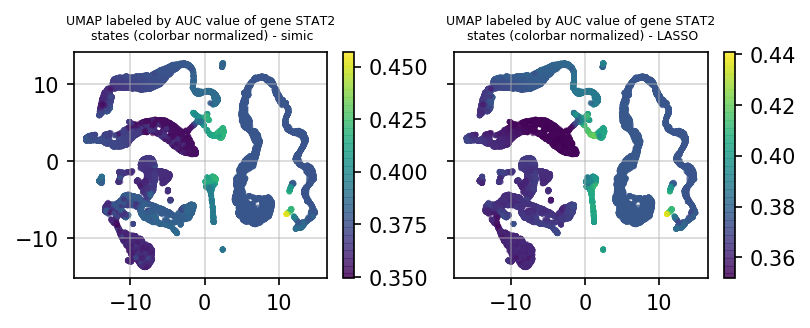

-------
SMARCC2


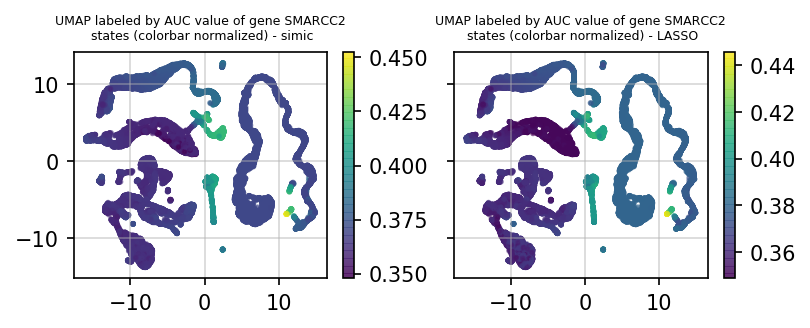

-------
TFDP1


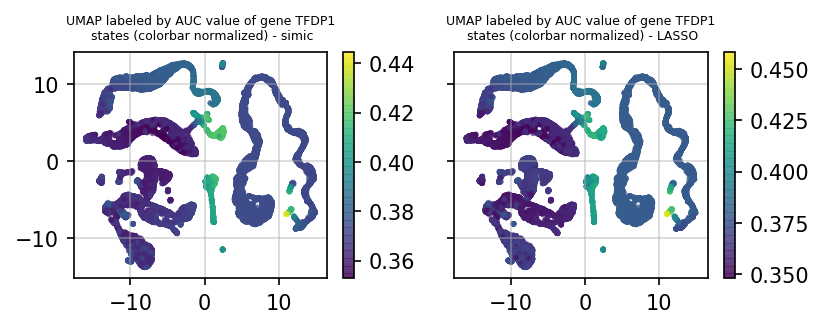

-------
IRF2


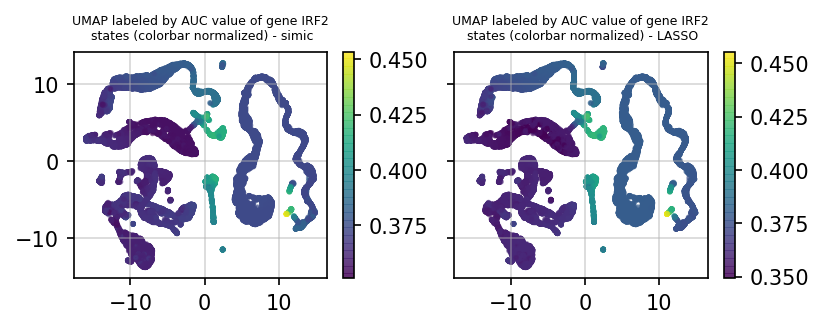

-------
GATAD2A


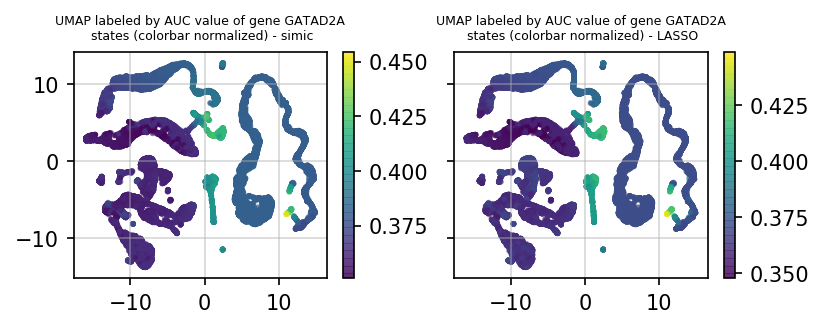

-------
JUND


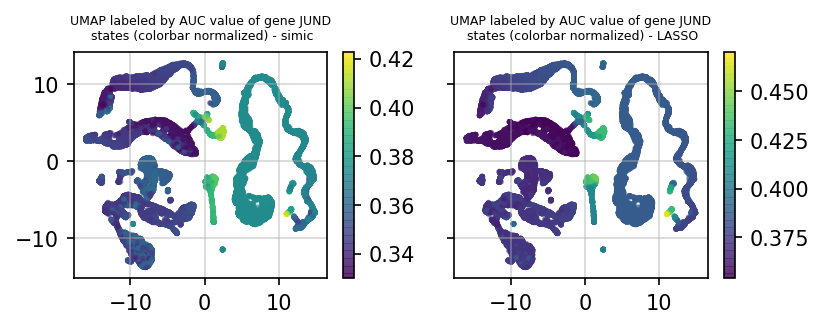

-------
NR2F6


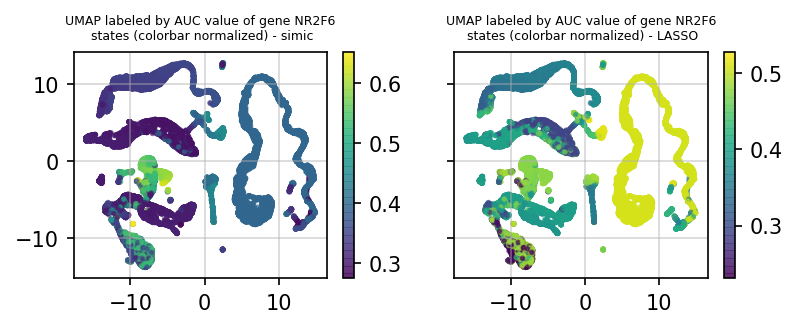

-------
SMAD1


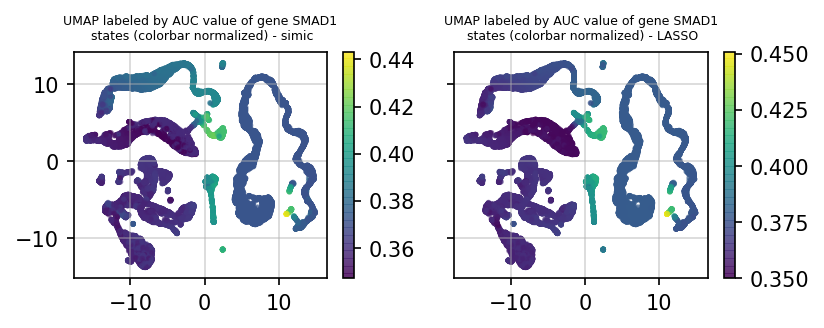

-------
SMARCA5


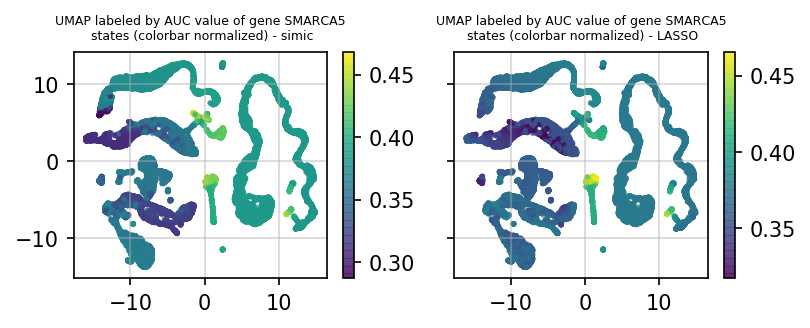

-------
NFIX


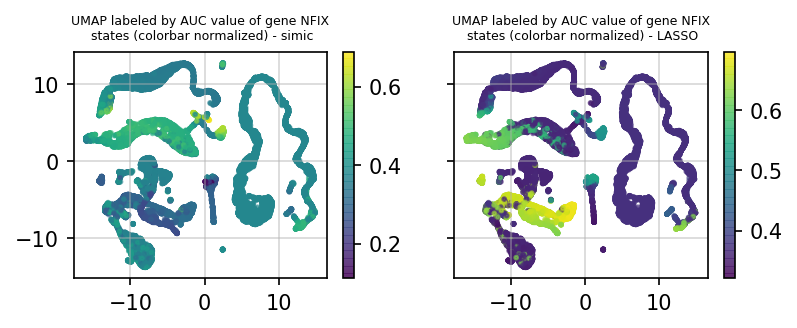

-------
JUNB


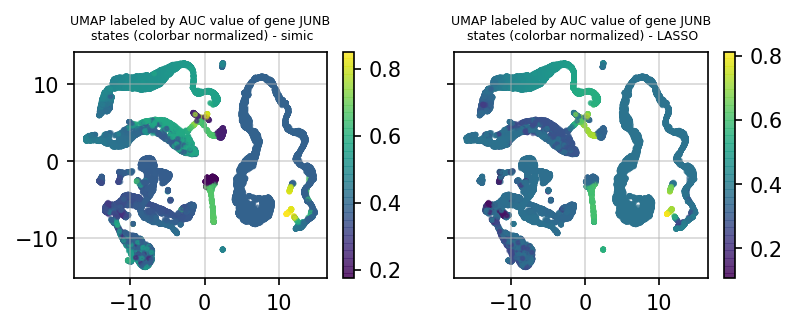

-------
SALL1


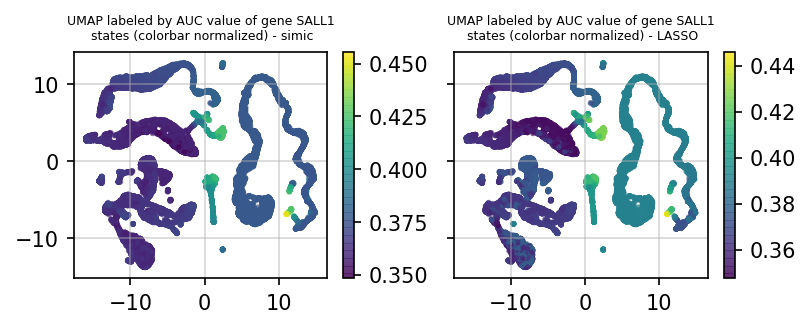

-------
CTCF


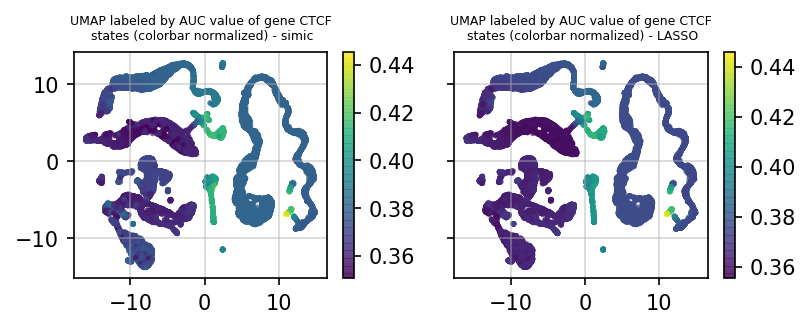

-------
NFATC3


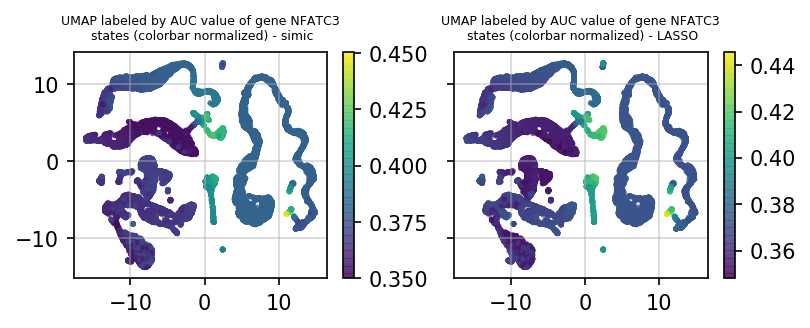

-------
ZFHX3


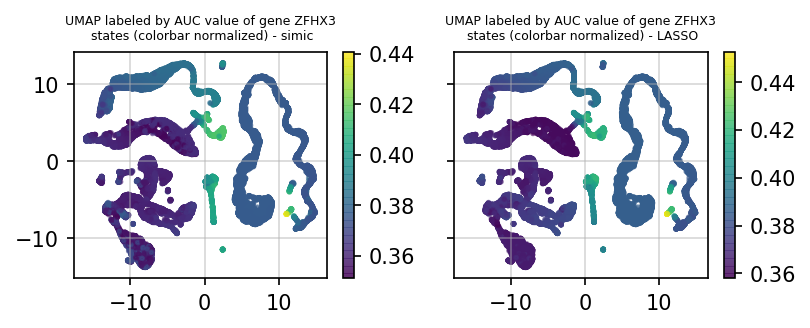

-------
MAF


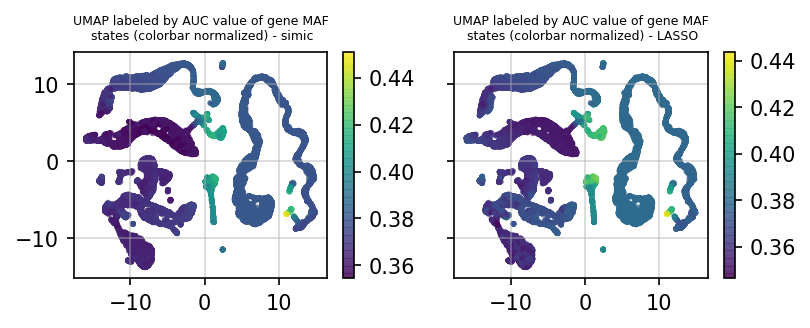

-------
ZFPM1


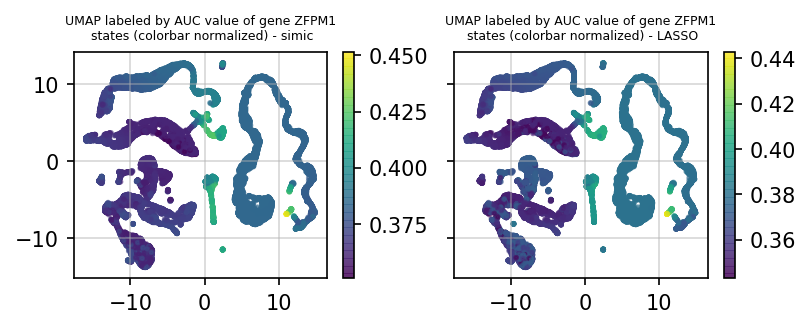

-------
TCF25


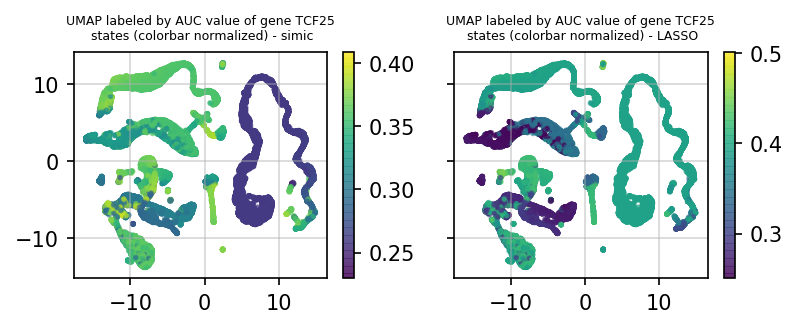

-------
THRB


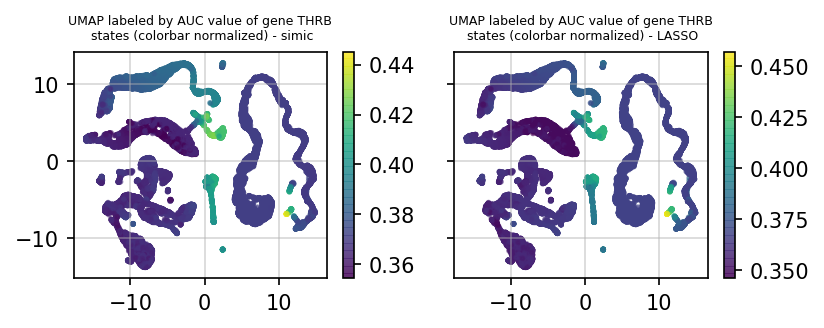

-------
NR1D2


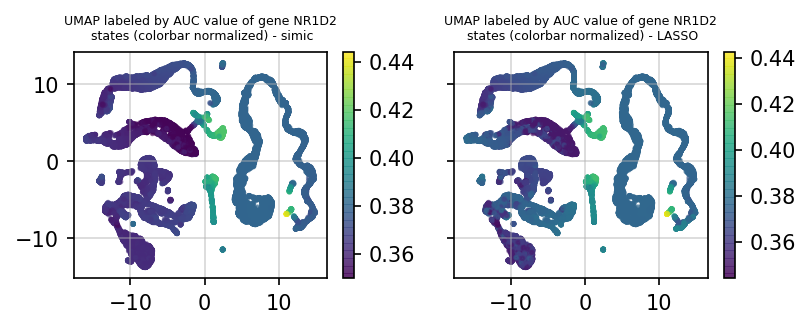

-------
PBRM1


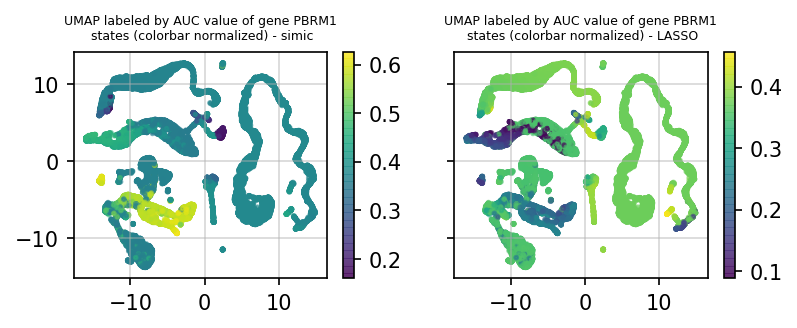

-------
TOX4


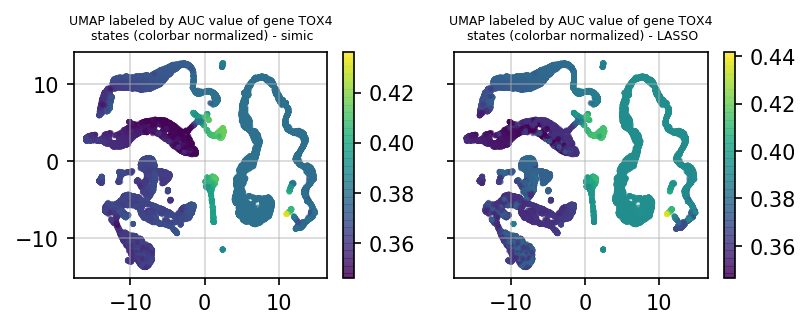

-------
IRF9


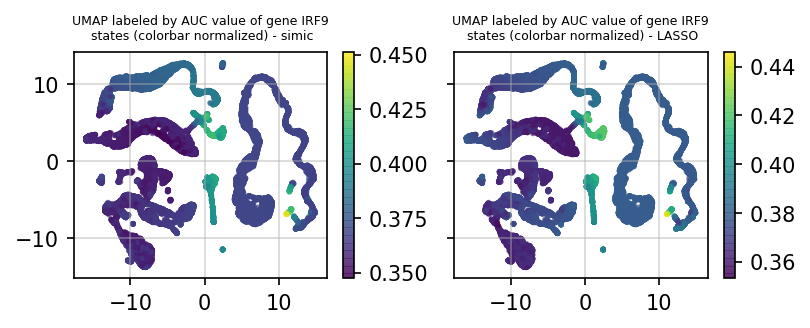

-------
TSC22D1


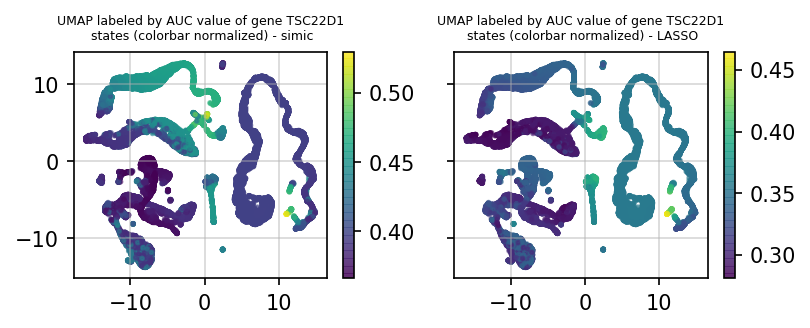

-------
ELF1


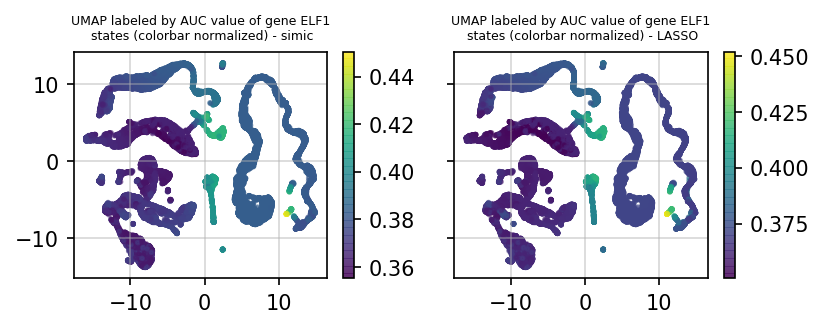

-------
KLF12


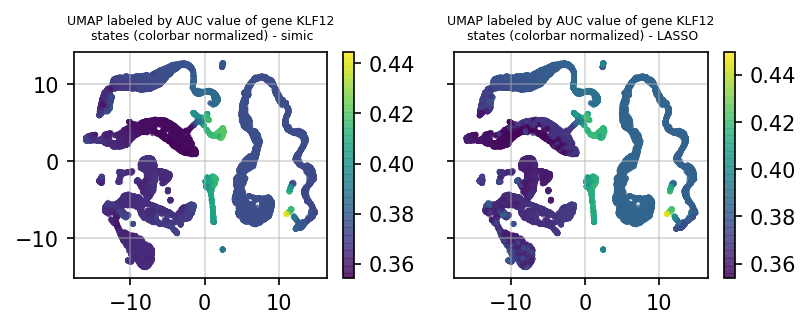

-------
DNMT1


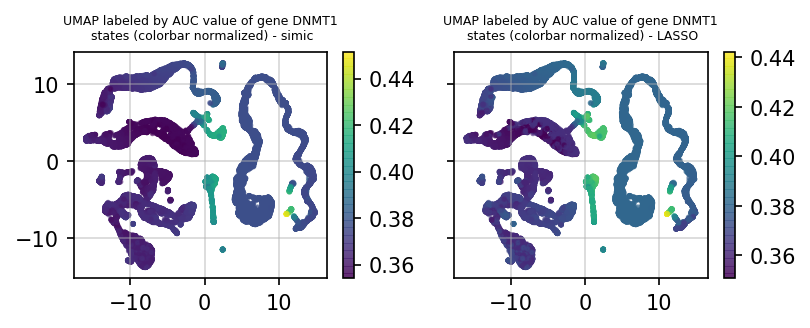

-------
ZBTB44


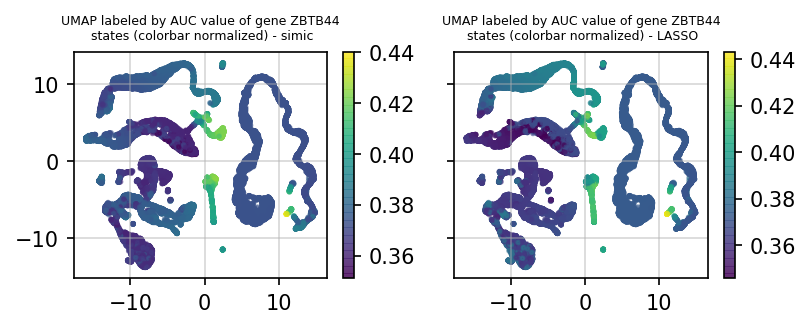

-------
RORA


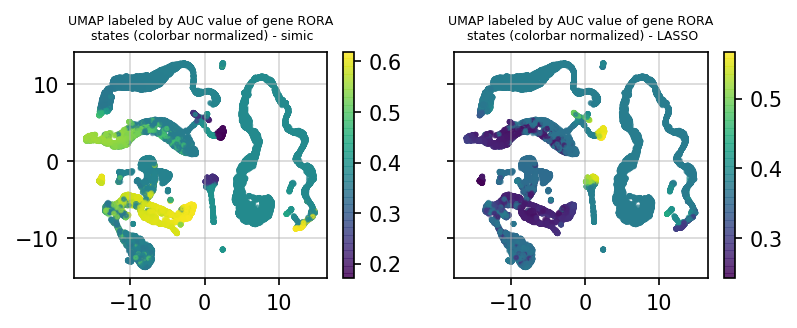

-------
ONECUT1


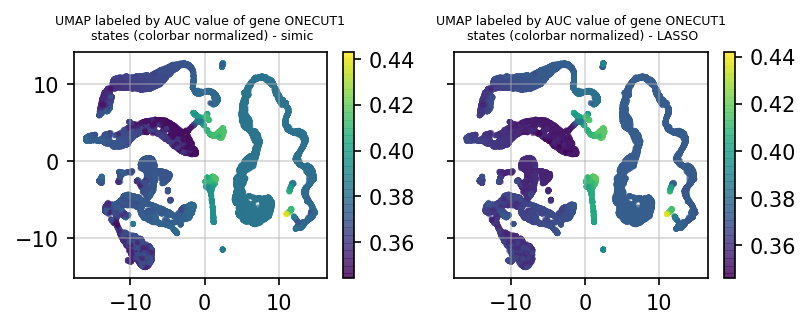

-------
TFDP2


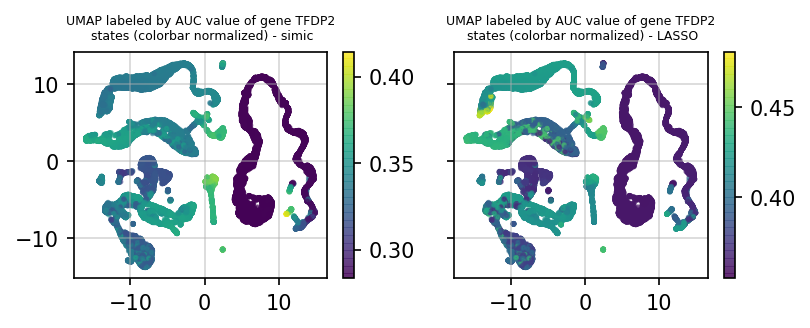

-------
ZBTB38


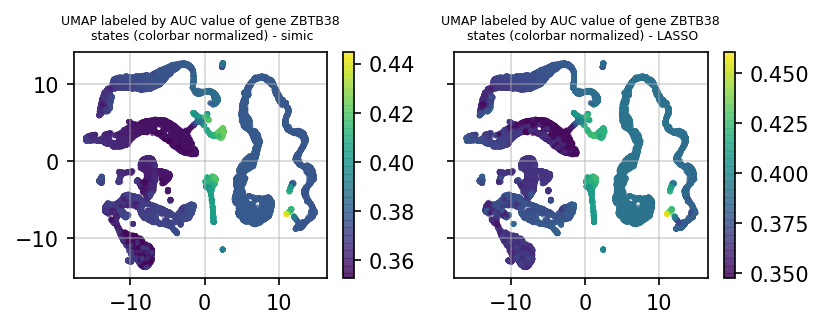

-------
SMARCC1


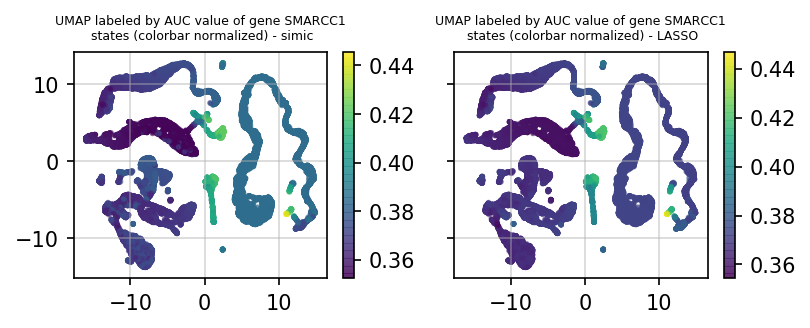

-------
LRRFIP2


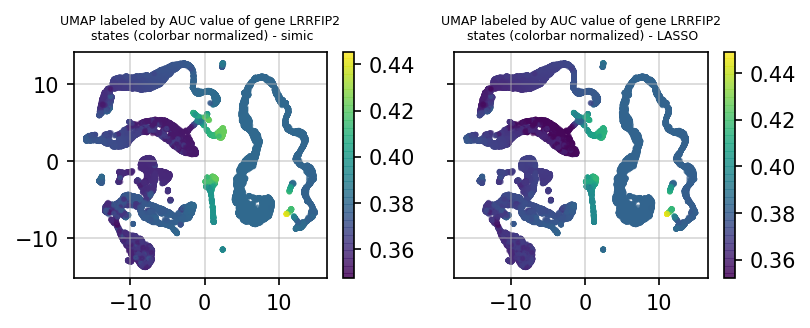

-------
UBP1


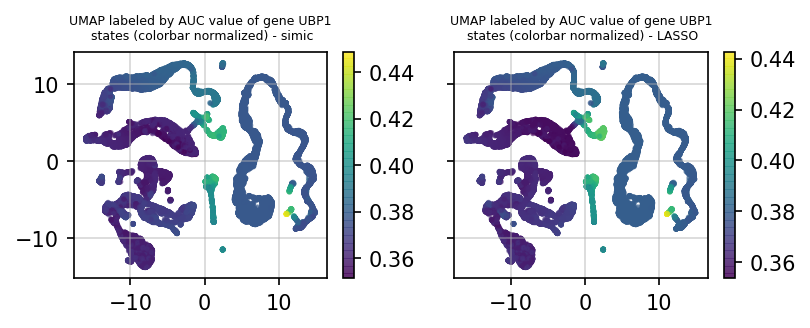

-------
CSRNP1


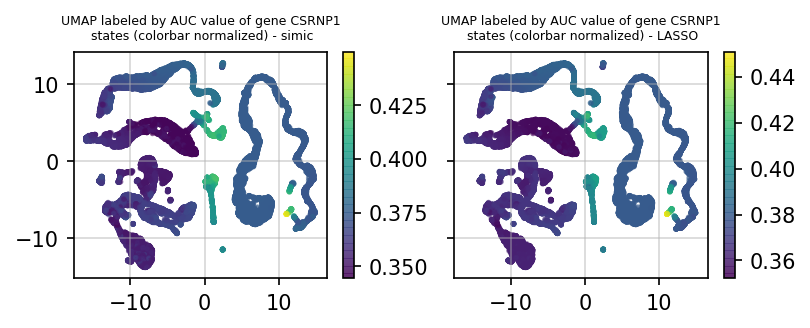

-------
XBP1


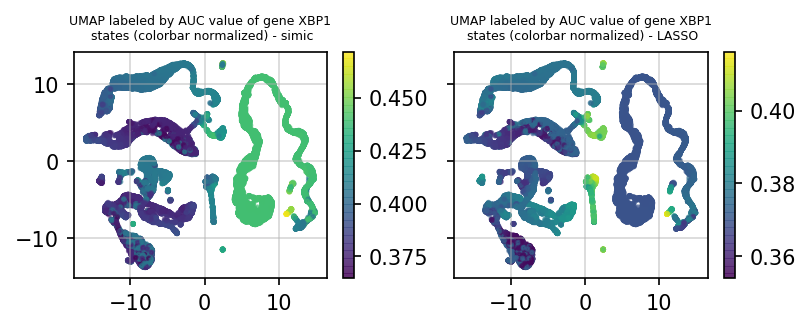

-------
PURB


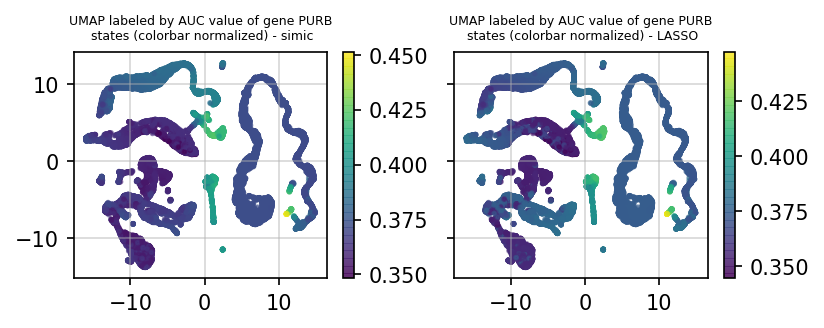

-------
SREBF1


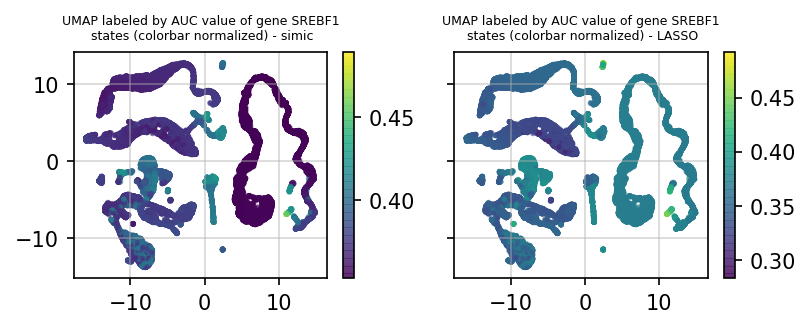

-------
NCOR1


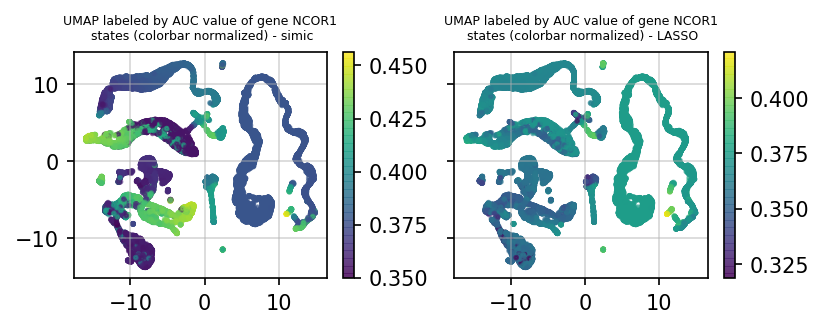

-------
HLF


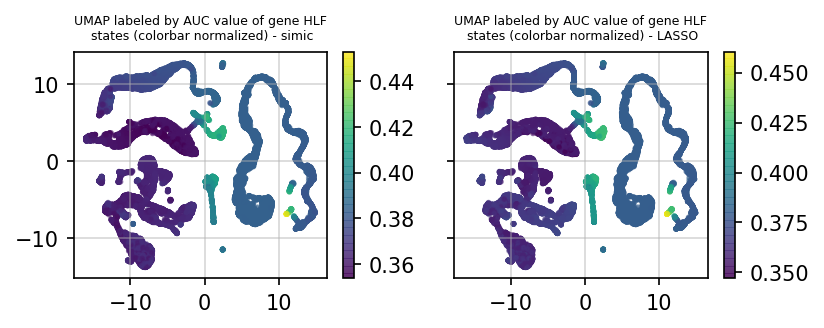

-------
NFE2L1


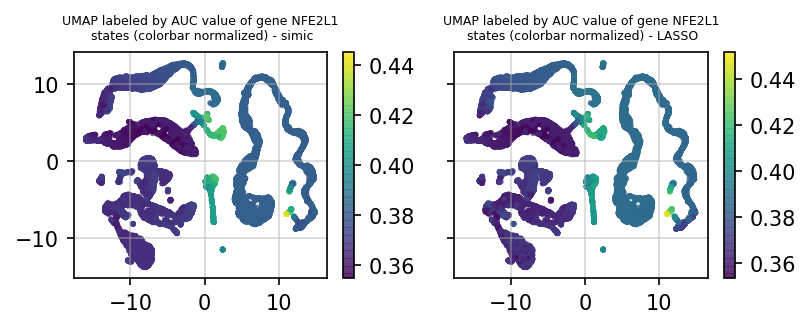

-------
NR1D1


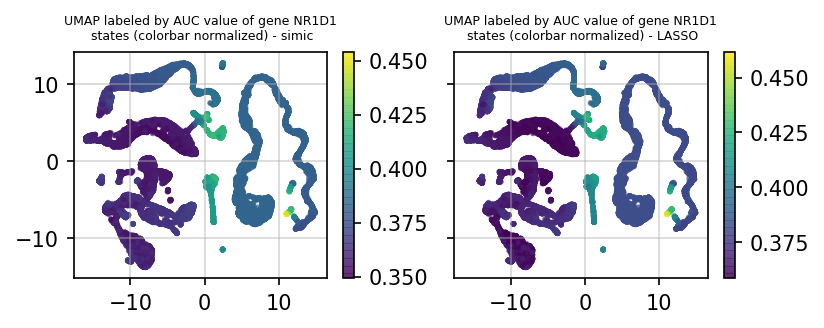

-------
RARA


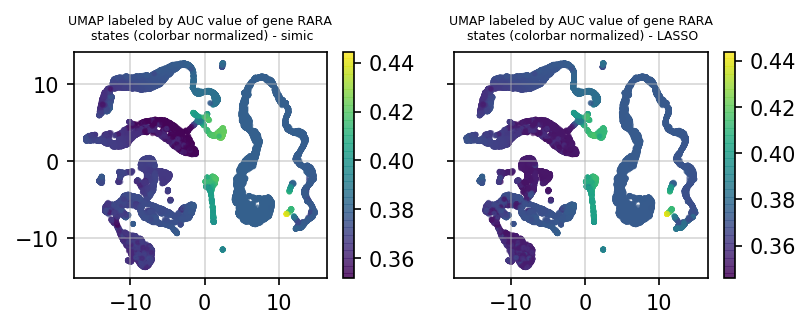

-------
SMARCE1


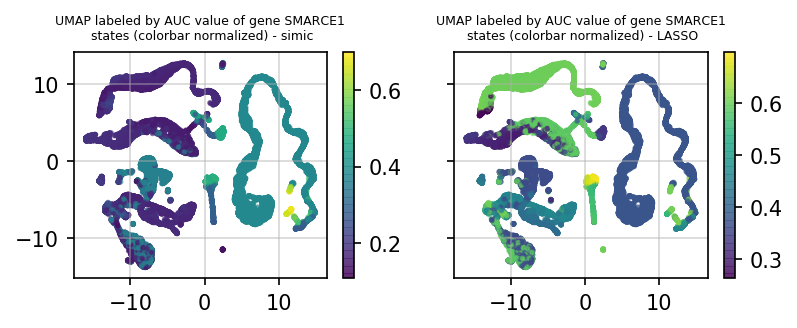

-------
STAT5B


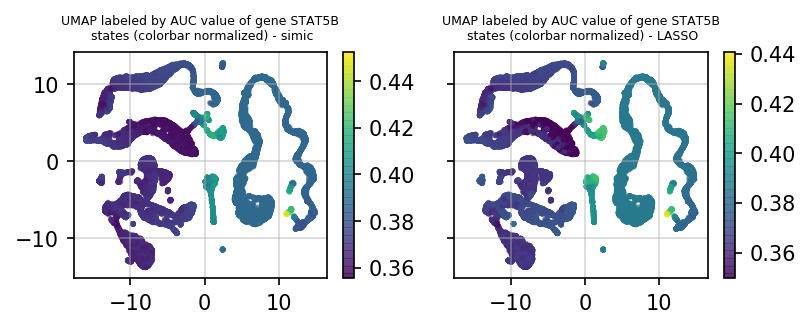

-------
STAT3


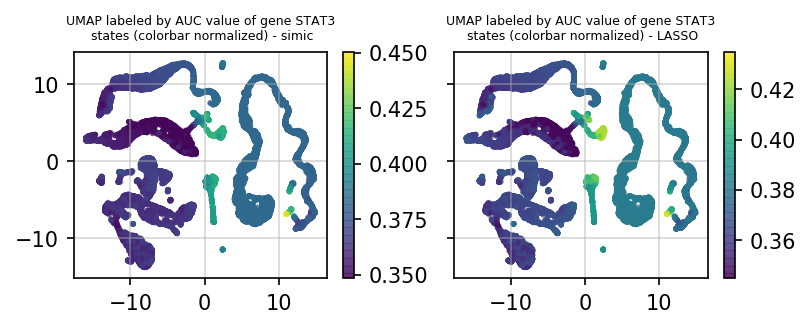

-------
MLX


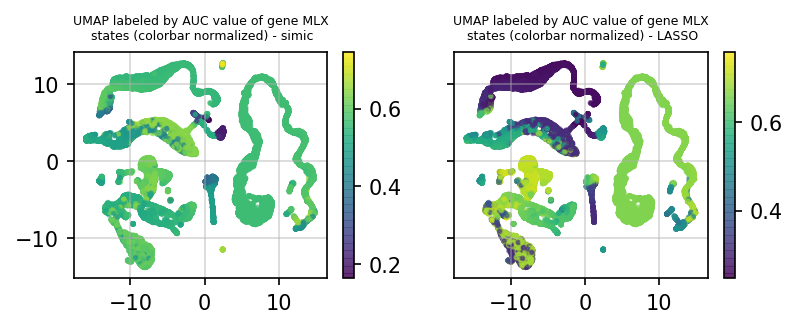

-------
UBTF


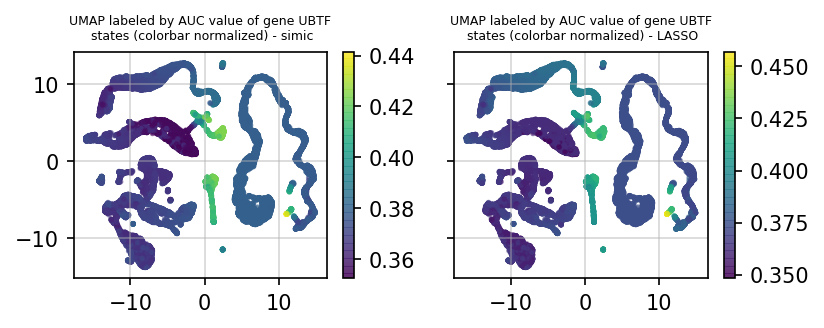

-------
SOX9


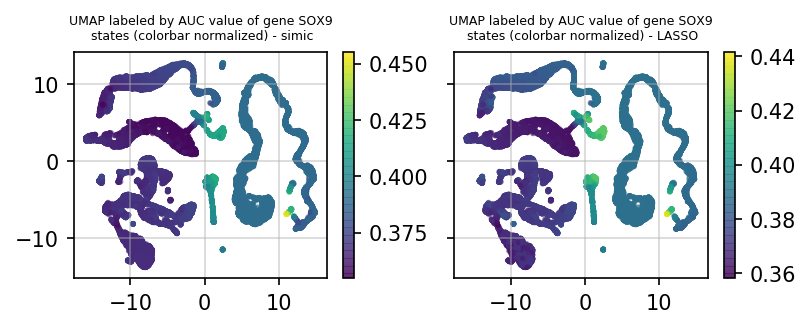

-------
MAFG


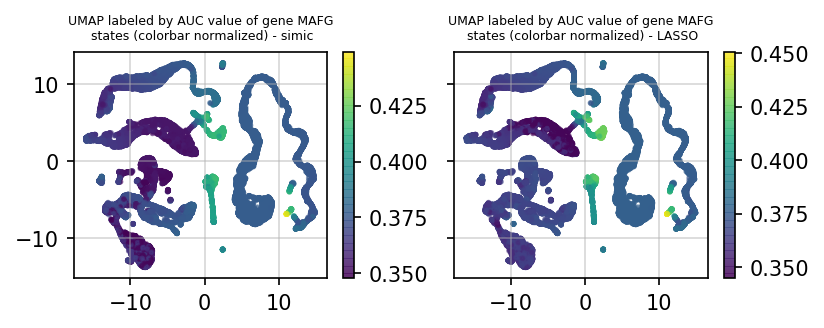

-------
ARID4B


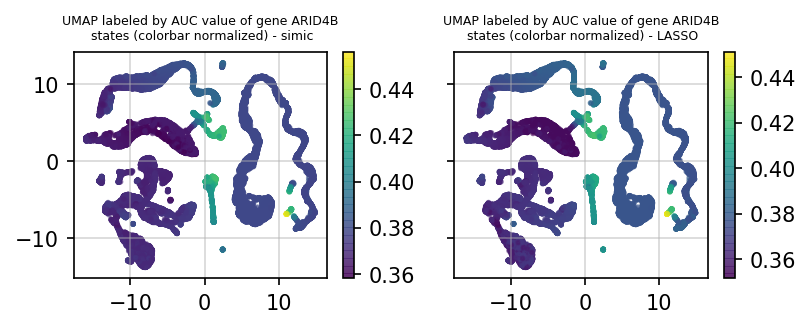

-------
ZKSCAN3


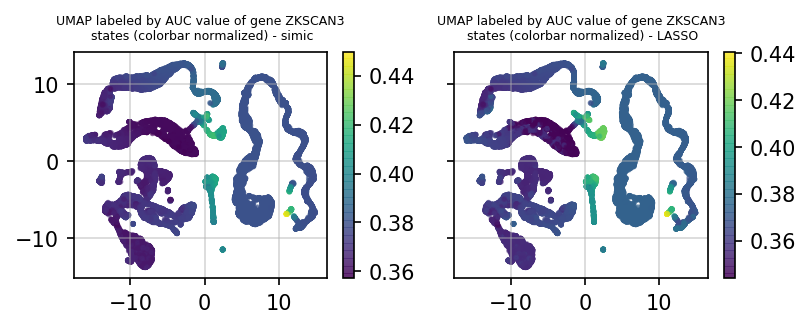

-------
FOXQ1


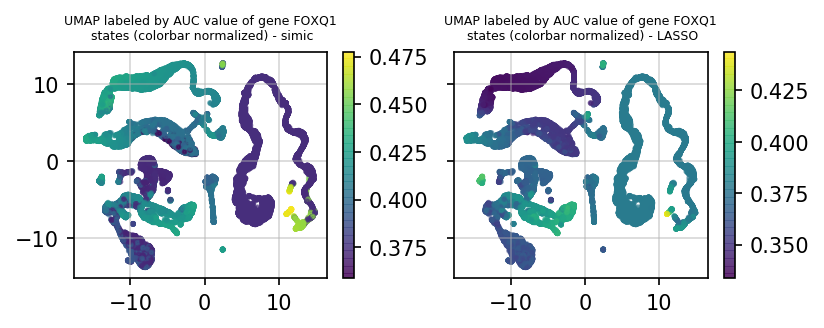

-------
RREB1


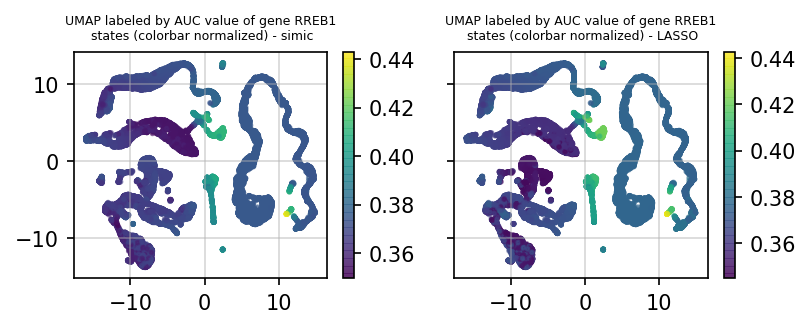

-------
MIER3


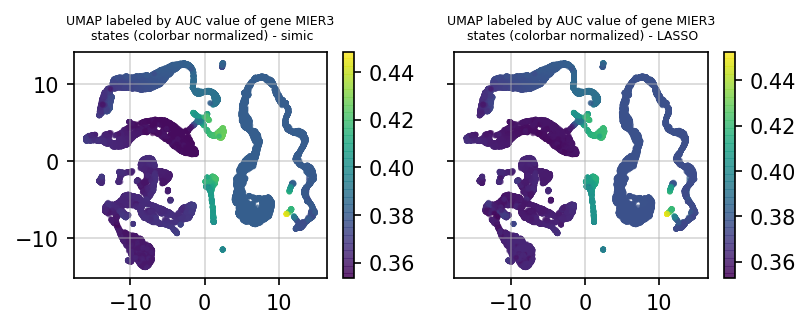

-------
ID2


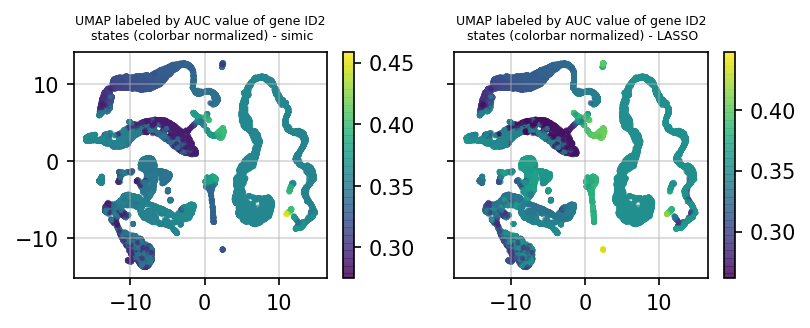

-------
HBP1


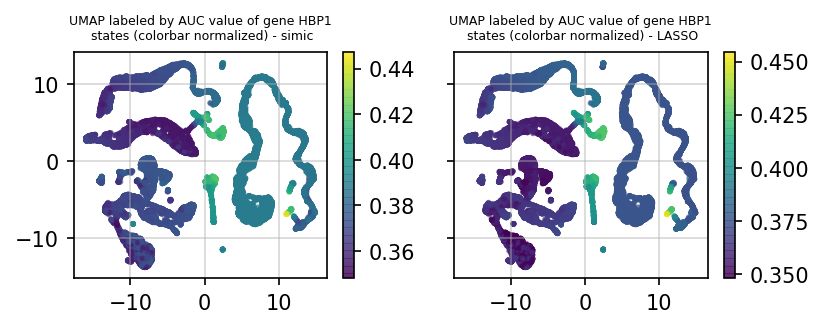

-------
AHR


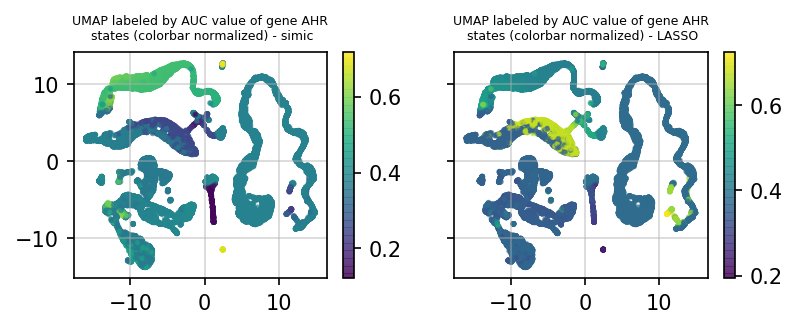

-------
NFKBIA


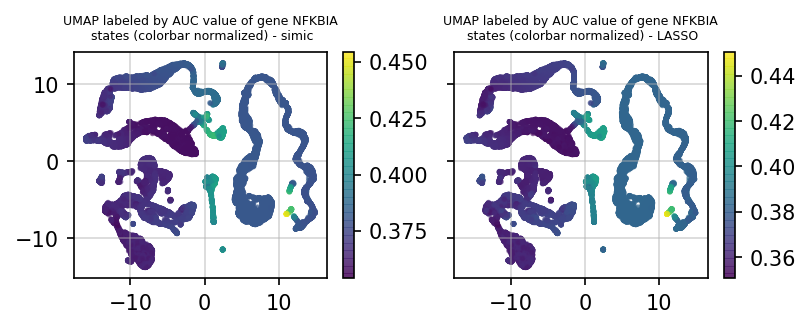

-------
FOXA1


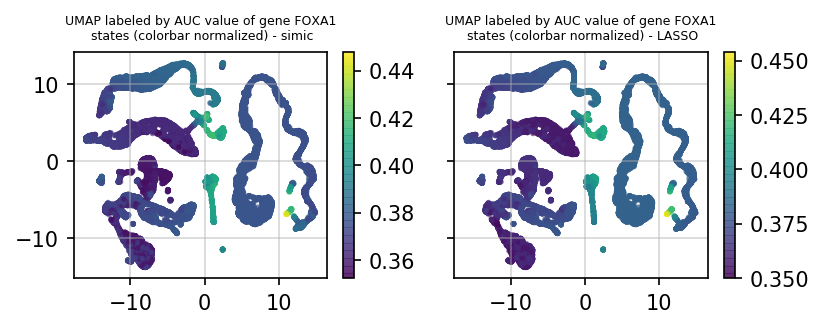

-------
HIF1A


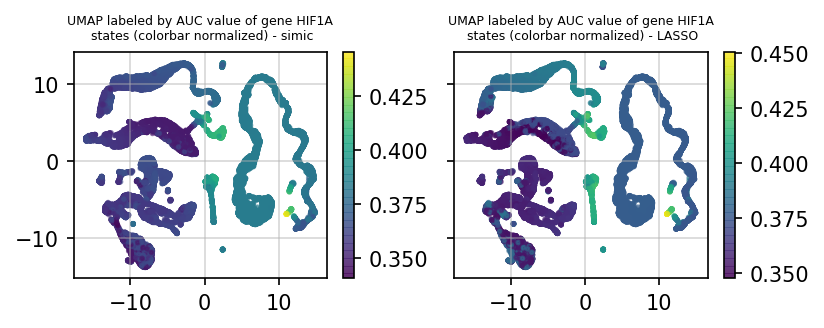

-------
FOXN3


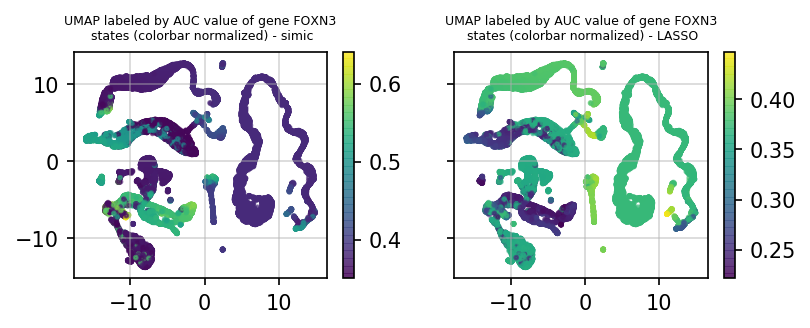

-------
YY1


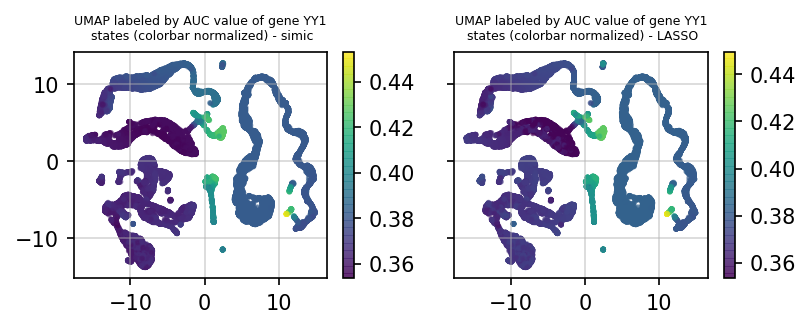

-------
RCOR1


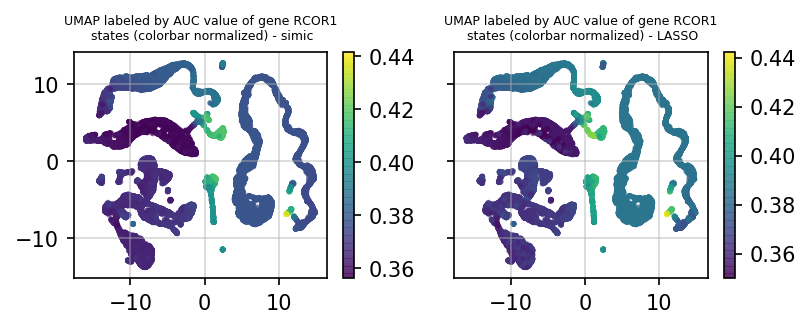

-------
KLF10


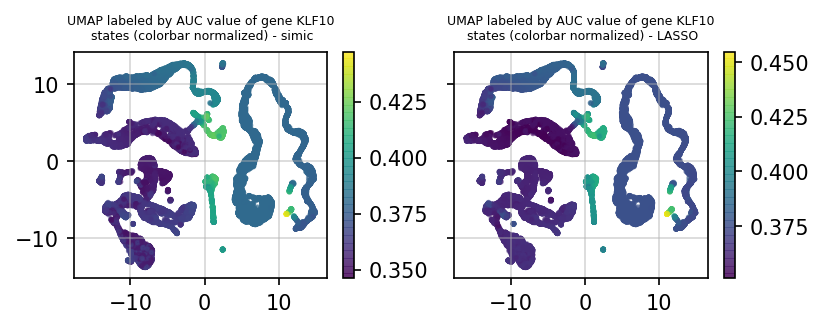

-------
ZHX1


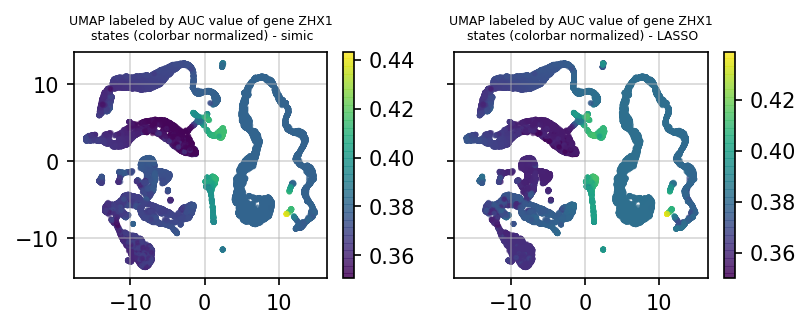

-------
ATF4


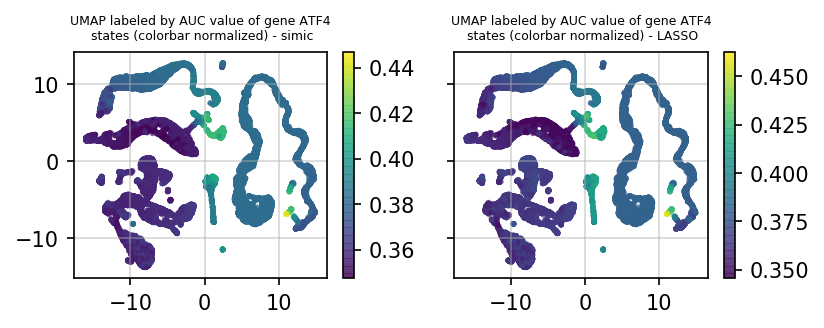

-------
TEF


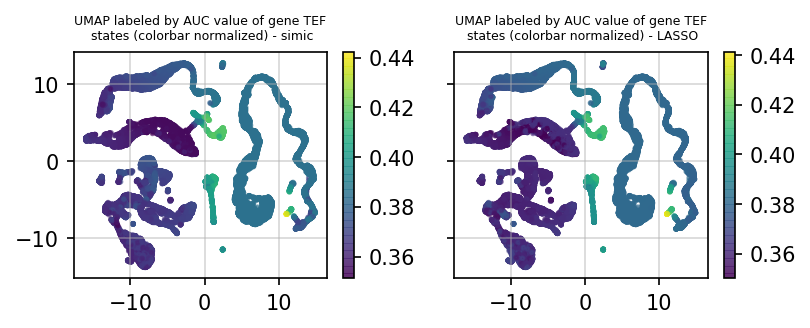

-------
PHF5A


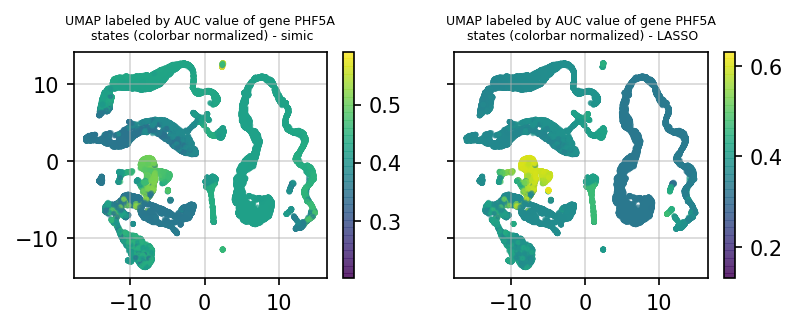

-------
SREBF2


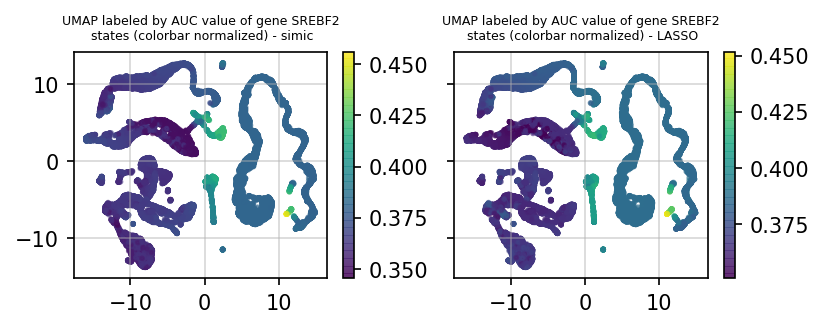

-------
PPARA


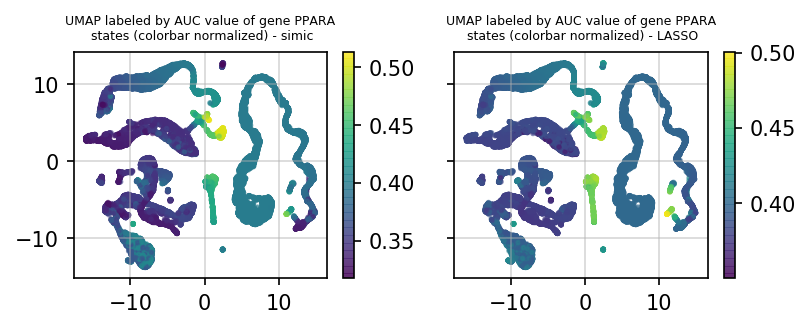

-------
ATF1


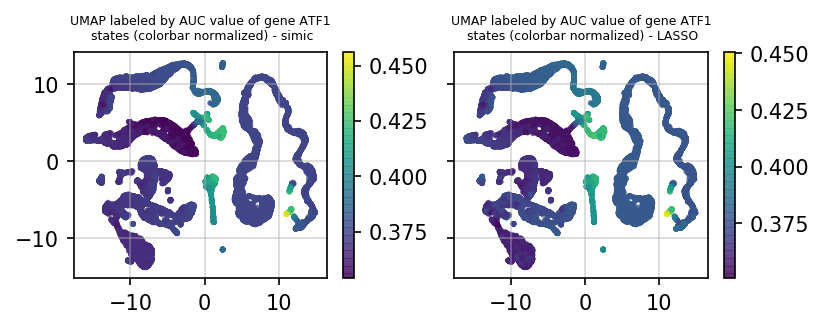

-------
SP1


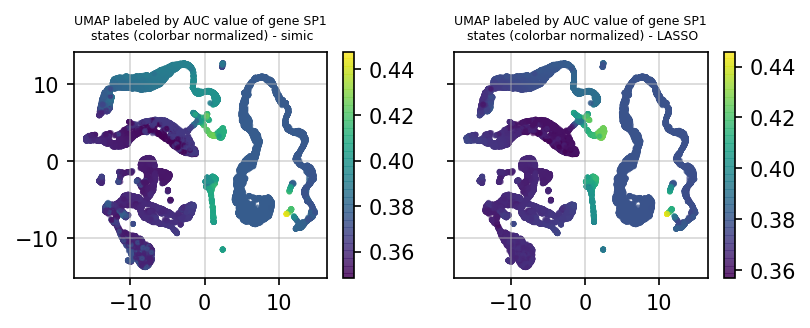

-------
CEBPD


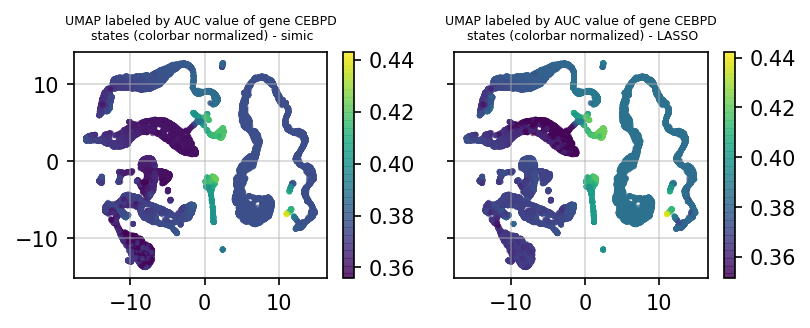

-------
BCL6


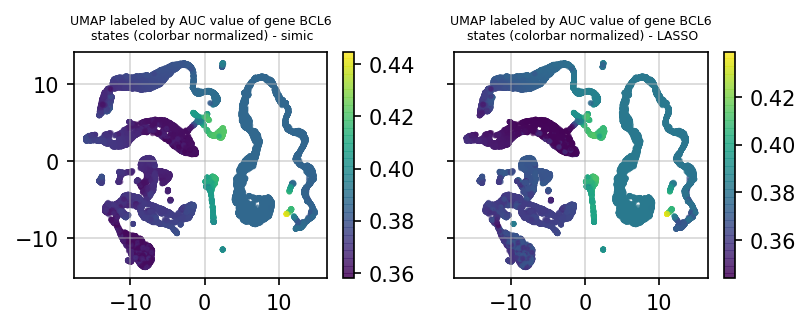

-------
HES1


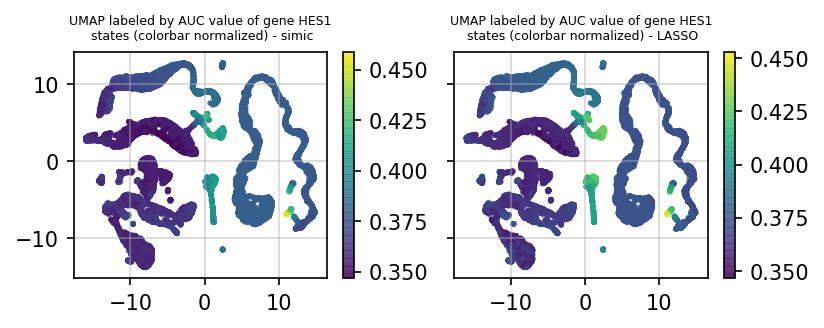

-------
NR1I2


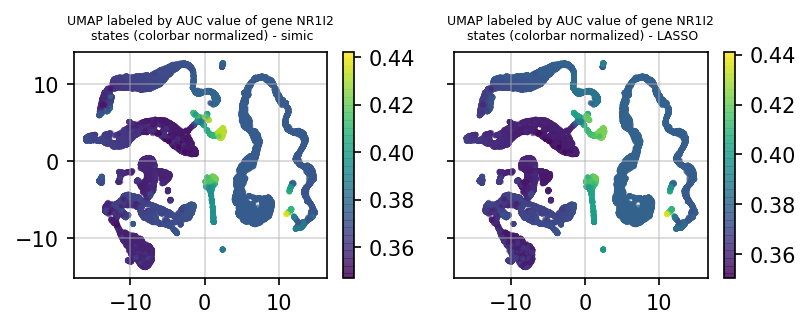

-------
ZBTB20


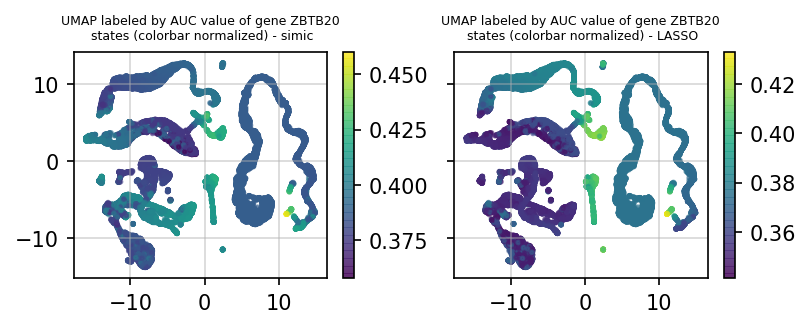

-------
GABPA


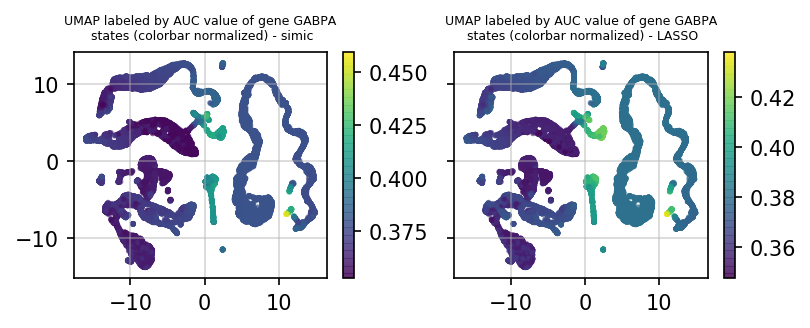

-------
BACH1


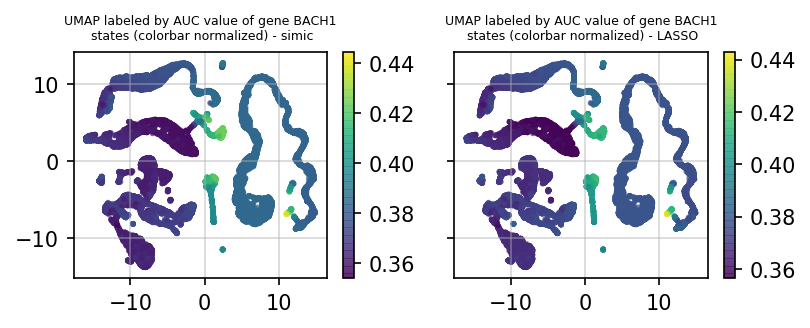

-------
ETS2


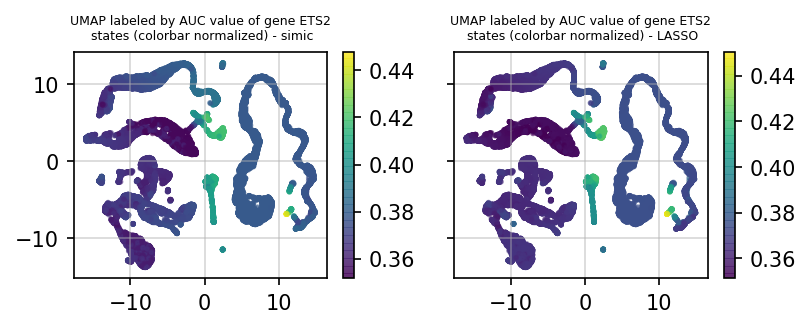

-------
CDC5L


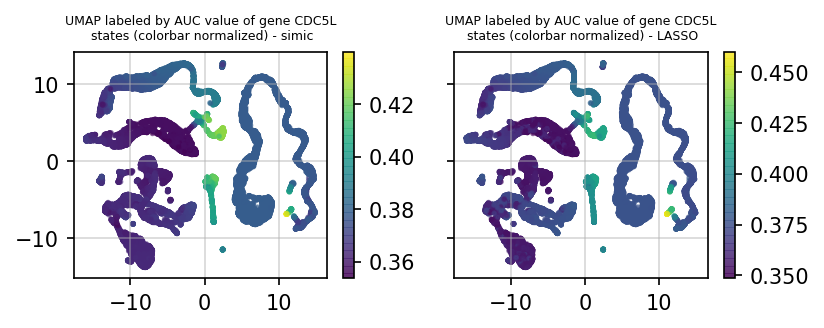

-------
EPAS1


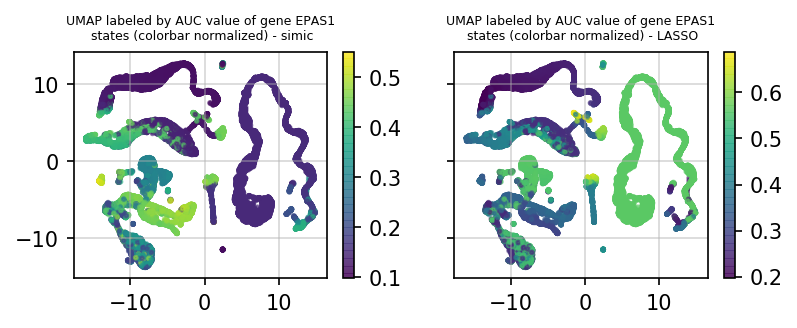

-------
CREM


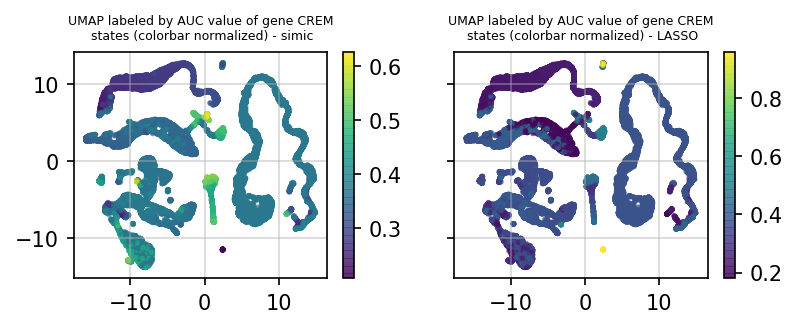

-------
EGR1


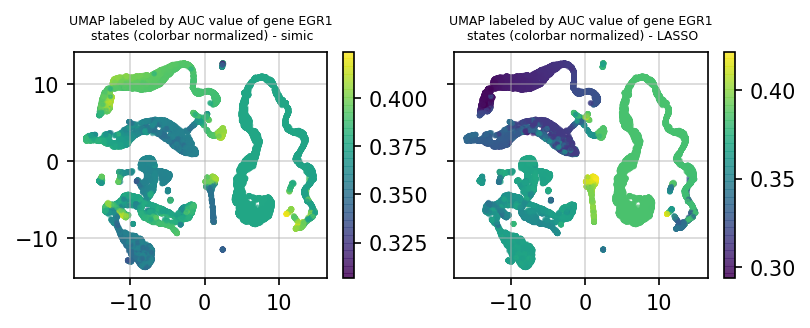

-------
PURA


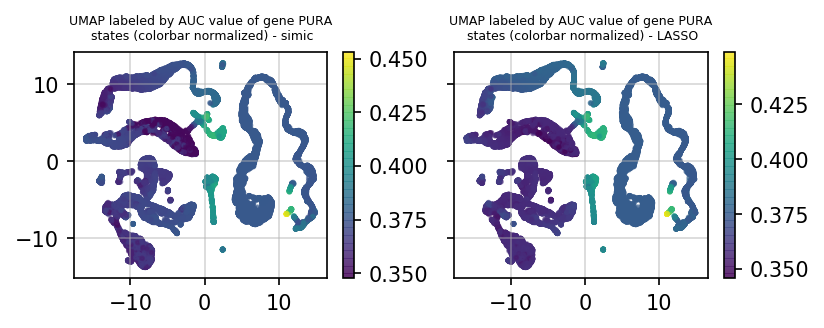

-------
NR3C1


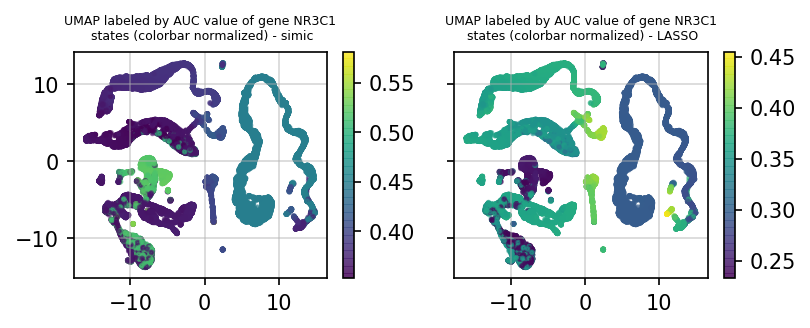

-------
ONECUT2


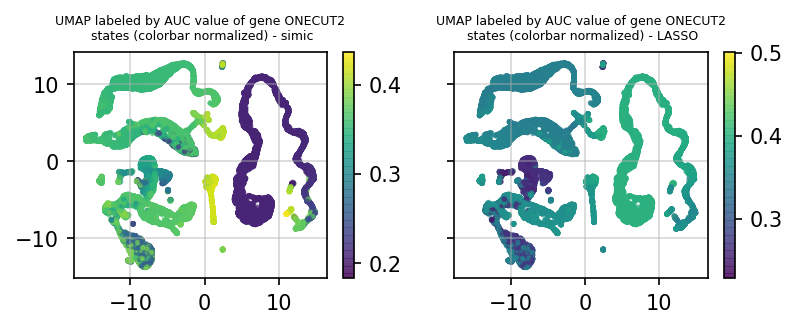

-------
SMAD4


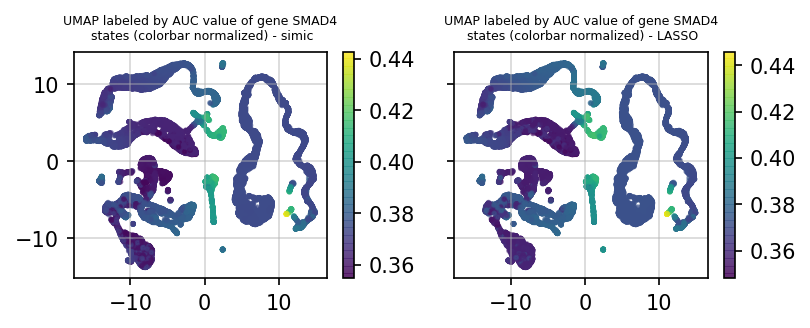

-------
CXXC1


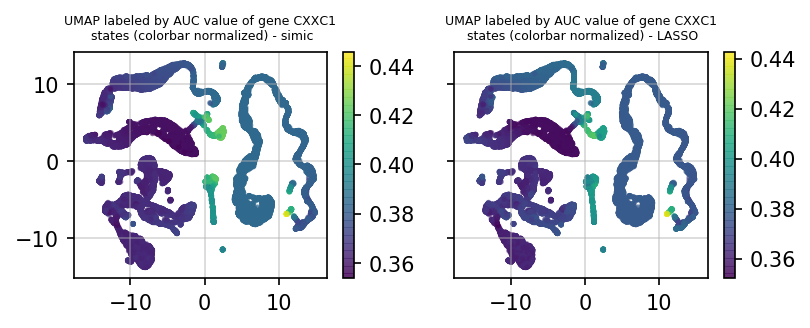

-------
MBD1


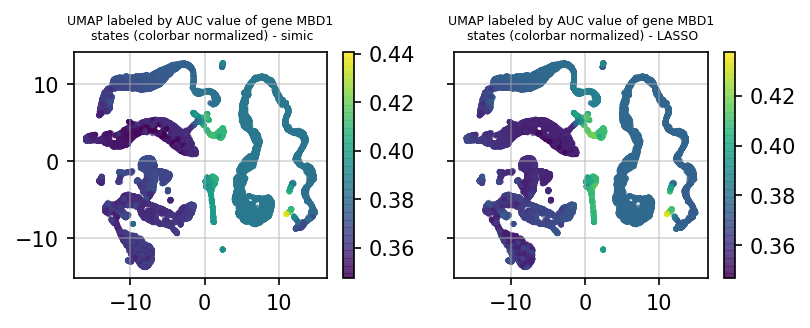

-------
TSHZ1


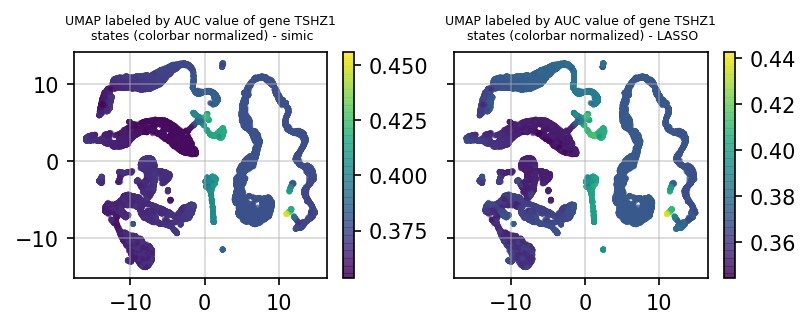

-------
KDM2A


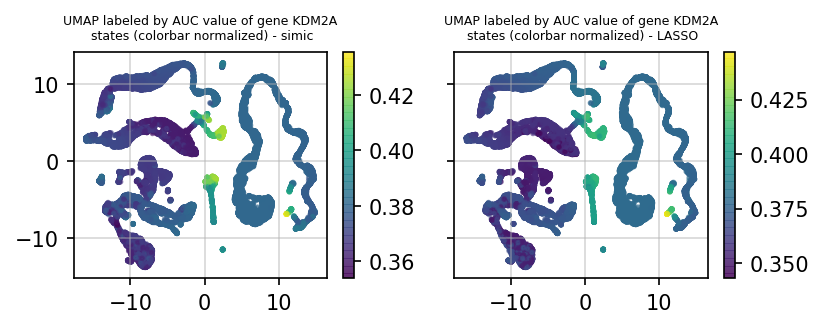

-------
RELA


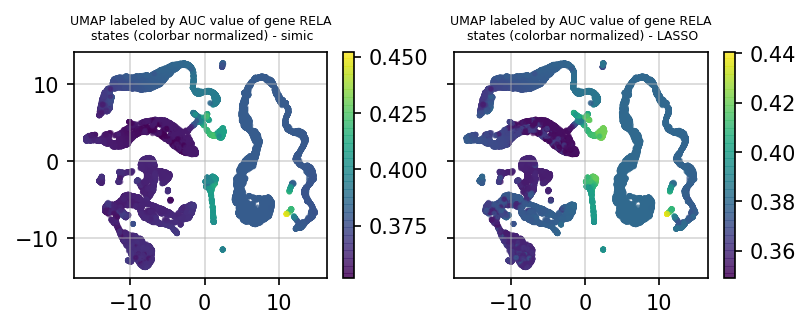

-------
ZFP91


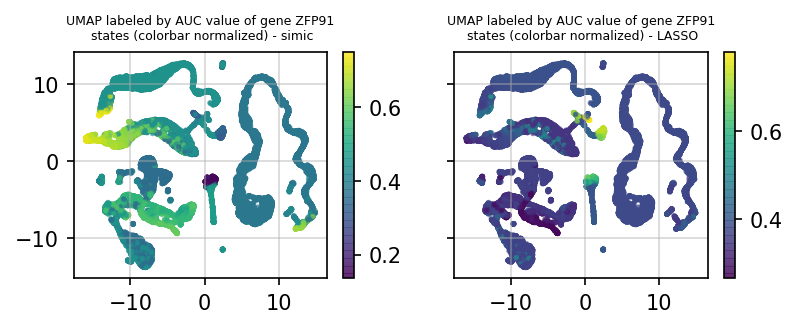

-------
KLF9


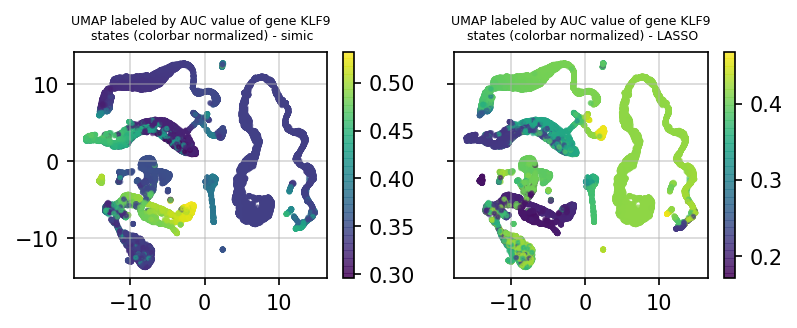

-------
HHEX


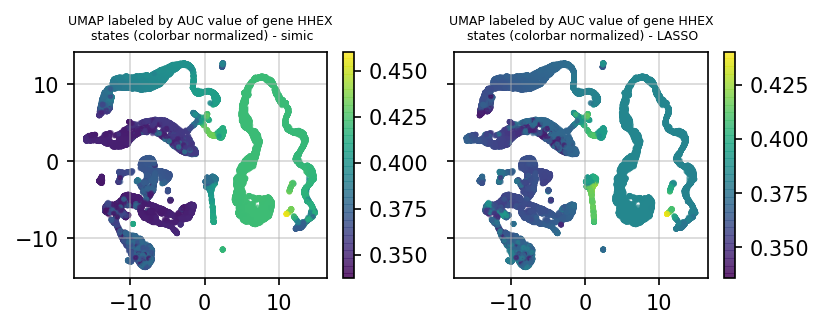

-------
MXI1


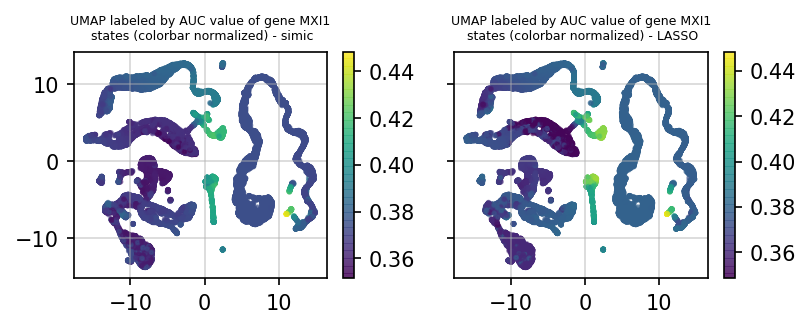

-------
TCF7L2


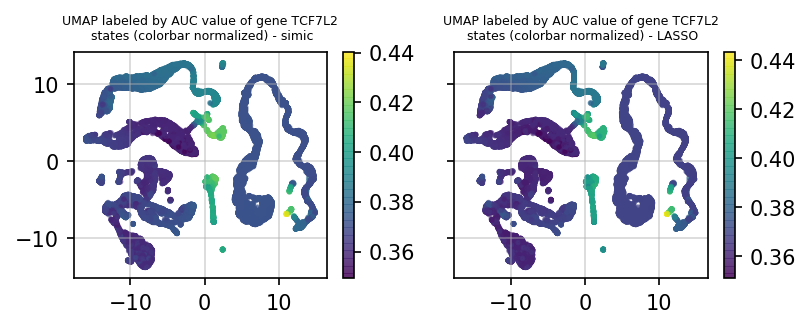

In [100]:
for gene in TF_hist_dict_simic:
    intersect_vs_all(embedding, df, assign_list, AUC_dict_simic, AUC_dict_no_simic, gene.upper(), cmap_name = 'viridis')
    

-------
ID3


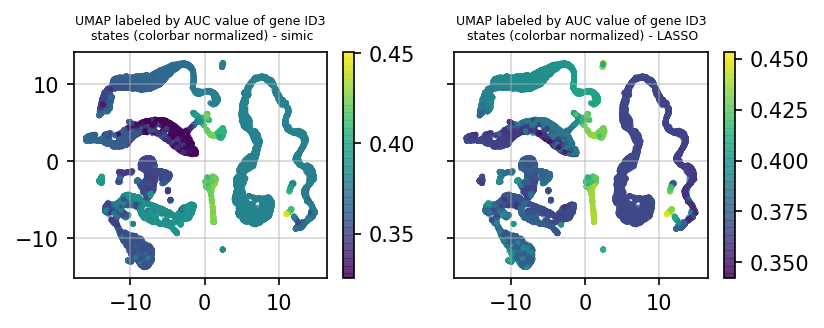

-------
NCOR1


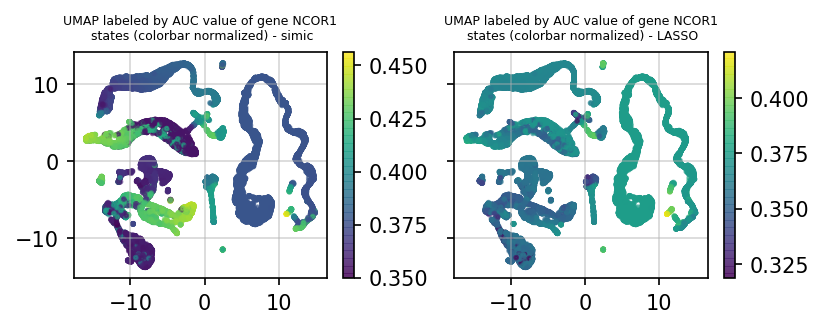

-------
YBX1


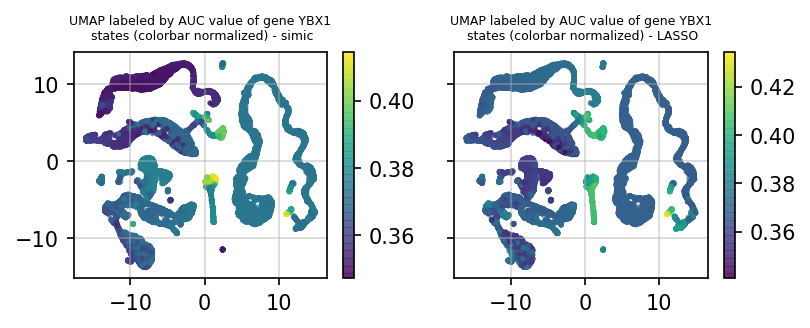

-------
JUND


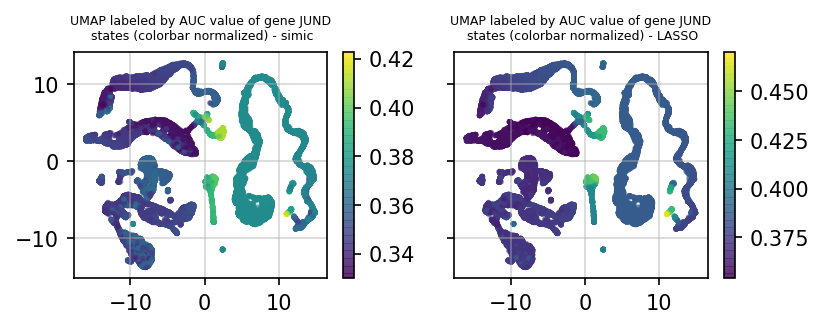

-------
NR0B2


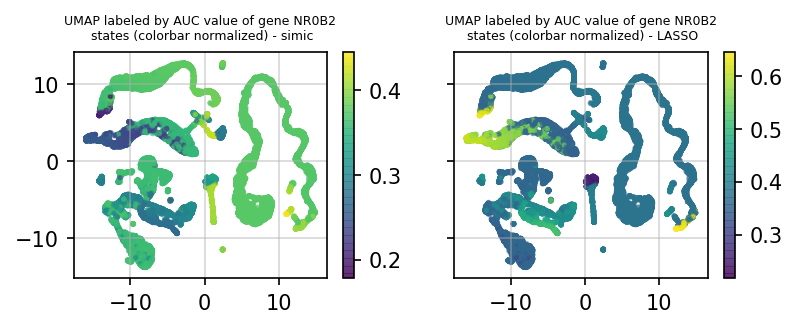

In [99]:
for gene in ['ID3', 'NCOR1', 'YBX1', 'JUND', 'NR0B2']:
    intersect_vs_all(embedding, df, assign_list, AUC_dict_simic, AUC_dict_no_simic, gene.upper(), cmap_name = 'viridis')